In [1]:
%matplotlib inline
%reload_ext autoreload
%autoreload 2
from PyCUB import pyCUB 

In [3]:
cub = pyCUB.PyCUB(session = 'ensembl2')
cub.load(session = 'ensembl2',filename = "before_workinghomo_aug")

working on session: ensembl2
you already have a session here (just a warning)
loading from before_workinghomo_aug
it worked !
you now have 1730558 genes in total


{}

what is this thing? again ? we have another shape meaning that the particular distribution is not the same within highly shared homologies? Else it may very well be that the hyperparameters have changed the distribution. it is the case when we put back the original values from the all_homoset tSNE. Meaning that there is no latent process driving the distribution in the highly shared homologies.

One can see such plot as a visual representation of non linear correlation amongst the variables. Here whatever is the values and even while changing the data, we can see that there is 4 axis correlated to their center in some ways. what drives it is unknown and should be explored further.


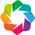

please write %output size=200" before calling this function


:Layout
   .Image.I                           :Image   [x,y]   (z)
   .DynamicMap.All_1585546_homologies :DynamicMap   []
      :RGB   [x,y]   (R,G,B,A)

In [78]:
cub.working_homoset.plot_all(With='tsne',perplexity=100, interactive=True, iteration=500,
                         bins=400,offset=10,redo=True, bypasstsne=True,inpar=True)


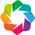

please write %output size=200" before calling this function


/home/ec2-user/miniconda2/envs/cub/lib/python2.7/site-packages/holoviews/operation/datashader.py:358: FutureWarning: xarray.DataArray.__contains__ currently checks membership in DataArray.coords, but in xarray v0.11 will change to check membership in array values.
  if 'x_axis' in agg and 'y_axis' in agg:
/home/ec2-user/miniconda2/envs/cub/lib/python2.7/site-packages/bokeh/io/saving.py:125: UserWarning: save() called but no resources were supplied and output_file(...) was never called, defaulting to resources.CDN
  warn("save() called but no resources were supplied and output_file(...) was never called, defaulting to resources.CDN")
/home/ec2-user/miniconda2/envs/cub/lib/python2.7/site-packages/bokeh/io/saving.py:138: UserWarning: save() called but no title was supplied and output_file(...) was never called, using default title 'Bokeh Plot'
  warn("save() called but no title was supplied and output_file(...) was never called, using default title 'Bokeh Plot'")


:Layout
   .Image.I                           :Image   [x,y]   (z)
   .DynamicMap.All_1585546_homologies :DynamicMap   []
      :RGB   [x,y]   (R,G,B,A)

In [17]:
cub.working_homoset.plot_all(With='tsne',perplexity=60, interactive=True, iteration=1000,
                         bins=400,offset=10,redo=True, bypasstsne=True,inpar=True)

homo_namelist[810:816] what we can see here is that there is some interesting things. first, even if some homologies can be spread out, some of them are grouped pretty well hinting on some factors related to translation. Many things may be able to explain that and it is not so much the mean entropy or length, more complex factors thus have to explain that.

homo_namelist[810:816] Another look here shows that one of the homologies (the only secreted one) has an extremelly high CUB, there may be an explanation as it is an highly expressed excreted protein. this might lead to such an important information gain and might be further tested in the following plots

In [292]:
cub.get_subset(homoset = cub.all_homoset, withcopy=True, clusternb=None, species=None,
               homologies=cub.all_homoset.homo_namelist[810:816]).plot_all(
    With='tsne', perplexity=100, bypasstsne=False, dotsize=5, inpar=False,
                                         interactive=True, iteration=800)

loaded
loaded
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.017s...
[t-SNE] Computed neighbors for 2973 samples in 0.273s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 6.568279
[t-SNE] Computed conditional probabilities in 0.203s
[t-SNE] Iteration 50: error = 82.1578827, gradient norm = 0.0333640 (50 iterations in 3.128s)
[t-SNE] Iteration 100: error = 76.0745850, gradient norm = 0.0011103 (50 iterations in 2.546s)
[t-SNE] Iteration 150: error = 76.0148773, gradient norm = 0.0001205 (50 iterations in 2.240s)
[t-SNE] Iteration 200: error = 76.0128403, gradient norm = 0.0000940 (50 iterations in 2.156s)
[t-SNE] Iteration 250: error = 76.0130539, gradient norm = 0.0000510 (50 iterations in 2.150s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.013054
[t-SNE] Itera

KeyError: 458

To get deeper into this question, let's load more information about the homologies and species.. We will then plot the information for each species and see if there is a link to one of the many possible driver of CUB

In [9]:
cub.import_metadataTobias()

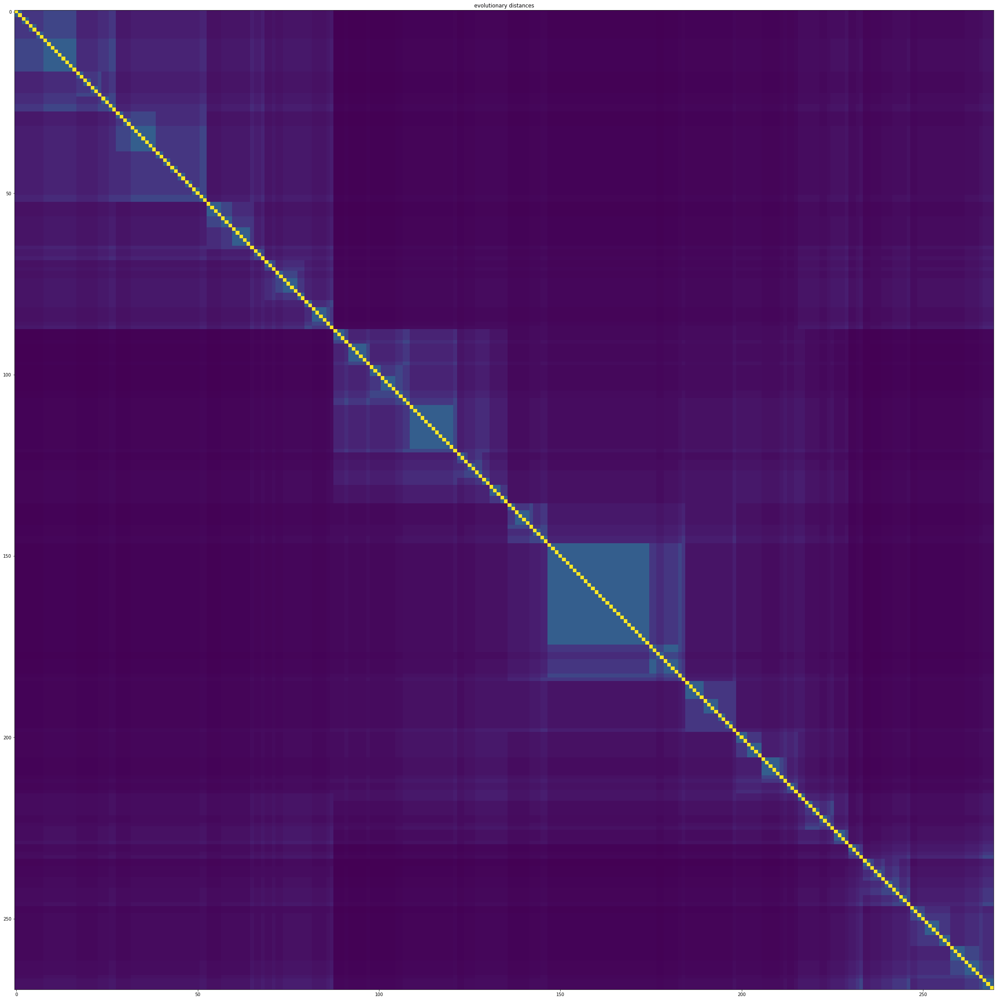

In [10]:
cub.get_evolutionary_distance(display_tree=False, size=40)

In [49]:
cub.loadspeciestable()

it worked !


we can see here that there is a strongcorrelation of the entropy to the number of synonimous codons, however, it is not enough to be able to classify it (for example PRO(14,4 codons) is less informative than LYS(12, 2 codons)

Moreover, you can see it has been decided not to normalize the vectors. this is because we are never comparing the values of the vector to any other values for classifying or clustering etc.. 
We are only using the vectors. and we might want to compare the different values within the vectors, different vectors among homologies or different vectors among different hmologies etc. rescaling the vectors within themselves would not change a thing in comparing the different values since we would still have the same disrepency between different dimensions and we would not be able to compare different vectors, rescaling all the vectors from within an homology would prevent us from comparing different vectors together.. etc. not rescaling here seems to be the better option (for any other variable in the regression step we preprocess and normalize all of them.

In [161]:
cub.compute_averages(homoset=cub.all_homoset)

511
homology averages : [  4.51555706   6.05122334   1.71338396   1.70095787   0.72912374
   1.62519332   2.44408294   4.65569403   1.01447339   4.0726771
  10.87362756   2.66914763   1.52584104   3.61060312   5.10305581
   3.27081535   1.20452668   4.61867714]


In [13]:
#cub.compute_age(homoset=cub.all_homoset)
cub.all_homoset.compute_ages(preserved=True, minpreserv=0.9, minsimi=0.85)

it was already loaded


In [293]:
print cub.all_homoset['YMR186W']


homology: YMR186W
size: 550
fullmax: 95.030388428
var: [  9.76064463   8.00349173   5.36401277   6.32286247   0.77767972
   5.1206442   19.51318691   6.28445717   1.96535043   8.86923904
  17.05627861  16.03182069   6.01990647   6.35139554  11.08507711
  10.04152211   3.55231212   8.38119556]
mean: [ 18.2098458   16.90886703  10.07872097   5.33678356   0.48330023
   6.84888559  28.51495954  15.52612261   2.98357867  22.34445412
  39.59356623  32.93171482   8.94501112  10.16085624  22.35686529
  19.95389706   5.72739935  19.77422222]
metrics: {'silhouette': -0.09659894360828988, 'cal_hara': 35.028744694003414, 'cluster_phylodistance': [0.9975581922670056, 0.9332324801700875, 0.33127733062314796, 1.0180717965491863]}
nans mean: 0.154545454545
lengths mean/var: 663.372727273, 151.73919366
doublon sum: 54
GCcount mean/var: 0.511269728852, 0.0720579496983
KaKs_Scores: None
isrecent: False
ishighpreserved: False
ref: None
refprot: YMR186W
refgene: YMR186W
ecai mean/var: 0.49489271782, 0.097

In [111]:
print cub.all_homoset[801]


homology: YHR128W
fullmax: 32.4567085966
var: [  4.1607425   12.03762035   1.14677029   1.69216869   0.5702097
   1.75303178   4.93119341  13.67108283   0.30532552   8.86113893
  26.33032304   3.19961673   0.85344175   4.88097012   2.75187593
   3.61852249   0.85490468   5.28349231]
mean: [ 2.40239371  4.51020741  0.81260334  0.92579017  0.67099585  1.05231971
  1.70575726  4.37651959  0.42909779  4.29032331  7.00265521  1.6641157
  0.74382017  2.84859805  2.6618517   2.22264872  0.69698803  3.30109369]
metrics: {}
nans mean: 0.0229645093946
lengths mean/var: 6065.5, 2525.16046245
doublon sum: 16
GCcount mean/var: 0.505510244277, 0.0627253130646
KaKs_Scores: None
isrecent: False
ishighpreserved: False
ref: None
refprot: YHR128W
refgene: YHR128W
ecai mean/var: 0.621852533292, 0.0577606396399
cai mean/var: 0.614387123884, 0.0779606797387
protein_abundance: 0.0
weight: 24594
conservation: 5.34881516588
mRNA_abundance: 3.4
cys_elements: 0
is_secreted: False
decay_rate: nan
tot_volume: 295

In [120]:
print cub.all_homoset[802]


homology: YOR297C
fullmax: 43.5432941006
var: [ 10.96460942   4.29755003   1.13009224   0.63491206   0.17237484
   1.25950555   1.03162661   4.47726338   1.40486144   3.86767169
  16.41903434   1.56872879   2.1480799    5.42550846   4.32461948
   5.26668312   0.85433436   5.42389852]
mean: [ 4.279632    3.22583531  1.00391296  0.73858249  0.35496674  0.97450588
  1.04423087  3.08011196  1.19291053  3.1351994   7.41547671  1.48005114
  1.40220407  3.31813297  3.44347953  2.98631148  0.92540515  3.45304384]
metrics: {}
nans mean: 0.18253968254
lengths mean/var: 172.898809524, 34.3271445903
doublon sum: 34
GCcount mean/var: 0.556023220506, 0.0840633998413
KaKs_Scores: None
isrecent: False
ishighpreserved: False
ref: None
refprot: YOR297C
refgene: YOR297C
ecai mean/var: 0.519472598174, 0.0729469295626
cai mean/var: 0.590277667669, 0.0842148560574
protein_abundance: 3732.0
weight: 21900
conservation: 5.17419354839
mRNA_abundance: 0.8
cys_elements: 0
is_secreted: False
decay_rate: 0.000891


Even if the entropy has to and is sometimes correlated with the length of the vectors and the number of codons, there is much stronger correlation to other factors as we can see.

In [125]:
print cub.all_homoset[803]


homology: YDR225W
fullmax: 23.8531289234
var: [  1.04700978e+01   8.10789376e+00   2.04681876e+00   3.04760793e-01
   1.34888838e-02   1.36440269e+00   1.69349523e+00   1.23835541e+01
   4.77453249e-01   1.30471793e+00   1.87444623e+01   5.71927940e+00
   8.53043729e-02   2.13992995e+00   4.76452481e+00   1.01585471e+00
   3.27095330e-01   2.43238696e+00]
mean: [ 5.73543746  6.37423993  2.10950521  0.39222762  0.47943441  1.27108448
  1.3727308   6.84953834  0.63811475  2.35097875  7.93915948  3.24203285
  0.11309867  2.39074953  3.52141456  1.12005007  0.5817396   3.04990592]
metrics: {}
nans mean: 1.00142653352
lengths mean/var: 134.47360913, 16.4361368061
doublon sum: 239
GCcount mean/var: 0.546242446349, 0.066250047352
KaKs_Scores: None
isrecent: False
ishighpreserved: True
ref: None
refprot: YDR225W
refgene: YDR225W
ecai mean/var: 0.697564114583, 0.0521969540319
cai mean/var: 0.615058650329, 0.100460275464
protein_abundance: 54475.0
weight: 13989
conservation: 5.31526717557
mRNA_

In [122]:
print cub.all_homoset[804]


homology: YIL101C
fullmax: 54.2528235449
var: [ 12.70443232  24.53553302  11.31956641   4.26962965   0.81744691
   5.41901108   4.69823105   9.13830036   2.17555433   8.30910355
  37.24422078   6.00312011   2.4394953   19.78828789  31.47122776
   9.36325869   3.56131332   6.06986971]
mean: [ 3.28775727  5.66770039  1.57519691  1.49549857  0.64210838  1.36855579
  1.30938285  3.24867562  0.9050903   3.37232203  6.94064742  1.89706345
  1.08899251  3.79294262  5.90857522  3.06867687  1.3231903   3.12115915]
metrics: {}
nans mean: 0.053488372093
lengths mean/var: 450.376744186, 159.217015623
doublon sum: 24
GCcount mean/var: 0.530290387033, 0.0628666367908
KaKs_Scores: None
isrecent: False
ishighpreserved: False
ref: None
refprot: YIL101C
refgene: YIL101C
ecai mean/var: 0.644147743413, 0.0299815078279
cai mean/var: 0.609471494521, 0.0644030165209
protein_abundance: 164.0
weight: 72687
conservation: 4.85441640379
mRNA_abundance: 0.4
cys_elements: 0
is_secreted: False
decay_rate: 0.036481


A lot tend to point out that the two distribution all_homoset and working are the same and thus removing the 1/2 homologies that are underrepresented does not skew or bias the distribution.

In [34]:
cub.all_homoset.homo_matrix.max(0)

array([ 315.11608917,  327.41540819,  160.0414408 ,  487.89411216,
         52.94063673,  167.46844147,  179.16199446,  355.80320172,
         83.20523309,  174.17504316,  703.43954027,  163.36772378,
        135.52066175,  407.63142791,  317.63055617,  263.0384299 ,
         92.81086287,  349.44444376])

In [40]:
cub.all_homoset.homo_matrix.mean(0)

array([  5.94535188,   7.55111827,   2.21075474,   2.11802318,
         0.74706038,   1.99656174,   3.07157284,   6.80222758,
         1.17308691,   5.8847418 ,  12.63998386,   4.18494766,
         1.99909645,   3.98521084,   6.06791147,   4.28587105,
         1.6369395 ,   6.39921517])

In [41]:
cub.all_homoset.homo_matrix.var(0)**(0.5)

array([  7.65164553,   8.51687922,   3.58228369,   3.8571531 ,
         1.16062417,   3.38140755,   5.18205945,   8.31587079,
         1.85351603,   6.52986744,  13.64420273,   6.37602431,
         3.04094619,   5.04495174,   6.78347536,   5.14261895,
         2.53622075,   7.12209085])

all the highest entropy are in the working homoset and it seems that the mean is slightly higher for it

In [42]:
cub.working_homoset.homo_matrix.max(0)

array([ 315.11608917,  327.41540819,  160.0414408 ,  487.89411216,
         52.94063673,  167.46844147,  179.16199446,  312.53081164,
         73.69609675,  174.17504316,  703.43954027,  163.36772378,
        135.52066175,  407.63142791,  317.63055617,  170.11689243,
         92.81086287,  349.44444376])

In [43]:
cub.working_homoset.homo_matrix.mean(0)

array([  5.97628942,   7.70757895,   2.22471043,   2.13199829,
         0.74290188,   2.01099741,   3.17823769,   6.85060898,
         1.19385793,   5.96524715,  12.82902082,   4.46611862,
         2.00879056,   3.99377676,   6.03202785,   4.25497258,
         1.65132861,   6.49788342])

In [44]:
cub.working_homoset.homo_matrix.var(0)**(0.5)

array([  7.67603982,   8.76717122,   3.57895547,   3.92763532,
         1.15799442,   3.40407144,   5.348315  ,   8.26130029,
         1.88114428,   6.61396437,  13.98781425,   6.66422731,
         3.02849258,   5.05068292,   6.70552172,   5.01830508,
         2.55054707,   7.22239885])

Here we do for both homoset and we will see if anything interesting comes out.

Even if the clustering values are not the same, we can still see that for both 6-10 were the best ones.
the silhouette clustering seems to be showing that clusters are overlapping often but it is not too bad and it is even good for some, with values around .4-.6. it is interesting to see that except for small secondary cluster, most of the cluster do not cluster according to phylogenetic distances, meaning that only certain groups of very similar species have their entropy values that are highly similar as well. It could be reasonable in the framework of the Mutation-selection-drift balance that such genes are not the highly expressed ones 

epoch: 29                            

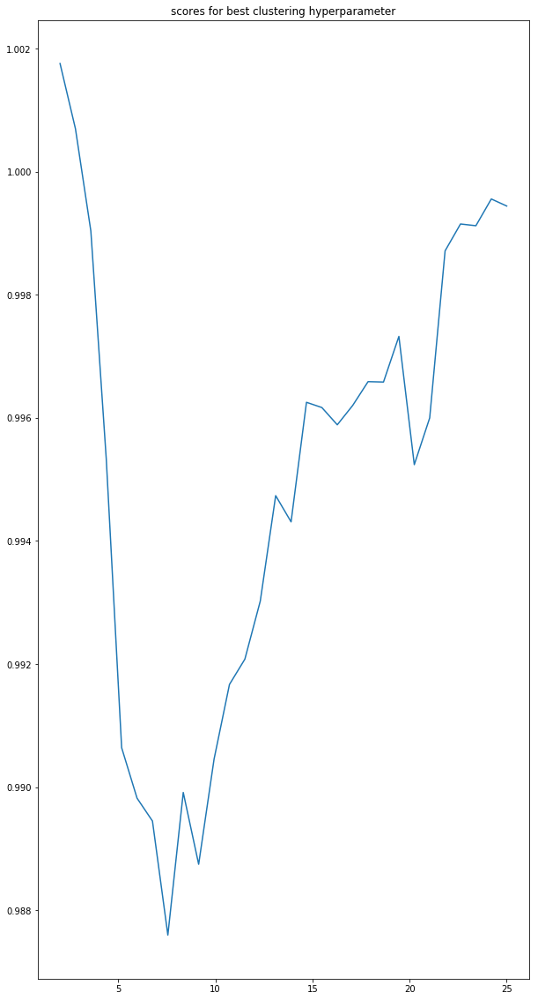

 the best value is : 7.55172413793
YGR097W
Estimated number of clusters using DBscan: 1
silhouette_score 0.114931290713
cal_hara 54.5214868104
avg phylo dist of the clusters: [ 1.01790213  0.92353346]
-----------------------------
YJL200C
Estimated number of clusters using DBscan: 1
silhouette_score 0.147074456278
cal_hara 111.651534439
avg phylo dist of the clusters: [ 0.9952375   0.99211725]
-----------------------------
YDR348C
Estimated number of clusters using DBscan: 1
silhouette_score 0.249628874793
cal_hara 101.313050657
avg phylo dist of the clusters: [ 0.963353    1.02818911]
-----------------------------
YPL183C
Estimated number of clusters using DBscan: 1
silhouette_score 0.157387109334
cal_hara 96.0447515027
avg phylo dist of the clusters: [ 1.01826062  0.90407747]
-----------------------------
YEL015W
Estimated number of clusters using DBscan: 1
silhouette_score 0.188733761016
cal_hara 86.8639670722
avg phylo dist of the clusters: [ 1.01569436  0.92965557]
---------------

avg phylo dist of the clusters: [ 0.98587312  1.00868258]
-----------------------------
YPR062W
Estimated number of clusters using DBscan: 1
silhouette_score 0.453740850926
cal_hara 59.9452085356
avg phylo dist of the clusters: [ 1.03214072  0.99963563]
-----------------------------
YDR402C
Estimated number of clusters using DBscan: 1
silhouette_score 0.201703667624
cal_hara 117.444545709
avg phylo dist of the clusters: [ 1.01915776  1.00896587]
-----------------------------
YMR244W
Estimated number of clusters using DBscan: 2
silhouette_score 0.0386410847215
cal_hara 34.6893828399
avg phylo dist of the clusters: [ 0.98648497  0.98632661  1.21138462]
-----------------------------
YOR365C
Estimated number of clusters using DBscan: 3
silhouette_score -0.237660694612
cal_hara 20.4065782219
avg phylo dist of the clusters: [ 0.99843318  0.88214079  0.67734897]
-----------------------------
YGR210C
Estimated number of clusters using DBscan: 1
silhouette_score 0.279817704243
cal_hara 161.2555

avg phylo dist of the clusters: [ 0.99813889  0.98128145]
-----------------------------
YNL320W
Estimated number of clusters using DBscan: 1
silhouette_score 0.361375533151
cal_hara 88.7849441274
avg phylo dist of the clusters: [ 0.97703935  1.00564129]
-----------------------------
YNL268W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0463970437888
cal_hara 51.3277717969
avg phylo dist of the clusters: [ 0.97631235  1.04678122  0.76654058]
-----------------------------
YIL105C
Estimated number of clusters using DBscan: 1
silhouette_score 0.115738864069
cal_hara 63.8432325012
avg phylo dist of the clusters: [ 1.0104404   0.92281655]
-----------------------------
YDR403W
Estimated number of clusters using DBscan: 1
silhouette_score 0.247347045914
cal_hara 142.562809064
avg phylo dist of the clusters: [ 1.00116593  0.99880837]
-----------------------------
YCL026C-B
Estimated number of clusters using DBscan: 3
silhouette_score 0.256075319281
cal_hara 103.546803126
avg 

Estimated number of clusters using DBscan: 1
silhouette_score 0.443351615133
cal_hara 18.3456695444
avg phylo dist of the clusters: [ 0.18154288  1.00208489]
-----------------------------
YLR120C
Estimated number of clusters using DBscan: 1
silhouette_score 0.20913770359
cal_hara 269.472089122
avg phylo dist of the clusters: [ 1.00770522  1.01785264]
-----------------------------
YOR140W
Estimated number of clusters using DBscan: 1
silhouette_score 0.405736651919
cal_hara 93.1869268355
avg phylo dist of the clusters: [ 1.0341745   1.00549895]
-----------------------------
YFL055W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0756105325204
cal_hara 48.525150323
avg phylo dist of the clusters: [ 0.99661355  1.02522775  0.81869017]
-----------------------------
YDR428C
Estimated number of clusters using DBscan: 2
silhouette_score 0.341963943171
cal_hara 77.6932937859
avg phylo dist of the clusters: [ 1.04074023  0.94548885]
-----------------------------
YMR265C
Estimate

avg phylo dist of the clusters: [ 0.98525448  1.02578053  0.36114142]
-----------------------------
YER060W-A
Estimated number of clusters using DBscan: 4
silhouette_score -0.166841321976
cal_hara 20.1907264674
avg phylo dist of the clusters: [ 0.98737887  1.0468542   0.1824766   0.68732852  1.03403405]
-----------------------------
YLR183C
Estimated number of clusters using DBscan: 1
silhouette_score 0.201762551939
cal_hara 92.680685893
avg phylo dist of the clusters: [ 0.97569535  0.99364691]
-----------------------------
YDL055C
Estimated number of clusters using DBscan: 3
silhouette_score -0.127140397995
cal_hara 22.4743718841
avg phylo dist of the clusters: [ 1.00408833  0.88776204  1.43164787  0.59651995]
-----------------------------
YDR459C
Estimated number of clusters using DBscan: 1
silhouette_score 0.442640779036
cal_hara 126.53594966
avg phylo dist of the clusters: [ 1.06724682  0.97315467]
-----------------------------
YNL194C
Estimated number of clusters using DBscan: 1
s

avg phylo dist of the clusters: [ 0.99998815]
-----------------------------
YER060W
Estimated number of clusters using DBscan: 4
silhouette_score -0.164756901711
cal_hara 20.6259663371
avg phylo dist of the clusters: [ 0.9889373   1.03975269  0.1824766   0.68732852  1.03403405]
-----------------------------
YCR054C
Estimated number of clusters using DBscan: 1
silhouette_score 0.160802230934
cal_hara 90.5025327443
avg phylo dist of the clusters: [ 1.00837     0.95127134]
-----------------------------
YGL029W
Estimated number of clusters using DBscan: 1
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YGR234W
Estimated number of clusters using DBscan: 1
silhouette_score 0.119127500631
cal_hara 123.041711232
avg phylo dist of the clusters: [ 0.99760701  0.99259236]
-----------------------------
YER087W
Estimated number of clusters using DBscan: 1
silhouette_score 0.340823265016
cal_hara 135.036446385
avg phylo dist of the clusters: [ 1.0119

avg phylo dist of the clusters: [ 0.98472758  1.00653714]
-----------------------------
YKR023W
Estimated number of clusters using DBscan: 1
silhouette_score 0.297513085492
cal_hara 117.687882637
avg phylo dist of the clusters: [ 1.00334377  0.9966197 ]
-----------------------------
YIL131C
Estimated number of clusters using DBscan: 2
silhouette_score 0.124823636397
cal_hara 52.417034895
avg phylo dist of the clusters: [ 0.96430292  1.00530332  0.62307254]
-----------------------------
YIR042C
Estimated number of clusters using DBscan: 2
silhouette_score 0.359100268411
cal_hara 47.9968931771
avg phylo dist of the clusters: [ 1.00242499  0.97480855  1.11847754]
-----------------------------
YOR118W
Estimated number of clusters using DBscan: 1
silhouette_score 0.261905748645
cal_hara 111.486861091
avg phylo dist of the clusters: [ 1.04830161  0.92438831]
-----------------------------
YLR121C
Estimated number of clusters using DBscan: 1
silhouette_score 0.207006304799
cal_hara 266.6737599

avg phylo dist of the clusters: [ 1.]
-----------------------------
YPL127C
Estimated number of clusters using DBscan: 3
silhouette_score 0.117647393285
cal_hara 32.1882324619
avg phylo dist of the clusters: [ 1.11137295  0.99453874  0.18364982  0.42851626]
-----------------------------
YAL061W
Estimated number of clusters using DBscan: 2
silhouette_score 0.183946636811
cal_hara 113.834134569
avg phylo dist of the clusters: [ 0.99670495  0.98856102]
-----------------------------
YPL207W
Estimated number of clusters using DBscan: 2
silhouette_score -0.117775876795
cal_hara 28.7254893949
avg phylo dist of the clusters: [ 1.00942538  0.84212668  0.74985194]
-----------------------------
YOL152W
Estimated number of clusters using DBscan: 3
silhouette_score -0.116141508344
cal_hara 20.640166081
avg phylo dist of the clusters: [ 0.98373183  0.95505942  1.09131541]
-----------------------------
YLL048C
Estimated number of clusters using DBscan: 1
silhouette_score -0.143634382115
cal_hara 6.47

avg phylo dist of the clusters: [ 0.99228655  0.95222403  0.64072615]
-----------------------------
YMR012W
Estimated number of clusters using DBscan: 2
silhouette_score -0.245631519101
cal_hara 7.13446028387
avg phylo dist of the clusters: [ 1.00207289  1.00800124  0.35576514]
-----------------------------
YOR223W
Estimated number of clusters using DBscan: 1
silhouette_score 0.404190323303
cal_hara 182.684267281
avg phylo dist of the clusters: [ 1.04404293  0.96920495]
-----------------------------
YBR298C
Estimated number of clusters using DBscan: 2
silhouette_score 0.00469851941737
cal_hara 49.950869011
avg phylo dist of the clusters: [ 0.95489271  1.04592256  1.1843451 ]
-----------------------------
YBL015W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0521601321596
cal_hara 29.2390963931
avg phylo dist of the clusters: [ 0.98664418  1.14227144  1.10271226]
-----------------------------
YDL020C
Estimated number of clusters using DBscan: 2
silhouette_score 0.0335

avg phylo dist of the clusters: [ 1.00600251  0.94377844  0.38699505]
-----------------------------
YPL129W
Estimated number of clusters using DBscan: 1
silhouette_score 0.310406180188
cal_hara 66.9601802715
avg phylo dist of the clusters: [ 0.98428589  1.00124848]
-----------------------------
YLL009C
Estimated number of clusters using DBscan: 1
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YJR059W
Estimated number of clusters using DBscan: 3
silhouette_score -0.0635137509131
cal_hara 28.2494227956
avg phylo dist of the clusters: [ 1.02282409  0.90770673  0.63088404  0.72101033]
-----------------------------
YML117W
Estimated number of clusters using DBscan: 1
silhouette_score 0.361776132155
cal_hara 82.3230813354
avg phylo dist of the clusters: [ 1.00079145  0.98395401]
-----------------------------
YJL219W
Estimated number of clusters using DBscan: 4
silhouette_score -0.145981181974
cal_hara 42.2435437267
avg phylo dist of the clus

Estimated number of clusters using DBscan: 2
silhouette_score 0.106171518113
cal_hara 114.66922222
avg phylo dist of the clusters: [ 1.0057186   0.97197477  0.57832251]
-----------------------------
YIL164C
Estimated number of clusters using DBscan: 1
silhouette_score 0.448357403689
cal_hara 240.489312217
avg phylo dist of the clusters: [ 0.94117919  1.01008613]
-----------------------------
YDL133W
Estimated number of clusters using DBscan: 1
silhouette_score 0.387062603189
cal_hara 141.926892511
avg phylo dist of the clusters: [ 1.03658984  0.98089615]
-----------------------------
YDR444W
Estimated number of clusters using DBscan: 1
silhouette_score 0.127739982765
cal_hara 75.4882078678
avg phylo dist of the clusters: [ 0.99030427  0.94782395]
-----------------------------
YDR242W
Estimated number of clusters using DBscan: 2
silhouette_score 0.189088935264
cal_hara 110.108267731
avg phylo dist of the clusters: [ 0.96258759  0.9851879   1.48478685]
-----------------------------
YLR03

avg phylo dist of the clusters: [ 1.00296542]
-----------------------------
YDR343C
Estimated number of clusters using DBscan: 4
silhouette_score -0.14380691266
cal_hara 41.8391871073
avg phylo dist of the clusters: [ 0.9927417   0.94095645  0.19138097  1.14828583]
-----------------------------
YJL206C
Estimated number of clusters using DBscan: 2
silhouette_score 0.0619630591542
cal_hara 64.1029810179
avg phylo dist of the clusters: [ 1.01230747  0.96775064  0.69569802]
-----------------------------
YGR252W
Estimated number of clusters using DBscan: 1
silhouette_score 0.332214415105
cal_hara 199.16080008
avg phylo dist of the clusters: [ 1.0157023   0.92771279]
-----------------------------
YLR108C
Estimated number of clusters using DBscan: 1
silhouette_score 0.313072065619
cal_hara 160.718094356
avg phylo dist of the clusters: [ 1.01005698  1.00246921]
-----------------------------
YLR214W
Estimated number of clusters using DBscan: 1
silhouette_score 0.280903158644
cal_hara 272.778749

Estimated number of clusters using DBscan: 4
silhouette_score -0.171181167732
cal_hara 9.74044572796
avg phylo dist of the clusters: [ 0.98034383  0.95841135  0.60085052  1.23180145  0.38898993]
-----------------------------
YIL001W
Estimated number of clusters using DBscan: 1
silhouette_score 0.268184721517
cal_hara 140.611372055
avg phylo dist of the clusters: [ 0.99325747  0.98158741]
-----------------------------
YGL144C
Estimated number of clusters using DBscan: 1
silhouette_score 0.10908554991
cal_hara 70.0443346374
avg phylo dist of the clusters: [ 0.99727216  0.96134644]
-----------------------------
YIL039W
Estimated number of clusters using DBscan: 1
silhouette_score 0.225132886709
cal_hara 109.648337287
avg phylo dist of the clusters: [ 1.00796868  0.95993792]
-----------------------------
YDR071C
Estimated number of clusters using DBscan: 1
silhouette_score 0.403471365199
cal_hara 95.2899092657
avg phylo dist of the clusters: [ 0.86768275  1.01111028]
----------------------

avg phylo dist of the clusters: [ 0.96812089  1.03972703  0.7626163 ]
-----------------------------
YDR030C
Estimated number of clusters using DBscan: 1
silhouette_score 0.305000372907
cal_hara 102.886628488
avg phylo dist of the clusters: [ 0.97999271  1.00634169]
-----------------------------
YML076C
Estimated number of clusters using DBscan: 1
silhouette_score 0.368148847601
cal_hara 251.819480664
avg phylo dist of the clusters: [ 1.03694297  0.99820631]
-----------------------------
YMR311C
Estimated number of clusters using DBscan: 1
silhouette_score 0.35234189566
cal_hara 95.2560071058
avg phylo dist of the clusters: [ 1.00648725  0.98742014]
-----------------------------
YIR032C
Estimated number of clusters using DBscan: 1
silhouette_score 0.452401967061
cal_hara 171.246151362
avg phylo dist of the clusters: [ 0.96889557  0.99250224]
-----------------------------
YMR011W
Estimated number of clusters using DBscan: 4
silhouette_score -0.151113233874
cal_hara 40.7507318977
avg phyl

avg phylo dist of the clusters: [ 0.94708179  1.00741927]
-----------------------------
YGR191W
Estimated number of clusters using DBscan: 4
silhouette_score -0.0810902301977
cal_hara 47.8294877113
avg phylo dist of the clusters: [ 1.0146082   0.94263196  0.89641526  1.2917095 ]
-----------------------------
YDR306C
Estimated number of clusters using DBscan: 1
silhouette_score 0.442813537095
cal_hara 144.095581723
avg phylo dist of the clusters: [ 1.01408092  0.99492324]
-----------------------------
YCL052C
Estimated number of clusters using DBscan: 1
silhouette_score 0.247835750333
cal_hara 90.3822830543
avg phylo dist of the clusters: [ 0.96533269  1.01266264]
-----------------------------
YKL121W
Estimated number of clusters using DBscan: 1
silhouette_score 0.151671106913
cal_hara 92.0131329826
avg phylo dist of the clusters: [ 1.01103618  0.95981208]
-----------------------------
YJR156C
Estimated number of clusters using DBscan: 1
silhouette_score 0.11620448874
cal_hara 60.356209

avg phylo dist of the clusters: [ 0.94038931  1.00409592]
-----------------------------
YNL201C
Estimated number of clusters using DBscan: 1
silhouette_score 0.137585657391
cal_hara 98.3602412719
avg phylo dist of the clusters: [ 0.97906922  1.00708389]
-----------------------------
YCR061W
Estimated number of clusters using DBscan: 3
silhouette_score 0.0285036866435
cal_hara 64.1350857098
avg phylo dist of the clusters: [ 0.98026936  1.00417746  0.6802425 ]
-----------------------------
YHR051W
Estimated number of clusters using DBscan: 1
silhouette_score 0.282647914342
cal_hara 38.930788374
avg phylo dist of the clusters: [ 0.98585401  1.00104293]
-----------------------------
YGL167C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0834109016905
cal_hara 39.0997644929
avg phylo dist of the clusters: [ 0.98258716  1.0342184   0.57325283]
-----------------------------
YDL165W
Estimated number of clusters using DBscan: 1
silhouette_score 0.387050532108
cal_hara 123.1771

avg phylo dist of the clusters: [ 0.97576129  0.98043694  0.77365388  1.07271336]
-----------------------------
YDR457W
Estimated number of clusters using DBscan: 1
silhouette_score -0.126045592561
cal_hara 6.59731951026
avg phylo dist of the clusters: [ 1.          0.73287179]
-----------------------------
YGL097W
Estimated number of clusters using DBscan: 2
silhouette_score 0.0646948904763
cal_hara 98.7765462255
avg phylo dist of the clusters: [ 0.98277613  1.00308539  0.7626717 ]
-----------------------------
YPL140C
Estimated number of clusters using DBscan: 3
silhouette_score 0.0626369290521
cal_hara 44.4406114018
avg phylo dist of the clusters: [ 0.98565782  1.00110334  0.17215093  0.34430186]
-----------------------------
YNR016C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YER123W
Estimated number of clusters using DBscan: 4
silhouette_score 0.010643562064
cal_hara 43.3159622373
av

avg phylo dist of the clusters: [ 0.9761705   1.02411593  1.20280236]
-----------------------------
YNL081C
Estimated number of clusters using DBscan: 1
silhouette_score 0.570461277942
cal_hara 97.2218257443
avg phylo dist of the clusters: [ 0.83590434  1.00145336]
-----------------------------
YDR049W
Estimated number of clusters using DBscan: 1
silhouette_score 0.292412709173
cal_hara 177.263542506
avg phylo dist of the clusters: [ 0.96119161  1.01028248]
-----------------------------
YKL170W
Estimated number of clusters using DBscan: 1
silhouette_score 0.423868613878
cal_hara 24.127539019
avg phylo dist of the clusters: [ 0.68972692  0.99925941]
-----------------------------
YGL047W
Estimated number of clusters using DBscan: 1
silhouette_score 0.485188559869
cal_hara 135.157305959
avg phylo dist of the clusters: [ 0.89804477  1.00809413]
-----------------------------
YLR006C
Estimated number of clusters using DBscan: 1
silhouette_score 0.102091359374
cal_hara 85.4547063273
avg phylo

avg phylo dist of the clusters: [ 0.92927656  1.00877887]
-----------------------------
YDL219W
Estimated number of clusters using DBscan: 1
silhouette_score 0.503553743163
cal_hara 59.6324725662
avg phylo dist of the clusters: [ 0.65438549  1.00447331]
-----------------------------
YDL080C
Estimated number of clusters using DBscan: 4
silhouette_score 0.0388839418808
cal_hara 97.0975642247
avg phylo dist of the clusters: [ 0.98861862  0.96812674  1.03504904  0.34501635]
-----------------------------
YGL240W
Estimated number of clusters using DBscan: 1
silhouette_score 0.439998288536
cal_hara 171.522134574
avg phylo dist of the clusters: [ 0.88216655  0.99045107]
-----------------------------
YJL060W
Estimated number of clusters using DBscan: 2
silhouette_score 0.0878463849802
cal_hara 80.8791063146
avg phylo dist of the clusters: [ 0.98929091  0.99457765  1.14284558]
-----------------------------
YER174C
Estimated number of clusters using DBscan: 1
silhouette_score 0.334996226969
cal_h

avg phylo dist of the clusters: [ 0.98802993  0.99999685  0.69904536]
-----------------------------
YHR128W
Estimated number of clusters using DBscan: 1
silhouette_score 0.396153766686
cal_hara 186.419560924
avg phylo dist of the clusters: [ 0.9483277   1.01148789]
-----------------------------
YOR297C
Estimated number of clusters using DBscan: 1
silhouette_score 0.343304541038
cal_hara 43.4575780845
avg phylo dist of the clusters: [ 0.93878822  1.00356286]
-----------------------------
YDR225W
Estimated number of clusters using DBscan: 1
silhouette_score 0.385616967868
cal_hara 15.5343232788
avg phylo dist of the clusters: [ 1.2026188  1.       ]
-----------------------------
YIL101C
Estimated number of clusters using DBscan: 1
silhouette_score 0.336468370293
cal_hara 134.614058109
avg phylo dist of the clusters: [ 0.9487338   1.01812761]
-----------------------------
YPR114W
Estimated number of clusters using DBscan: 1
silhouette_score 0.341042826678
cal_hara 196.705406117
avg phylo 

avg phylo dist of the clusters: [ 0.96222175  1.00361584]
-----------------------------
YLR216C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0160439978335
cal_hara 81.5825239626
avg phylo dist of the clusters: [ 0.99073781  0.96115763  0.17143558]
-----------------------------
YJL092W
Estimated number of clusters using DBscan: 1
silhouette_score 0.16896798564
cal_hara 85.6450443539
avg phylo dist of the clusters: [ 0.98692455  1.00497247]
-----------------------------
YDR096W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0405173797458
cal_hara 39.7318413896
avg phylo dist of the clusters: [ 0.98173676  0.9521975   0.65537816]
-----------------------------
YML018C
Estimated number of clusters using DBscan: 1
silhouette_score 0.43201790222
cal_hara 318.105427845
avg phylo dist of the clusters: [ 0.94895787  1.0182409 ]
-----------------------------
YOR369C
Estimated number of clusters using DBscan: 1
silhouette_score 0.445777036728
cal_hara 36.66694

avg phylo dist of the clusters: [ 0.93697573  1.00234973]
-----------------------------
YDL046W
Estimated number of clusters using DBscan: 1
silhouette_score 0.359345133902
cal_hara 49.5410814393
avg phylo dist of the clusters: [ 0.87733684  1.00728388]
-----------------------------
YER125W
Estimated number of clusters using DBscan: 4
silhouette_score -0.17300622107
cal_hara 22.1088675593
avg phylo dist of the clusters: [ 0.99195555  0.98196927  1.12032434  0.5745253   1.14905061]
-----------------------------
YOL113W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0707313246674
cal_hara 35.0057870454
avg phylo dist of the clusters: [ 0.99092329  1.03067625  0.34425768]
-----------------------------
YDR517W
Estimated number of clusters using DBscan: 1
silhouette_score 0.403594566387
cal_hara 223.144633084
avg phylo dist of the clusters: [ 0.96252739  1.01140098]
-----------------------------
YDR192C
Estimated number of clusters using DBscan: 1
silhouette_score 0.346041

avg phylo dist of the clusters: [ 0.96747917  1.00841849]
-----------------------------
YJL034W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YLR066W
Estimated number of clusters using DBscan: 1
silhouette_score 0.385298567961
cal_hara 166.583568273
avg phylo dist of the clusters: [ 0.93502323  1.00605154]
-----------------------------
YBR173C
Estimated number of clusters using DBscan: 1
silhouette_score 0.392643940608
cal_hara 59.035066833
avg phylo dist of the clusters: [ 0.98574866  0.99993245]
-----------------------------
YHR057C
Estimated number of clusters using DBscan: 3
silhouette_score 0.0251987861224
cal_hara 40.4537099416
avg phylo dist of the clusters: [ 0.97768696  0.99131766  0.27481413]
-----------------------------
YOR077W
Estimated number of clusters using DBscan: 1
silhouette_score 0.424474977342
cal_hara 195.17073337
avg phylo dist of the clusters: [ 0.94131565  1.008289

avg phylo dist of the clusters: [ 0.89306688  1.00683548]
-----------------------------
YGR028W
Estimated number of clusters using DBscan: 3
silhouette_score -0.00576338820449
cal_hara 50.8323808586
avg phylo dist of the clusters: [ 0.98156292  1.01787664  0.57237806  0.34342684]
-----------------------------
YKL116C
Estimated number of clusters using DBscan: 2
silhouette_score 0.178065277936
cal_hara 62.6652711249
avg phylo dist of the clusters: [ 0.98296414  1.00899855]
-----------------------------
YHR134W
Estimated number of clusters using DBscan: 1
silhouette_score 0.428519199871
cal_hara 137.932694969
avg phylo dist of the clusters: [ 0.99139305  0.99347393]
-----------------------------
YBR228W
Estimated number of clusters using DBscan: 1
silhouette_score 0.432531410848
cal_hara 138.45055441
avg phylo dist of the clusters: [ 0.9230887   1.01292547]
-----------------------------
YGR123C
Estimated number of clusters using DBscan: 2
silhouette_score 0.0772874657361
cal_hara 78.3035

avg phylo dist of the clusters: [ 0.95558685  1.02361525]
-----------------------------
YML061C
Estimated number of clusters using DBscan: 1
silhouette_score 0.2823379564
cal_hara 123.144529599
avg phylo dist of the clusters: [ 0.96363183  1.02010339]
-----------------------------
YLR449W
Estimated number of clusters using DBscan: 5
silhouette_score -0.202614023502
cal_hara 36.0490960296
avg phylo dist of the clusters: [ 0.97729876  0.88478458  1.37804323  0.21819018  0.97611395  0.34451081]
-----------------------------
YDL007W
Estimated number of clusters using DBscan: 6
silhouette_score -0.0775144211405
cal_hara 20.3082804367
avg phylo dist of the clusters: [ 0.97978023  0.96867691  0.16970284  1.01013594  0.69766722  1.07478464
  1.01821702]
-----------------------------
YOR145C
Estimated number of clusters using DBscan: 1
silhouette_score 0.337558668249
cal_hara 153.356011521
avg phylo dist of the clusters: [ 0.94637107  1.01460813]
-----------------------------
YKR069W
Estimated 

avg phylo dist of the clusters: [ 0.98304119  0.99239706  0.93110528]
-----------------------------
YMR239C
Estimated number of clusters using DBscan: 1
silhouette_score 0.414159832882
cal_hara 142.384425843
avg phylo dist of the clusters: [ 0.97697652  1.00499388]
-----------------------------
YLR163C
Estimated number of clusters using DBscan: 6
silhouette_score -0.265615854282
cal_hara 12.3011750186
avg phylo dist of the clusters: [ 0.99793039  0.91024131  0.97488617  1.20427115  0.33588515  1.10678253
  0.34407747]
-----------------------------
YDL072C
Estimated number of clusters using DBscan: 1
silhouette_score 0.236104322259
cal_hara 81.6213505356
avg phylo dist of the clusters: [ 0.97435248  1.00433513]
-----------------------------
YER059W
Estimated number of clusters using DBscan: 2
silhouette_score 0.153041932265
cal_hara 89.7482075556
avg phylo dist of the clusters: [ 0.97785369  1.01591844  1.19987373]
-----------------------------
YBR207W
Estimated number of clusters using

avg phylo dist of the clusters: [ 0.9638486   1.00771863  0.62033981]
-----------------------------
YGR264C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0379634922103
cal_hara 83.0651018675
avg phylo dist of the clusters: [ 0.98191115  1.01426551  1.30077922]
-----------------------------
YBL037W
Estimated number of clusters using DBscan: 2
silhouette_score -0.128381346323
cal_hara 42.1672827062
avg phylo dist of the clusters: [ 0.9877897   0.98680532  0.26915918]
-----------------------------
YPR042C
Estimated number of clusters using DBscan: 3
silhouette_score -0.152074702994
cal_hara 17.4910158539
avg phylo dist of the clusters: [ 0.99628382  1.0399015   1.08814596]
-----------------------------
YBR085W
Estimated number of clusters using DBscan: 7
silhouette_score -0.140876373982
cal_hara 31.0677506394
avg phylo dist of the clusters: [ 0.98424354  0.88414614  0.73363866  0.28663092  0.63058802  0.91721894
  1.05098003  0.80829919]
-----------------------------
YB

cal_hara 130.102920227
avg phylo dist of the clusters: [ 0.98857577  0.99517026]
-----------------------------
YLR017W
Estimated number of clusters using DBscan: 4
silhouette_score -0.0319284786157
cal_hara 44.5190396465
avg phylo dist of the clusters: [ 0.9743932   1.0048782   0.75342725  0.57077822  1.06164749]
-----------------------------
YDL127W
Estimated number of clusters using DBscan: 3
silhouette_score 0.01476514952
cal_hara 65.2977381805
avg phylo dist of the clusters: [ 0.98470623  1.01254422  0.27604504  0.34505629]
-----------------------------
YDL136W
Estimated number of clusters using DBscan: 1
silhouette_score 0.308591599542
cal_hara 10.869028427
avg phylo dist of the clusters: [ 0.97141436  1.00056241]
-----------------------------
YDL216C
Estimated number of clusters using DBscan: 1
silhouette_score 0.366502558613
cal_hara 205.039403589
avg phylo dist of the clusters: [ 0.94227847  1.02005202]
-----------------------------
YFR028C
Estimated number of clusters using DB

avg phylo dist of the clusters: [ 0.99839548  1.32071214  1.09102307]
-----------------------------
YMR300C
Estimated number of clusters using DBscan: 2
silhouette_score -0.00184375789577
cal_hara 54.5421433649
avg phylo dist of the clusters: [ 0.98143955  0.97603019  0.58083062]
-----------------------------
YIL107C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0375263097064
cal_hara 57.672743749
avg phylo dist of the clusters: [ 0.97223027  1.02406832  0.70045064]
-----------------------------
YGL136C
Estimated number of clusters using DBscan: 1
silhouette_score 0.435914474202
cal_hara 148.113638129
avg phylo dist of the clusters: [ 0.95704984  1.00422388]
-----------------------------
YHR024C
Estimated number of clusters using DBscan: 2
silhouette_score -0.00389897744458
cal_hara 66.2236844008
avg phylo dist of the clusters: [ 0.97242094  1.00951768  0.53278959]
-----------------------------
YGR211W
Estimated number of clusters using DBscan: 3
silhouette_score -0.

avg phylo dist of the clusters: [ 0.94805178  1.00502863]
-----------------------------
YDR175C
Estimated number of clusters using DBscan: 1
silhouette_score 0.296495360976
cal_hara 165.711339248
avg phylo dist of the clusters: [ 0.95013551  1.01544235]
-----------------------------
YOR182C
Estimated number of clusters using DBscan: 1
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YGR194C
Estimated number of clusters using DBscan: 2
silhouette_score -0.00378873470231
cal_hara 57.8736578027
avg phylo dist of the clusters: [ 0.98084026  1.00154805  0.98420116]
-----------------------------
YGR078C
Estimated number of clusters using DBscan: 1
silhouette_score 0.48474230024
cal_hara 98.3229762348
avg phylo dist of the clusters: [ 0.85396895  1.00398674]
-----------------------------
YOR222W
Estimated number of clusters using DBscan: 5
silhouette_score -0.0283800979632
cal_hara 41.4973037113
avg phylo dist of the clusters: [ 0.95264729  0.9

Estimated number of clusters using DBscan: 1
silhouette_score 0.34839261241
cal_hara 118.492404061
avg phylo dist of the clusters: [ 0.97677797  1.01357129]
-----------------------------
YNL308C
Estimated number of clusters using DBscan: 2
silhouette_score 0.00387456546757
cal_hara 55.6888939703
avg phylo dist of the clusters: [ 0.98693545  0.98259995]
-----------------------------
YOR171C
Estimated number of clusters using DBscan: 1
silhouette_score 0.289616258331
cal_hara 177.096574295
avg phylo dist of the clusters: [ 0.96075071  1.02097564]
-----------------------------
YIL050W
Estimated number of clusters using DBscan: 2
silhouette_score 0.157366543754
cal_hara 88.2476006602
avg phylo dist of the clusters: [ 0.97789008  1.01731888  1.19949363]
-----------------------------
YLR043C
Estimated number of clusters using DBscan: 1
silhouette_score 0.459006036972
cal_hara 34.5253345805
avg phylo dist of the clusters: [ 0.93829019  0.99996955]
-----------------------------
YBL099W
Estimat

avg phylo dist of the clusters: [ 1.00078218  0.97236459]
-----------------------------
YMR234W
Estimated number of clusters using DBscan: 1
silhouette_score 0.455669855104
cal_hara 193.953609121
avg phylo dist of the clusters: [ 0.93588692  1.00949974]
-----------------------------
YNL212W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0744415318703
cal_hara 49.2217473498
avg phylo dist of the clusters: [ 0.98420392  0.98676491  0.5736581 ]
-----------------------------
YGL212W
Estimated number of clusters using DBscan: 1
silhouette_score 0.334969983824
cal_hara 215.319397715
avg phylo dist of the clusters: [ 0.99527177  1.00664492]
-----------------------------
YHR005C-A
Estimated number of clusters using DBscan: 1
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YJL134W
Estimated number of clusters using DBscan: 1
silhouette_score 0.259524104551
cal_hara 143.395870318
avg phylo dist of the clusters: [ 0.99476811  0.9

avg phylo dist of the clusters: [ 0.97151084  1.00079469]
-----------------------------
YGL237C
Estimated number of clusters using DBscan: 2
silhouette_score 0.245711743093
cal_hara 72.3813379734
avg phylo dist of the clusters: [ 0.93737298  1.01292513  1.10658505]
-----------------------------
YDR120C
Estimated number of clusters using DBscan: 2
silhouette_score 0.00846087024656
cal_hara 77.3767456718
avg phylo dist of the clusters: [ 0.98196784  1.00084126  0.93445387]
-----------------------------
YLR071C
Estimated number of clusters using DBscan: 1
silhouette_score 0.191483426282
cal_hara 114.617217283
avg phylo dist of the clusters: [ 0.98709558  0.99780495]
-----------------------------
YJL012C
Estimated number of clusters using DBscan: 2
silhouette_score -0.159094200988
cal_hara 22.6791598126
avg phylo dist of the clusters: [ 0.98651238  0.97228352  0.75466316]
-----------------------------
YER126C
Estimated number of clusters using DBscan: 1
silhouette_score 0.227510915931
cal_

avg phylo dist of the clusters: [ 0.96881231  1.01193941]
-----------------------------
YMR108W
Estimated number of clusters using DBscan: 3
silhouette_score -0.0611844818155
cal_hara 43.0645174234
avg phylo dist of the clusters: [ 0.99668139  0.98500668  0.3438012   1.1173539 ]
-----------------------------
YJL033W
Estimated number of clusters using DBscan: 2
silhouette_score -0.115489530999
cal_hara 44.5864342088
avg phylo dist of the clusters: [ 0.98483969  0.99751618  0.85458849]
-----------------------------
YKL179C
Estimated number of clusters using DBscan: 1
silhouette_score 0.251787762267
cal_hara 142.545907717
avg phylo dist of the clusters: [ 0.95176179  1.02524246]
-----------------------------
YPL126W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0436156790005
cal_hara 47.1553710976
avg phylo dist of the clusters: [ 0.9764979   0.98755806  0.53654289]
-----------------------------
YEL041W
Estimated number of clusters using DBscan: 2
silhouette_score -0.01

avg phylo dist of the clusters: [ 0.95956559  1.00754254]
-----------------------------
YNR002C
Estimated number of clusters using DBscan: 2
silhouette_score 0.224025522205
cal_hara 162.178315573
avg phylo dist of the clusters: [ 0.97454704  1.01326341  0.85461868]
-----------------------------
YBR086C
Estimated number of clusters using DBscan: 5
silhouette_score -0.19036578408
cal_hara 18.5565359335
avg phylo dist of the clusters: [ 0.99174834  1.00867962  0.17187383  1.08853424  1.03124297  0.34374766]
-----------------------------
YOR027W
Estimated number of clusters using DBscan: 3
silhouette_score -0.158888829229
cal_hara 25.5795638136
avg phylo dist of the clusters: [ 0.97852973  0.94350961  0.17189376]
-----------------------------
YER048W-A
Estimated number of clusters using DBscan: 1
silhouette_score 0.449644459543
cal_hara 6.51756151566
avg phylo dist of the clusters: [ 1.00015176]
-----------------------------
YHR164C
Estimated number of clusters using DBscan: 2
silhouette_s

avg phylo dist of the clusters: [ 0.99289397  1.00359329]
-----------------------------
YDR075W
Estimated number of clusters using DBscan: 1
silhouette_score 0.315388951202
cal_hara 166.931840059
avg phylo dist of the clusters: [ 0.9684729   1.01133192]
-----------------------------
YER009W
Estimated number of clusters using DBscan: 1
silhouette_score 0.4487751436
cal_hara 11.8378422487
avg phylo dist of the clusters: [ 1.1189236   1.00156815]
-----------------------------
YFL034C-B
Estimated number of clusters using DBscan: 2
silhouette_score 0.228673343294
cal_hara 97.6860877339
avg phylo dist of the clusters: [ 0.95297373  1.01172492  1.06579591]
-----------------------------
YMR297W
Estimated number of clusters using DBscan: 2
silhouette_score 0.0139599763868
cal_hara 136.793163948
avg phylo dist of the clusters: [ 0.99494352  0.7949539   1.08811601]
-----------------------------
YNL301C
Estimated number of clusters using DBscan: 2
silhouette_score 0.0430111691045
cal_hara 26.18813

Estimated number of clusters using DBscan: 1
silhouette_score 0.315766327166
cal_hara 153.395426475
avg phylo dist of the clusters: [ 0.99806425  0.99667741]
-----------------------------
YGR192C
Estimated number of clusters using DBscan: 5
silhouette_score -0.151029153186
cal_hara 48.7563409542
avg phylo dist of the clusters: [ 0.99405741  1.03110172  0.58242138  0.50891188  0.67047121]
-----------------------------
YOL041C
Estimated number of clusters using DBscan: 2
silhouette_score 0.0604331969214
cal_hara 68.4770601277
avg phylo dist of the clusters: [ 0.96735659  0.9974102   0.80339505]
-----------------------------
YHR200W
Estimated number of clusters using DBscan: 2
silhouette_score 0.203222334995
cal_hara 69.0438657142
avg phylo dist of the clusters: [ 0.97375793  1.00068964  0.75636777]
-----------------------------
YBR219C
Estimated number of clusters using DBscan: 3
silhouette_score -0.0686603050037
cal_hara 46.8170791859
avg phylo dist of the clusters: [ 0.97119699  1.0029

avg phylo dist of the clusters: [ 0.94996763  1.02705497  1.11461962  1.31467955]
-----------------------------
YPL213W
Estimated number of clusters using DBscan: 2
silhouette_score 0.293856274491
cal_hara 81.3909439362
avg phylo dist of the clusters: [ 0.91551017  1.01130156  0.94707949]
-----------------------------
YPL203W
Estimated number of clusters using DBscan: 1
silhouette_score 0.208818875967
cal_hara 132.638677661
avg phylo dist of the clusters: [ 0.9914227   1.00889788]
-----------------------------
YLL041C
Estimated number of clusters using DBscan: 7
silhouette_score -0.0302052786168
cal_hara 26.8401665285
avg phylo dist of the clusters: [ 0.98851916  0.9917211   0.78838747  0.63548808  0.26211324  0.53514786
  1.0658589 ]
-----------------------------
YBL026W
Estimated number of clusters using DBscan: 1
silhouette_score 0.527185235543
cal_hara 7.64865675028
avg phylo dist of the clusters: [ 0.99933188]
-----------------------------
YNR021W
Estimated number of clusters usin

silhouette_score 0.391351752598
cal_hara 82.4434269524
avg phylo dist of the clusters: [ 0.94698461  1.00410547]
-----------------------------
YMR247C
Estimated number of clusters using DBscan: 2
silhouette_score -0.145306410176
cal_hara 29.6184285951
avg phylo dist of the clusters: [ 0.99823981  0.97491696  0.63876218]
-----------------------------
YKL059C
Estimated number of clusters using DBscan: 1
silhouette_score 0.291898140715
cal_hara 135.428163449
avg phylo dist of the clusters: [ 0.95101963  1.01804612]
-----------------------------
YGR119C
Estimated number of clusters using DBscan: 1
silhouette_score 0.293492093135
cal_hara 143.699758277
avg phylo dist of the clusters: [ 0.99191418  0.99833934]
-----------------------------
YJL204C
Estimated number of clusters using DBscan: 1
silhouette_score 0.175061576168
cal_hara 132.812419944
avg phylo dist of the clusters: [ 0.98067769  0.98067341]
-----------------------------
YGR209C
Estimated number of clusters using DBscan: 1
silhoue

avg phylo dist of the clusters: [ 0.99935981  0.17099419  1.02596512]
-----------------------------
YCR004C
Estimated number of clusters using DBscan: 1
silhouette_score 0.226645645624
cal_hara 152.27085648
avg phylo dist of the clusters: [ 0.98204824  1.01753439]
-----------------------------
YKL028W
Estimated number of clusters using DBscan: 1
silhouette_score 0.300165253723
cal_hara 158.670793958
avg phylo dist of the clusters: [ 0.94941211  1.02702189]
-----------------------------
YPR173C
Estimated number of clusters using DBscan: 1
silhouette_score 0.273464779423
cal_hara 188.565151329
avg phylo dist of the clusters: [ 0.96379358  1.019654  ]
-----------------------------
YPR137W
Estimated number of clusters using DBscan: 2
silhouette_score 0.00907079112796
cal_hara 75.0292374099
avg phylo dist of the clusters: [ 0.97317033  0.99128421  0.98532987]
-----------------------------
YJL108C
Estimated number of clusters using DBscan: 1
silhouette_score 0.131499861791
cal_hara 205.43931

avg phylo dist of the clusters: [ 0.97877242  0.98010877  0.98906933]
-----------------------------
YOR111W
Estimated number of clusters using DBscan: 1
silhouette_score 0.435417352173
cal_hara 174.324092221
avg phylo dist of the clusters: [ 0.94294212  1.01151814]
-----------------------------
YMR096W
Estimated number of clusters using DBscan: 7
silhouette_score -0.102203226782
cal_hara 31.9872474475
avg phylo dist of the clusters: [ 0.96513691  0.96735452  0.84311948  0.17148193  0.68592772  0.57160643
  0.34296386]
-----------------------------
YNL240C
Estimated number of clusters using DBscan: 1
silhouette_score 0.303101195606
cal_hara 190.658700478
avg phylo dist of the clusters: [ 0.98023476  0.98819966]
-----------------------------
YKL019W
Estimated number of clusters using DBscan: 1
silhouette_score 0.359506045353
cal_hara 248.47690986
avg phylo dist of the clusters: [ 0.95221939  1.0154657 ]
-----------------------------
YGR027C
Estimated number of clusters using DBscan: 1
si

avg phylo dist of the clusters: [ 0.97831968  1.01150012  0.33940454]
-----------------------------
YNL274C
Estimated number of clusters using DBscan: 1
silhouette_score 0.366043763793
cal_hara 356.10884677
avg phylo dist of the clusters: [ 0.9863798   1.00619686]
-----------------------------
YOR049C
Estimated number of clusters using DBscan: 1
silhouette_score 0.377107238177
cal_hara 285.570807044
avg phylo dist of the clusters: [ 0.98516001  1.0000879 ]
-----------------------------
YMR027W
Estimated number of clusters using DBscan: 1
silhouette_score 0.216535607115
cal_hara 179.519373121
avg phylo dist of the clusters: [ 0.96282604  1.03112404]
-----------------------------
YGR135W
Estimated number of clusters using DBscan: 1
silhouette_score 0.31446519386
cal_hara 125.896482837
avg phylo dist of the clusters: [ 0.97854929  1.00493557]
-----------------------------
YIL044C
Estimated number of clusters using DBscan: 1
silhouette_score 0.34170394059
cal_hara 149.227933823
avg phylo d

avg phylo dist of the clusters: [ 0.99323857  1.00075475]
-----------------------------
YML086C
Estimated number of clusters using DBscan: 1
silhouette_score 0.15640329266
cal_hara 139.068532269
avg phylo dist of the clusters: [ 0.9774951   1.01923554]
-----------------------------
YMR167W
Estimated number of clusters using DBscan: 1
silhouette_score 0.236475772326
cal_hara 135.400390795
avg phylo dist of the clusters: [ 0.98540432  0.99711117]
-----------------------------
YOR122C
Estimated number of clusters using DBscan: 1
silhouette_score 0.376439547064
cal_hara 14.4292461782
avg phylo dist of the clusters: [ 0.96045166  0.99963401]
-----------------------------
YIL113W
Estimated number of clusters using DBscan: 1
silhouette_score 0.227208784135
cal_hara 100.836931793
avg phylo dist of the clusters: [ 0.99305484  1.01651222]
-----------------------------
YDR414C
Estimated number of clusters using DBscan: 1
silhouette_score 0.379525708302
cal_hara 215.815411541
avg phylo dist of the

avg phylo dist of the clusters: [ 0.82310196  1.0036433 ]
-----------------------------
YLL055W
Estimated number of clusters using DBscan: 1
silhouette_score 0.342787249967
cal_hara 277.389352668
avg phylo dist of the clusters: [ 0.97273895  1.00979047]
-----------------------------
YLR343W
Estimated number of clusters using DBscan: 2
silhouette_score -0.099664842856
cal_hara 55.2042361637
avg phylo dist of the clusters: [ 0.98835783  0.97213143]
-----------------------------
YGR193C
Estimated number of clusters using DBscan: 1
silhouette_score 0.221899418407
cal_hara 157.83232846
avg phylo dist of the clusters: [ 0.94297798  0.99259135]
-----------------------------
YMR260C
Estimated number of clusters using DBscan: 1
silhouette_score 0.338417001112
cal_hara 29.9666118556
avg phylo dist of the clusters: [ 0.89848916  1.00329146]
-----------------------------
YKL101W
Estimated number of clusters using DBscan: 2
silhouette_score -0.150916396398
cal_hara 46.1149455037
avg phylo dist of t

avg phylo dist of the clusters: [ 0.98521641  1.00166702]
-----------------------------
YMR006C
Estimated number of clusters using DBscan: 1
silhouette_score 0.177693405626
cal_hara 220.288842814
avg phylo dist of the clusters: [ 0.9842619   1.02979022]
-----------------------------
YHR064C
Estimated number of clusters using DBscan: 3
silhouette_score -0.171494036441
cal_hara 31.9616922804
avg phylo dist of the clusters: [ 0.99820716  0.96131643  0.79732715  1.01786445]
-----------------------------
YKR002W
Estimated number of clusters using DBscan: 1
silhouette_score 0.213923076351
cal_hara 127.277518675
avg phylo dist of the clusters: [ 0.965485    1.02309913]
-----------------------------
YOR151C
Estimated number of clusters using DBscan: 1
silhouette_score -0.214314316451
cal_hara 4.40896107445
avg phylo dist of the clusters: [ 1.00020099  0.33927136]
-----------------------------
YPL120W
Estimated number of clusters using DBscan: 1
silhouette_score 0.41310441815
cal_hara 231.51836

avg phylo dist of the clusters: [ 0.97580291  1.01937861  1.03389934]
-----------------------------
YEL040W
Estimated number of clusters using DBscan: 1
silhouette_score 0.115058420901
cal_hara 116.539375412
avg phylo dist of the clusters: [ 0.97319519  0.98883807]
-----------------------------
YNL250W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0678192412551
cal_hara 44.5226678982
avg phylo dist of the clusters: [ 0.99677134  0.94735999  0.70579341]
-----------------------------
YER074W
Estimated number of clusters using DBscan: 1
silhouette_score 0.377118842745
cal_hara 20.8185955198
avg phylo dist of the clusters: [ 1.14279536  1.00055592]
-----------------------------
YJL106W
Estimated number of clusters using DBscan: 3
silhouette_score -0.0666872806115
cal_hara 33.877727806
avg phylo dist of the clusters: [ 0.98117926  1.01273662  0.53098725  1.11722173]
-----------------------------
YKL189W
Estimated number of clusters using DBscan: 1
silhouette_score 0.35046

avg phylo dist of the clusters: [ 0.9319669   1.00275126]
-----------------------------
YNL130C
Estimated number of clusters using DBscan: 1
silhouette_score 0.325657450643
cal_hara 262.580306417
avg phylo dist of the clusters: [ 0.97745718  1.00543534]
-----------------------------
YER100W
Estimated number of clusters using DBscan: 1
silhouette_score 0.396831490602
cal_hara 99.7996533637
avg phylo dist of the clusters: [ 0.94556759  1.00827095]
-----------------------------
YDR228C
Estimated number of clusters using DBscan: 1
silhouette_score 0.314604823775
cal_hara 123.620036393
avg phylo dist of the clusters: [ 0.96161489  1.00357458]
-----------------------------
YMR110C
Estimated number of clusters using DBscan: 1
silhouette_score 0.227205399376
cal_hara 244.370575193
avg phylo dist of the clusters: [ 0.98148672  0.96067128]
-----------------------------
YBR247C
Estimated number of clusters using DBscan: 3
silhouette_score 0.00546845208931
cal_hara 62.5628623957
avg phylo dist of 

avg phylo dist of the clusters: [ 0.97448627  1.01405233]
-----------------------------
YLR023C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0166478843016
cal_hara 71.3528646319
avg phylo dist of the clusters: [ 0.97859979  1.03296836  0.66149342]
-----------------------------
YBL098W
Estimated number of clusters using DBscan: 1
silhouette_score 0.311154509529
cal_hara 164.699038428
avg phylo dist of the clusters: [ 0.95853149  1.02102303]
-----------------------------
YJR009C
Estimated number of clusters using DBscan: 6
silhouette_score -0.159693169815
cal_hara 44.2660038907
avg phylo dist of the clusters: [ 0.99563732  1.03152535  0.58266067  0.50912097  0.67074668  0.90510395]
-----------------------------
YPR180W
Estimated number of clusters using DBscan: 1
silhouette_score 0.345241116132
cal_hara 250.890856484
avg phylo dist of the clusters: [ 0.95554933  0.99659496]
-----------------------------
YGR148C
Estimated number of clusters using DBscan: 1
silhouette_s

silhouette_score -0.0986543285129
cal_hara 20.2192481888
avg phylo dist of the clusters: [ 0.99952769  0.92826544  1.08870638  0.34380201]
-----------------------------
YHL032C
Estimated number of clusters using DBscan: 1
silhouette_score 0.179712186052
cal_hara 234.998089724
avg phylo dist of the clusters: [ 0.99569569  1.00214109]
-----------------------------
YHR002W
Estimated number of clusters using DBscan: 1
silhouette_score 0.354314704367
cal_hara 194.15788559
avg phylo dist of the clusters: [ 0.95228578  1.02323049]
-----------------------------
YJR085C
Estimated number of clusters using DBscan: 1
silhouette_score 0.512736215664
cal_hara 19.2919421308
avg phylo dist of the clusters: [ 1.29383026  0.99969451]
-----------------------------
YPL196W
Estimated number of clusters using DBscan: 1
silhouette_score 0.331685759371
cal_hara 175.171107083
avg phylo dist of the clusters: [ 0.98291498  1.00986574]
-----------------------------
YBR161W
Estimated number of clusters using DBsca

avg phylo dist of the clusters: [ 0.96498411  0.96462939  1.20201276]
-----------------------------
YER156C
Estimated number of clusters using DBscan: 1
silhouette_score 0.211985158952
cal_hara 175.216785777
avg phylo dist of the clusters: [ 0.98690246  0.98249953]
-----------------------------
YDR147W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0343635472451
cal_hara 75.9770386334
avg phylo dist of the clusters: [ 0.94423474  1.02489617  0.93032427]
-----------------------------
YPL051W
Estimated number of clusters using DBscan: 1
silhouette_score 0.439468733926
cal_hara 228.867826037
avg phylo dist of the clusters: [ 0.90462741  1.0129898 ]
-----------------------------
YMR176W
Estimated number of clusters using DBscan: 2
silhouette_score -0.230489803875
cal_hara 9.64360220254
avg phylo dist of the clusters: [ 0.9995386   0.94048114  0.59860268]
-----------------------------
YOR002W
Estimated number of clusters using DBscan: 1
silhouette_score 0.278637628758
cal_

avg phylo dist of the clusters: [ 0.98328794  1.01606125]
-----------------------------
YOL069W
Estimated number of clusters using DBscan: 1
silhouette_score 0.340607788313
cal_hara 212.390597222
avg phylo dist of the clusters: [ 0.937018    1.01890529]
-----------------------------
YNL231C
Estimated number of clusters using DBscan: 1
silhouette_score 0.309157747379
cal_hara 225.054246177
avg phylo dist of the clusters: [ 0.95311327  1.01575818]
-----------------------------
YGL220W
Estimated number of clusters using DBscan: 1
silhouette_score 0.567637385216
cal_hara 42.6695429537
avg phylo dist of the clusters: [ 0.52842903  0.99986597]
-----------------------------
YER093C-A
Estimated number of clusters using DBscan: 2
silhouette_score -0.0788082021317
cal_hara 48.5262080875
avg phylo dist of the clusters: [ 0.97906068  0.99942723  0.75783629]
-----------------------------
YOR187W
Estimated number of clusters using DBscan: 5
silhouette_score -0.213677189712
cal_hara 12.670599328
avg 

avg phylo dist of the clusters: [ 0.94217669  1.02768765]
-----------------------------
YHR027C
Estimated number of clusters using DBscan: 2
silhouette_score -0.166642511301
cal_hara 34.9987384644
avg phylo dist of the clusters: [ 0.99231275  1.00444277  0.33092249]
-----------------------------
YJL194W
Estimated number of clusters using DBscan: 3
silhouette_score 0.00305790802826
cal_hara 41.7778514323
avg phylo dist of the clusters: [ 0.96961493  0.99833763  1.1203479   1.03416729]
-----------------------------
YKR050W
Estimated number of clusters using DBscan: 1
silhouette_score 0.193221566032
cal_hara 162.163893669
avg phylo dist of the clusters: [ 0.96723346  1.04076831]
-----------------------------
YLR225C
Estimated number of clusters using DBscan: 2
silhouette_score 0.0124596897502
cal_hara 67.6044245566
avg phylo dist of the clusters: [ 1.00045994  0.98556999  1.01981759]
-----------------------------
YCR090C
Estimated number of clusters using DBscan: 1
silhouette_score 0.4729

avg phylo dist of the clusters: [ 0.99982891]
-----------------------------
YDL066W
Estimated number of clusters using DBscan: 1
silhouette_score 0.103429327025
cal_hara 88.4389071986
avg phylo dist of the clusters: [ 0.99468786  0.87978414]
-----------------------------
YGL070C
Estimated number of clusters using DBscan: 1
silhouette_score 0.470140821682
cal_hara 73.7844797879
avg phylo dist of the clusters: [ 0.86568769  1.00149748]
-----------------------------
YKL010C
Estimated number of clusters using DBscan: 2
silhouette_score -0.255558796844
cal_hara 9.93959410418
avg phylo dist of the clusters: [ 0.99806038  0.86852204]
-----------------------------
YML025C
Estimated number of clusters using DBscan: 1
silhouette_score 0.38008187384
cal_hara 253.316136759
avg phylo dist of the clusters: [ 0.95806807  1.00665418]
-----------------------------
YIR030C
Estimated number of clusters using DBscan: 1
silhouette_score 0.408841486613
cal_hara 140.745016167
avg phylo dist of the clusters: 

silhouette_score -0.178640930684
cal_hara 26.9446345488
avg phylo dist of the clusters: [ 0.98819974  0.84879827  1.03150758]
-----------------------------
YGL159W
Estimated number of clusters using DBscan: 1
silhouette_score 0.35397269521
cal_hara 217.381262214
avg phylo dist of the clusters: [ 0.95658037  1.01666239]
-----------------------------
YDL017W
Estimated number of clusters using DBscan: 1
silhouette_score 0.298346609348
cal_hara 201.543844691
avg phylo dist of the clusters: [ 0.96299837  1.0079635 ]
-----------------------------
YDR527W
Estimated number of clusters using DBscan: 1
silhouette_score 0.281620665163
cal_hara 113.397028753
avg phylo dist of the clusters: [ 0.98097511  0.97372954]
-----------------------------
YLR016C
Estimated number of clusters using DBscan: 1
silhouette_score 0.426625418535
cal_hara 138.329142273
avg phylo dist of the clusters: [ 0.94585626  1.00318879]
-----------------------------
YLR127C
Estimated number of clusters using DBscan: 1
silhouet

avg phylo dist of the clusters: [ 0.99791261  0.98300243  0.61774492]
-----------------------------
YGR031W
Estimated number of clusters using DBscan: 1
silhouette_score 0.460904377382
cal_hara 245.904705581
avg phylo dist of the clusters: [ 0.95318396  1.01004905]
-----------------------------
YDL145C
Estimated number of clusters using DBscan: 4
silhouette_score -0.17596408181
cal_hara 9.19275724358
avg phylo dist of the clusters: [ 0.99519396  1.08813485  1.05139263  0.33915891]
-----------------------------
YOR033C
Estimated number of clusters using DBscan: 1
silhouette_score 0.256074831261
cal_hara 104.991016198
avg phylo dist of the clusters: [ 0.96506766  1.019396  ]
-----------------------------
YPR088C
Estimated number of clusters using DBscan: 5
silhouette_score -0.0834574538133
cal_hara 31.6686435309
avg phylo dist of the clusters: [ 0.98141167  0.9536576   0.9493003   0.61026448  1.06554115]
-----------------------------
YJR013W
Estimated number of clusters using DBscan: 1
s

silhouette_score 0.268114089533
cal_hara 156.696096385
avg phylo dist of the clusters: [ 0.94885333  1.02145952]
-----------------------------
YOR231W
Estimated number of clusters using DBscan: 3
silhouette_score 0.0620569331234
cal_hara 43.9930369854
avg phylo dist of the clusters: [ 0.98388557  1.00548316  0.17203775  0.34407549]
-----------------------------
YMR062C
Estimated number of clusters using DBscan: 2
silhouette_score 0.0345891168456
cal_hara 83.2151928042
avg phylo dist of the clusters: [ 0.9891955   1.00230036  0.39859978]
-----------------------------
YIL064W
Estimated number of clusters using DBscan: 1
silhouette_score 0.408806628982
cal_hara 222.733442199
avg phylo dist of the clusters: [ 0.91399278  1.01521688]
-----------------------------
YDR165W
Estimated number of clusters using DBscan: 2
silhouette_score 0.225570351019
cal_hara 100.293056136
avg phylo dist of the clusters: [ 0.96213544  1.009991  ]
-----------------------------
YMR222C
Estimated number of cluster

avg phylo dist of the clusters: [ 0.92059476  1.01882853]
-----------------------------
YPR189W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0711543723934
cal_hara 55.6542330805
avg phylo dist of the clusters: [ 0.9885784   0.99909202  0.33649993]
-----------------------------
YDL103C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0974674034144
cal_hara 55.6001500306
avg phylo dist of the clusters: [ 0.99246339  0.98939653  0.79929671]
-----------------------------
YHL003C
Estimated number of clusters using DBscan: 2
silhouette_score 0.0677742472562
cal_hara 106.32377914
avg phylo dist of the clusters: [ 0.95248838  1.0342185   1.03577347]
-----------------------------
YGL135W
Estimated number of clusters using DBscan: 4
silhouette_score 0.101851962766
cal_hara 26.5638314054
avg phylo dist of the clusters: [ 1.00927505  1.00152253  0.84952549  1.01943059]
-----------------------------
YJL155C
Estimated number of clusters using DBscan: 3
silhouette_

avg phylo dist of the clusters: [ 0.96685263  1.00983972]
-----------------------------
YLR170C
Estimated number of clusters using DBscan: 1
silhouette_score 0.468994798994
cal_hara 51.6038634921
avg phylo dist of the clusters: [ 0.94042075  1.00222932]
-----------------------------
YCR057C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0782486702919
cal_hara 48.4963355326
avg phylo dist of the clusters: [ 0.98328182  1.0038471   0.57324953]
-----------------------------
YBR287W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0398264424331
cal_hara 74.2476977295
avg phylo dist of the clusters: [ 0.98208701  1.03097929  1.02798532]
-----------------------------
YDR291W
Estimated number of clusters using DBscan: 2
silhouette_score -0.063781032003
cal_hara 52.1578631266
avg phylo dist of the clusters: [ 0.99236734  1.00624255]
-----------------------------
YER031C
Estimated number of clusters using DBscan: 1
silhouette_score 0.334124308555
cal_hara 71.67

avg phylo dist of the clusters: [ 0.98843288  0.95514772  0.63913705]
-----------------------------
YML014W
Estimated number of clusters using DBscan: 1
silhouette_score 0.461748238006
cal_hara 226.509202725
avg phylo dist of the clusters: [ 0.94614681  1.00805378]
-----------------------------
YDR237W
Estimated number of clusters using DBscan: 1
silhouette_score 0.207486805064
cal_hara 115.280745671
avg phylo dist of the clusters: [ 0.96659569  1.01826813]
-----------------------------
YKR009C
Estimated number of clusters using DBscan: 1
silhouette_score 0.0322743490072
cal_hara 74.7406964487
avg phylo dist of the clusters: [ 0.98854626  0.91647757]
-----------------------------
YJR129C
Estimated number of clusters using DBscan: 2
silhouette_score 0.393023070657
cal_hara 102.756355333
avg phylo dist of the clusters: [ 1.00671015  0.99665168  1.0801751 ]
-----------------------------
YPR024W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0810383240576
cal_hara 41.1978

avg phylo dist of the clusters: [ 0.92690212  1.01438946]
-----------------------------
YOR390W
Estimated number of clusters using DBscan: 1
silhouette_score 0.431756948556
cal_hara 297.79057628
avg phylo dist of the clusters: [ 0.96649361  1.00534172]
-----------------------------
YML105C
Estimated number of clusters using DBscan: 1
silhouette_score 0.341825749286
cal_hara 195.042579301
avg phylo dist of the clusters: [ 0.95142129  1.00904022]
-----------------------------
YKL035W
Estimated number of clusters using DBscan: 1
silhouette_score 0.200059612946
cal_hara 99.6338152433
avg phylo dist of the clusters: [ 1.00073007  0.83549424]
-----------------------------
YMR056C
Estimated number of clusters using DBscan: 6
silhouette_score -0.120400509431
cal_hara 38.7754873718
avg phylo dist of the clusters: [ 0.98303824  0.87959834  0.73368111  0.2866475   0.63062451  0.91727201
  1.05104084]
-----------------------------
YDR141C
Estimated number of clusters using DBscan: 1
silhouette_sco

avg phylo dist of the clusters: [ 0.99755954  1.00284406  0.70856392]
-----------------------------
YOR326W
Estimated number of clusters using DBscan: 4
silhouette_score -0.311664263412
cal_hara 8.41746905688
avg phylo dist of the clusters: [ 0.9923711   0.9123882   1.04623027  0.33931792  0.63904876]
-----------------------------
YBR143C
Estimated number of clusters using DBscan: 3
silhouette_score -0.115059189844
cal_hara 30.8083960927
avg phylo dist of the clusters: [ 0.99488316  0.9888927   0.78015546]
-----------------------------
YJR064W
Estimated number of clusters using DBscan: 3
silhouette_score -0.0689246576065
cal_hara 37.1134059768
avg phylo dist of the clusters: [ 0.98994435  0.92553069  0.65608064  1.05458888]
-----------------------------
YCL058C
Estimated number of clusters using DBscan: 1
silhouette_score 0.532515999876
cal_hara 42.4170870977
avg phylo dist of the clusters: [ 0.65515848  0.9997034 ]
-----------------------------
YGR261C
Estimated number of clusters usi

avg phylo dist of the clusters: [ 0.99708706  0.6492628   1.26929338]
-----------------------------
YDR389W
Estimated number of clusters using DBscan: 2
silhouette_score 0.092147285698
cal_hara 64.2247927092
avg phylo dist of the clusters: [ 0.99473841  1.01964812  0.68615064]
-----------------------------
YDR226W
Estimated number of clusters using DBscan: 1
silhouette_score 0.208832085947
cal_hara 158.073494671
avg phylo dist of the clusters: [ 0.98598176  1.0121146 ]
-----------------------------
YBR172C
Estimated number of clusters using DBscan: 2
silhouette_score -0.20673012735
cal_hara 23.2041778007
avg phylo dist of the clusters: [ 0.99371762  0.96601523  0.34314055]
-----------------------------
YJL080C
Estimated number of clusters using DBscan: 1
silhouette_score -0.0221198913706
cal_hara 12.1821048781
avg phylo dist of the clusters: [ 0.999119    0.66657334]
-----------------------------
YIL144W
Estimated number of clusters using DBscan: 2
silhouette_score 0.0510422926566
cal_

avg phylo dist of the clusters: [ 0.94247437  1.00877321]
-----------------------------
YDR036C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0107522745572
cal_hara 63.2282710347
avg phylo dist of the clusters: [ 0.98367483  1.01458548  0.57375575]
-----------------------------
YJR106W
Estimated number of clusters using DBscan: 1
silhouette_score 0.209699694306
cal_hara 130.314283662
avg phylo dist of the clusters: [ 0.96641964  1.01546659]
-----------------------------
YKL135C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0787886952226
cal_hara 46.3705710464
avg phylo dist of the clusters: [ 0.98285574  1.0018631   0.62134069]
-----------------------------
YMR223W
Estimated number of clusters using DBscan: 1
silhouette_score 0.298461023589
cal_hara 157.279925893
avg phylo dist of the clusters: [ 0.96588015  1.0128171 ]
-----------------------------
YKL120W
Estimated number of clusters using DBscan: 1
silhouette_score 0.330092554361
cal_hara 204.98

avg phylo dist of the clusters: [ 0.677776    1.00198814]
-----------------------------
YGR116W
Estimated number of clusters using DBscan: 2
silhouette_score -0.229577874887
cal_hara 10.1204758418
avg phylo dist of the clusters: [ 0.99673074  0.4203788   0.94508518]
-----------------------------
YGL234W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0215326983735
cal_hara 86.6026108744
avg phylo dist of the clusters: [ 0.9910633   1.00859204  0.34345216]
-----------------------------
YPL030W
Estimated number of clusters using DBscan: 2
silhouette_score 0.189735733114
cal_hara 96.0165676373
avg phylo dist of the clusters: [ 0.93158604  1.03270391]
-----------------------------
YGR002C
Estimated number of clusters using DBscan: 1
silhouette_score 0.272503222825
cal_hara 165.993236953
avg phylo dist of the clusters: [ 0.95803475  1.01875932]
-----------------------------
YER164W
Estimated number of clusters using DBscan: 4
silhouette_score -0.296901344986
cal_hara 5.2839

avg phylo dist of the clusters: [ 0.99148526  0.85416104  0.33881408  0.79621308  1.06484424]
-----------------------------
YJL068C
Estimated number of clusters using DBscan: 2
silhouette_score 0.221281520843
cal_hara 129.626504479
avg phylo dist of the clusters: [ 0.96852339  1.00105447  0.28586208]
-----------------------------
YBR046C
Estimated number of clusters using DBscan: 2
silhouette_score 0.173857511592
cal_hara 114.110793111
avg phylo dist of the clusters: [ 0.98567987  1.01008922  1.03225037]
-----------------------------
YGL011C
Estimated number of clusters using DBscan: 1
silhouette_score 0.331541435263
cal_hara 117.244327812
avg phylo dist of the clusters: [ 0.94927914  1.003626  ]
-----------------------------
YGL238W
Estimated number of clusters using DBscan: 2
silhouette_score -0.104779404794
cal_hara 58.4154208478
avg phylo dist of the clusters: [ 0.98980744  1.00078402  1.04224198]
-----------------------------
YBR052C
Estimated number of clusters using DBscan: 1
si

avg phylo dist of the clusters: [ 0.9740556   1.02560983]
-----------------------------
YMR205C
Estimated number of clusters using DBscan: 4
silhouette_score -0.179345362878
cal_hara 22.4078799799
avg phylo dist of the clusters: [ 1.0040309   0.92455156  0.90753528  0.97843647  0.34032573]
-----------------------------
YDR265W
Estimated number of clusters using DBscan: 1
silhouette_score 0.417102010286
cal_hara 298.446736066
avg phylo dist of the clusters: [ 0.93778512  1.00958345]
-----------------------------
YNL131W
Estimated number of clusters using DBscan: 2
silhouette_score 0.341818186044
cal_hara 51.6785053461
avg phylo dist of the clusters: [ 0.95660906  1.00378511  0.51686424]
-----------------------------
YNL312W
Estimated number of clusters using DBscan: 1
silhouette_score 0.421676280462
cal_hara 204.982934277
avg phylo dist of the clusters: [ 0.9311904   1.00717161]
-----------------------------
YJL172W
Estimated number of clusters using DBscan: 1
silhouette_score 0.2316860

avg phylo dist of the clusters: [ 0.98954202  1.03816703  0.42490872]
-----------------------------
YPR094W
Estimated number of clusters using DBscan: 1
silhouette_score 0.648486980572
cal_hara 20.7788583447
avg phylo dist of the clusters: [ 1.00134316]
-----------------------------
YMR303C
Estimated number of clusters using DBscan: 2
silhouette_score 0.0164852314078
cal_hara 174.151800795
avg phylo dist of the clusters: [ 0.97928994  1.01571576  0.93780591]
-----------------------------
YBR237W
Estimated number of clusters using DBscan: 1
silhouette_score -0.0185053241756
cal_hara 39.8374209983
avg phylo dist of the clusters: [ 0.99131308  0.98286788]
-----------------------------
YDL130W
Estimated number of clusters using DBscan: 1
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YNL138W-A
Estimated number of clusters using DBscan: 1
silhouette_score 0.656325515286
cal_hara 28.0422360657
avg phylo dist of the clusters: [ 1.00060314]
--

avg phylo dist of the clusters: [ 0.97150344  0.97072891  0.79157192  0.68012908  1.08984539]
-----------------------------
YMR182C
Estimated number of clusters using DBscan: 1
silhouette_score 0.291267790809
cal_hara 131.48795515
avg phylo dist of the clusters: [ 0.96879199  0.97114419]
-----------------------------
YLR285W
Estimated number of clusters using DBscan: 2
silhouette_score 0.262196365511
cal_hara 135.431867831
avg phylo dist of the clusters: [ 0.9073413   1.01186924]
-----------------------------
YDR438W
Estimated number of clusters using DBscan: 1
silhouette_score 0.431790986604
cal_hara 305.077922894
avg phylo dist of the clusters: [ 0.95489532  1.01731962]
-----------------------------
YMR004W
Estimated number of clusters using DBscan: 1
silhouette_score 0.229503868446
cal_hara 157.569769721
avg phylo dist of the clusters: [ 0.96184356  1.00915747]
-----------------------------
YPL098C
Estimated number of clusters using DBscan: 1
silhouette_score 0.665479380046
cal_hara

avg phylo dist of the clusters: [ 0.98689236  0.9312469 ]
-----------------------------
YPR166C
Estimated number of clusters using DBscan: 1
silhouette_score 0.536910353245
cal_hara 15.5334732887
avg phylo dist of the clusters: [ 1.00058476]
-----------------------------
YDR322C-A
Estimated number of clusters using DBscan: 1
silhouette_score 0.573961054259
cal_hara 14.4995207001
avg phylo dist of the clusters: [ 1.]
-----------------------------
YIL173W
Estimated number of clusters using DBscan: 2
silhouette_score -0.198824282858
cal_hara 26.9824958898
avg phylo dist of the clusters: [ 0.99383719  0.92971148  1.13281768]
-----------------------------
YDR013W
Estimated number of clusters using DBscan: 1
silhouette_score 0.453583172974
cal_hara 164.20588482
avg phylo dist of the clusters: [ 0.94125794  0.99761399]
-----------------------------
YML070W
Estimated number of clusters using DBscan: 3
silhouette_score 0.0102425369297
cal_hara 92.6799575796
avg phylo dist of the clusters: [ 0.9

avg phylo dist of the clusters: [ 0.99834149  0.99907774]
-----------------------------
YHR131C
Estimated number of clusters using DBscan: 1
silhouette_score 0.278706796796
cal_hara 110.910681925
avg phylo dist of the clusters: [ 0.97690366  1.00648795]
-----------------------------
YDR039C
Estimated number of clusters using DBscan: 3
silhouette_score -0.208439328201
cal_hara 35.3536863047
avg phylo dist of the clusters: [ 0.9943153   1.04187973  1.10473824  0.33991946]
-----------------------------
YBL020W
Estimated number of clusters using DBscan: 1
silhouette_score 0.347233425365
cal_hara 222.410798721
avg phylo dist of the clusters: [ 0.96383396  1.01270532]
-----------------------------
YBR127C
Estimated number of clusters using DBscan: 2
silhouette_score -0.129300227475
cal_hara 42.6637128918
avg phylo dist of the clusters: [ 0.98760777  0.91629358]
-----------------------------
YGL129C
Estimated number of clusters using DBscan: 3
silhouette_score 0.0364051100227
cal_hara 63.4621

silhouette_score -0.115218445146
cal_hara 55.621161676
avg phylo dist of the clusters: [ 0.98615369  0.99762049  1.06178257]
-----------------------------
YOR299W
Estimated number of clusters using DBscan: 2
silhouette_score 0.0866470815633
cal_hara 70.8374988105
avg phylo dist of the clusters: [ 0.9797861   1.00235407  1.02908925]
-----------------------------
YPR048W
Estimated number of clusters using DBscan: 1
silhouette_score 0.213984967112
cal_hara 147.24489251
avg phylo dist of the clusters: [ 0.98006426  1.00764295]
-----------------------------
YPL109C
Estimated number of clusters using DBscan: 3
silhouette_score -0.0122168806806
cal_hara 51.6108937478
avg phylo dist of the clusters: [ 0.98336694  0.96525325  0.68770872  0.31519983]
-----------------------------
YPL138C
Estimated number of clusters using DBscan: 1
silhouette_score 0.257129381918
cal_hara 122.064271178
avg phylo dist of the clusters: [ 0.98800791  0.99474279]
-----------------------------
YKL117W
Estimated numbe

avg phylo dist of the clusters: [ 1.00040245  0.93979273]
-----------------------------
YJL141C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0170980339023
cal_hara 50.7433565662
avg phylo dist of the clusters: [ 0.98038759  1.01633979]
-----------------------------
YOR216C
Estimated number of clusters using DBscan: 1
silhouette_score 0.302377819543
cal_hara 200.723255814
avg phylo dist of the clusters: [ 0.97879979  0.99620689]
-----------------------------
YKL193C
Estimated number of clusters using DBscan: 1
silhouette_score 0.423573685216
cal_hara 320.194593656
avg phylo dist of the clusters: [ 0.95745765  1.01864083]
-----------------------------
YOR109W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0580489899323
cal_hara 54.7443454206
avg phylo dist of the clusters: [ 0.96480501  1.02229945  0.91938722]
-----------------------------
YKR090W
Estimated number of clusters using DBscan: 1
silhouette_score 0.253171825913
cal_hara 111.062468903
avg 

avg phylo dist of the clusters: [ 0.96698579  1.00732585]
-----------------------------
YHR216W
Estimated number of clusters using DBscan: 4
silhouette_score -0.239101427325
cal_hara 29.1562772516
avg phylo dist of the clusters: [ 0.99417993  1.04492752  1.03004903  0.70386684]
-----------------------------
YLR438C-A
Estimated number of clusters using DBscan: 1
silhouette_score 0.587649994948
cal_hara 12.184584335
avg phylo dist of the clusters: [ 0.99988927]
-----------------------------
YER070W
Estimated number of clusters using DBscan: 1
silhouette_score 0.101778851656
cal_hara 52.0207689844
avg phylo dist of the clusters: [ 0.99964682  0.75346009]
-----------------------------
YPL260W
Estimated number of clusters using DBscan: 1
silhouette_score 0.335232917409
cal_hara 203.015585734
avg phylo dist of the clusters: [ 0.97151521  1.01858935]
-----------------------------
YBR014C
Estimated number of clusters using DBscan: 1
silhouette_score 0.377408983123
cal_hara 178.932894675
avg ph

avg phylo dist of the clusters: [ 0.99567419  1.00255851  1.07142881]
-----------------------------
YHR122W
Estimated number of clusters using DBscan: 1
silhouette_score 0.43666866937
cal_hara 125.509272764
avg phylo dist of the clusters: [ 0.9088125   1.00580348]
-----------------------------
YHR088W
Estimated number of clusters using DBscan: 2
silhouette_score 0.114232039172
cal_hara 81.0646347924
avg phylo dist of the clusters: [ 0.93656847  1.02808413  0.57409624]
-----------------------------
YDL171C
Estimated number of clusters using DBscan: 1
silhouette_score 0.0823680619692
cal_hara 37.9827118041
avg phylo dist of the clusters: [ 0.99778959  0.73312618]
-----------------------------
YML094W
Estimated number of clusters using DBscan: 1
silhouette_score 0.446638405454
cal_hara 28.223935674
avg phylo dist of the clusters: [ 0.62254194  1.00257448]
-----------------------------
YML054C
Estimated number of clusters using DBscan: 2
silhouette_score 0.147867698461
cal_hara 223.4296595

avg phylo dist of the clusters: [ 0.99728268  0.53752024]
-----------------------------
YDR364C
Estimated number of clusters using DBscan: 1
silhouette_score 0.209809834764
cal_hara 147.157253747
avg phylo dist of the clusters: [ 0.9759977  1.0100414]
-----------------------------
YOL062C
Estimated number of clusters using DBscan: 2
silhouette_score 0.0870099491094
cal_hara 79.7493991171
avg phylo dist of the clusters: [ 0.99080775  0.99226058  0.36102779]
-----------------------------
YJL126W
Estimated number of clusters using DBscan: 1
silhouette_score 0.406491628253
cal_hara 199.092707895
avg phylo dist of the clusters: [ 0.9668891   1.01145881]
-----------------------------
YGR200C
Estimated number of clusters using DBscan: 1
silhouette_score 0.219945139979
cal_hara 157.65259778
avg phylo dist of the clusters: [ 0.9691438   1.00845594]
-----------------------------
YER019C-A
Estimated number of clusters using DBscan: 1
silhouette_score 0.689918572467
cal_hara 22.388631938
avg phylo

avg phylo dist of the clusters: [ 0.96368516  1.01306145]
-----------------------------
YGL001C
Estimated number of clusters using DBscan: 1
silhouette_score 0.304519191171
cal_hara 333.715152514
avg phylo dist of the clusters: [ 0.96738277  1.01462778]
-----------------------------
YOL022C
Estimated number of clusters using DBscan: 1
silhouette_score 0.327161382564
cal_hara 147.392343348
avg phylo dist of the clusters: [ 0.94101567  1.01811756]
-----------------------------
YJR049C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0123575365377
cal_hara 63.6316844543
avg phylo dist of the clusters: [ 0.99234668  1.00382172  1.11389073]
-----------------------------
YDL234C
Estimated number of clusters using DBscan: 1
silhouette_score 0.130525729562
cal_hara 100.939287406
avg phylo dist of the clusters: [ 0.97082779  1.0225054 ]
-----------------------------
YHL001W
Estimated number of clusters using DBscan: 1
silhouette_score 0.265794371779
cal_hara 9.57706555544
avg ph

avg phylo dist of the clusters: [ 0.96792377  1.02142205  0.20599915  1.02999574]
-----------------------------
YLR260W
Estimated number of clusters using DBscan: 1
silhouette_score 0.288460224473
cal_hara 178.602925075
avg phylo dist of the clusters: [ 0.96075071  1.02097564]
-----------------------------
YOR128C
Estimated number of clusters using DBscan: 3
silhouette_score -0.0724057389878
cal_hara 52.5087601183
avg phylo dist of the clusters: [ 0.98410896  0.96697168  1.54706852  1.02660411]
-----------------------------
YJR065C
Estimated number of clusters using DBscan: 2
silhouette_score 0.114130072346
cal_hara 67.3350942371
avg phylo dist of the clusters: [ 0.95371343  1.03557703  0.27521835]
-----------------------------
YOR086C
Estimated number of clusters using DBscan: 2
silhouette_score -0.109275253498
cal_hara 13.7324875858
avg phylo dist of the clusters: [ 0.99504675  1.08585256  0.92184997]
-----------------------------
YOR353C
Estimated number of clusters using DBscan: 1


avg phylo dist of the clusters: [ 0.98872575  0.98665675  0.77683635]
-----------------------------
YKL009W
Estimated number of clusters using DBscan: 2
silhouette_score 0.185258698854
cal_hara 117.287042553
avg phylo dist of the clusters: [ 0.93916901  1.01749893  1.09075705]
-----------------------------
YJR121W
Estimated number of clusters using DBscan: 4
silhouette_score -0.230347585404
cal_hara 7.3399078851
avg phylo dist of the clusters: [ 0.99664211  0.51279005  0.5731785   0.97440345  0.3439071 ]
-----------------------------
YAR015W
Estimated number of clusters using DBscan: 1
silhouette_score 0.308649281987
cal_hara 216.622726903
avg phylo dist of the clusters: [ 0.96156895  1.02352214]
-----------------------------
YHR072W-A
Estimated number of clusters using DBscan: 1
silhouette_score 0.636714982581
cal_hara 24.6802879537
avg phylo dist of the clusters: [ 1.20792393  0.99966249]
-----------------------------
YDR337W
Estimated number of clusters using DBscan: 1
silhouette_sc

avg phylo dist of the clusters: [ 0.98781473  0.94352682  0.35619431]
-----------------------------
YAL007C
Estimated number of clusters using DBscan: 1
silhouette_score 0.320309641608
cal_hara 89.7560494271
avg phylo dist of the clusters: [ 0.97683064  1.0054028 ]
-----------------------------
YIL033C
Estimated number of clusters using DBscan: 1
silhouette_score 0.236466740483
cal_hara 163.284028467
avg phylo dist of the clusters: [ 0.98542398  1.01501421]
-----------------------------
YOR167C
Estimated number of clusters using DBscan: 1
silhouette_score 0.432516924906
cal_hara 4.72107511635
avg phylo dist of the clusters: [ 1.00151007]
-----------------------------
YOR100C
Estimated number of clusters using DBscan: 3
silhouette_score 0.0465252441739
cal_hara 76.3947143931
avg phylo dist of the clusters: [ 0.99766301  0.98689392  0.61737169  1.07193591]
-----------------------------
YIR005W
Estimated number of clusters using DBscan: 1
silhouette_score 0.473462866167
cal_hara 124.68823

Estimated number of clusters using DBscan: 1
silhouette_score 0.499157218486
cal_hara 34.3297757548
avg phylo dist of the clusters: [ 0.9214555   1.00186305]
-----------------------------
YPR011C
Estimated number of clusters using DBscan: 3
silhouette_score 0.224440439843
cal_hara 76.5869757474
avg phylo dist of the clusters: [ 0.9554578   1.01777603  0.4581228   1.06513551]
-----------------------------
YIL078W
Estimated number of clusters using DBscan: 3
silhouette_score -0.109759708212
cal_hara 18.9624840156
avg phylo dist of the clusters: [ 0.99814715  0.9722085   1.06842411  0.34465294]
-----------------------------
YNR053C
Estimated number of clusters using DBscan: 3
silhouette_score 0.00641751938769
cal_hara 53.8323980058
avg phylo dist of the clusters: [ 0.98749208  0.99051777  0.57248741  1.04982903]
-----------------------------
YDL043C
Estimated number of clusters using DBscan: 1
silhouette_score 0.42545563237
cal_hara 221.622400518
avg phylo dist of the clusters: [ 0.945542

avg phylo dist of the clusters: [ 0.99782811  0.53587907  1.13682917]
-----------------------------
YER162C
Estimated number of clusters using DBscan: 1
silhouette_score 0.291932894595
cal_hara 149.353070552
avg phylo dist of the clusters: [ 0.97690467  1.0017035 ]
-----------------------------
YKL058W
Estimated number of clusters using DBscan: 1
silhouette_score 0.538599864286
cal_hara 27.610188701
avg phylo dist of the clusters: [ 0.9339419   1.00253554]
-----------------------------
YPR023C
Estimated number of clusters using DBscan: 2
silhouette_score 0.31917507203
cal_hara 117.34396357
avg phylo dist of the clusters: [ 0.95825141  0.99971854  0.62062522]
-----------------------------
YIL155C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0386519624717
cal_hara 79.7713342267
avg phylo dist of the clusters: [ 0.9935228   1.00727657  1.01782707]
-----------------------------
YJR099W
Estimated number of clusters using DBscan: 1
silhouette_score 0.415962121682
cal_hara

avg phylo dist of the clusters: [ 0.25423818  1.00104744]
-----------------------------
YFR052W
Estimated number of clusters using DBscan: 1
silhouette_score 0.391858598038
cal_hara 270.607653082
avg phylo dist of the clusters: [ 0.91712845  1.0237642 ]
-----------------------------
YFL060C
Estimated number of clusters using DBscan: 1
silhouette_score 0.455826984105
cal_hara 220.370726474
avg phylo dist of the clusters: [ 0.96201343  0.99927307]
-----------------------------
YGR203W
Estimated number of clusters using DBscan: 1
silhouette_score 0.461741998917
cal_hara 40.5437354189
avg phylo dist of the clusters: [ 1.05586225  0.9990398 ]
-----------------------------
YGL248W
Estimated number of clusters using DBscan: 1
silhouette_score 0.448348299725
cal_hara 201.077153122
avg phylo dist of the clusters: [ 0.96190322  1.00969411]
-----------------------------
YOR226C
Estimated number of clusters using DBscan: 2
silhouette_score 0.30820985541
cal_hara 65.7512651997
avg phylo dist of the

avg phylo dist of the clusters: [ 0.97782368  1.01030047  0.57177734]
-----------------------------
YKL140W
Estimated number of clusters using DBscan: 1
silhouette_score 0.244814747588
cal_hara 148.20690393
avg phylo dist of the clusters: [ 0.97243242  1.01737038]
-----------------------------
YFL050C
Estimated number of clusters using DBscan: 3
silhouette_score -0.173349322504
cal_hara 24.95582526
avg phylo dist of the clusters: [ 0.98179771  1.00045611  0.34863122  1.22020927]
-----------------------------
YMR212C
Estimated number of clusters using DBscan: 2
silhouette_score -0.132600646951
cal_hara 52.9445628157
avg phylo dist of the clusters: [ 0.97246741  1.01399797  0.75759957]
-----------------------------
YLR448W
Estimated number of clusters using DBscan: 5
silhouette_score -0.0239971319218
cal_hara 22.2482898898
avg phylo dist of the clusters: [ 0.94757007  1.00698976  0.39596963  0.36768609  0.71840205]
-----------------------------
YFR051C
Estimated number of clusters using 

Estimated number of clusters using DBscan: 1
silhouette_score 0.449904964417
cal_hara 205.947615234
avg phylo dist of the clusters: [ 0.96312047  1.00403328]
-----------------------------
YER127W
Estimated number of clusters using DBscan: 1
silhouette_score 0.320035113007
cal_hara 159.382926578
avg phylo dist of the clusters: [ 0.95629635  1.01052455]
-----------------------------
YPL091W
Estimated number of clusters using DBscan: 1
silhouette_score 0.0557426521028
cal_hara 89.4528403218
avg phylo dist of the clusters: [ 0.99677864  0.96918478]
-----------------------------
YJR090C
Estimated number of clusters using DBscan: 1
silhouette_score 0.192600382764
cal_hara 156.216437558
avg phylo dist of the clusters: [ 0.98724346  1.01768241]
-----------------------------
YJL097W
Estimated number of clusters using DBscan: 1
silhouette_score 0.42736240742
cal_hara 287.025809501
avg phylo dist of the clusters: [ 0.95834543  1.00008699]
-----------------------------
YCL011C
Estimated number of 

silhouette_score 0.0185957596642
cal_hara 38.0489274468
avg phylo dist of the clusters: [ 0.97038688  0.98684174  0.88908863]
-----------------------------
YMR017W
Estimated number of clusters using DBscan: 1
silhouette_score 0.296114827734
cal_hara 131.187498761
avg phylo dist of the clusters: [ 0.95266703  1.01488289]
-----------------------------
YMR251W
Estimated number of clusters using DBscan: 1
silhouette_score 0.276249005465
cal_hara 126.714865384
avg phylo dist of the clusters: [ 0.97124106  1.01459525]
-----------------------------
YDR473C
Estimated number of clusters using DBscan: 1
silhouette_score 0.299577602162
cal_hara 142.934531859
avg phylo dist of the clusters: [ 0.97138867  0.99325574]
-----------------------------
YOR141C
Estimated number of clusters using DBscan: 1
silhouette_score 0.192358280075
cal_hara 121.064212747
avg phylo dist of the clusters: [ 0.97672733  1.01193544]
-----------------------------
YIL088C
Estimated number of clusters using DBscan: 1
silhoue

avg phylo dist of the clusters: [ 0.960387    0.96558599  0.95182701  0.98224472]
-----------------------------
YCR052W
Estimated number of clusters using DBscan: 1
silhouette_score 0.240647700429
cal_hara 145.988267406
avg phylo dist of the clusters: [ 0.96120463  1.02920476]
-----------------------------
YKL060C
Estimated number of clusters using DBscan: 4
silhouette_score -0.251579271985
cal_hara 20.8215500821
avg phylo dist of the clusters: [ 0.99383386  0.79140804  1.37422792  0.56748251]
-----------------------------
YPR058W
Estimated number of clusters using DBscan: 2
silhouette_score 0.213191382271
cal_hara 147.816583338
avg phylo dist of the clusters: [ 0.96888611  0.99877145  0.62437839]
-----------------------------
YGL112C
Estimated number of clusters using DBscan: 2
silhouette_score 0.032808092653
cal_hara 92.9465095339
avg phylo dist of the clusters: [ 0.9823686   1.00888222  0.3394249 ]
-----------------------------
YGL019W
Estimated number of clusters using DBscan: 1
si

avg phylo dist of the clusters: [ 0.9818659   1.01101965  0.70202658]
-----------------------------
YFL049W
Estimated number of clusters using DBscan: 3
silhouette_score 0.0725687829411
cal_hara 42.305452275
avg phylo dist of the clusters: [ 0.97281972  1.0197861   0.32959605  0.34096143]
-----------------------------
YBL076C
Estimated number of clusters using DBscan: 3
silhouette_score -0.252792520278
cal_hara 23.9495377862
avg phylo dist of the clusters: [ 0.99085634  1.03115692  0.73899579  0.34371897]
-----------------------------
YBR070C
Estimated number of clusters using DBscan: 1
silhouette_score 0.485075557396
cal_hara 215.813780113
avg phylo dist of the clusters: [ 0.94283741  1.00866323]
-----------------------------
YNL116W
Estimated number of clusters using DBscan: 1
silhouette_score 0.269740451017
cal_hara 142.308722468
avg phylo dist of the clusters: [ 0.97724779  1.02225043]
-----------------------------
YIL010W
Estimated number of clusters using DBscan: 1
silhouette_sco

avg phylo dist of the clusters: [ 0.98153264  1.00597618]
-----------------------------
YIL075C
Estimated number of clusters using DBscan: 3
silhouette_score -0.181544411624
cal_hara 26.8392152474
avg phylo dist of the clusters: [ 0.99268864  0.89428362  0.33943612]
-----------------------------
YJL104W
Estimated number of clusters using DBscan: 1
silhouette_score 0.523804732435
cal_hara 50.782535214
avg phylo dist of the clusters: [ 0.60419118  1.00078529]
-----------------------------
YGL254W
Estimated number of clusters using DBscan: 1
silhouette_score 0.344898878315
cal_hara 169.872716379
avg phylo dist of the clusters: [ 0.92964166  1.02189775]
-----------------------------
YGL201C
Estimated number of clusters using DBscan: 1
silhouette_score 0.0695199222359
cal_hara 96.3954254191
avg phylo dist of the clusters: [ 0.99145323  0.99831264]
-----------------------------
YDL075W
Estimated number of clusters using DBscan: 1
silhouette_score 0.339381451829
cal_hara 7.65139196096
avg phy

avg phylo dist of the clusters: [ 0.97609774  0.99945575  0.35548947  0.64084836]
-----------------------------
YJL163C
Estimated number of clusters using DBscan: 1
silhouette_score 0.307233678996
cal_hara 292.13229018
avg phylo dist of the clusters: [ 0.98209991  1.0079529 ]
-----------------------------
YBR254C
Estimated number of clusters using DBscan: 1
silhouette_score 0.467406694876
cal_hara 47.2814529676
avg phylo dist of the clusters: [ 0.88793696  1.00349427]
-----------------------------
YDR025W
Estimated number of clusters using DBscan: 1
silhouette_score 0.25601820848
cal_hara 14.5785955778
avg phylo dist of the clusters: [ 0.95827746  1.00210069]
-----------------------------
YNL055C
Estimated number of clusters using DBscan: 5
silhouette_score -0.183454829484
cal_hara 25.4739577953
avg phylo dist of the clusters: [ 1.00037679  0.89321756  0.8557399   0.47094323  1.08789318  0.4809633 ]
-----------------------------
YGR092W
Estimated number of clusters using DBscan: 2
silh

avg phylo dist of the clusters: [ 0.881011    1.00117535]
-----------------------------
YDR021W
Estimated number of clusters using DBscan: 3
silhouette_score 0.00867302218515
cal_hara 49.3011925718
avg phylo dist of the clusters: [ 0.98682214  0.97646385  0.27223192  0.57311984]
-----------------------------
YPL004C
Estimated number of clusters using DBscan: 3
silhouette_score -0.0880817594461
cal_hara 38.5031248516
avg phylo dist of the clusters: [ 0.98958197  1.01987591  1.03585429  0.69056953]
-----------------------------
YER020W
Estimated number of clusters using DBscan: 1
silhouette_score 0.3748950418
cal_hara 217.606084934
avg phylo dist of the clusters: [ 0.95523068  1.01283238]
-----------------------------
YOR036W
Estimated number of clusters using DBscan: 1
silhouette_score 0.420694229255
cal_hara 195.022960991
avg phylo dist of the clusters: [ 0.93231394  1.01532885]
-----------------------------
YOL097C
Estimated number of clusters using DBscan: 2
silhouette_score 0.062293

avg phylo dist of the clusters: [ 1.06473214]
-----------------------------
YBR270C
Estimated number of clusters using DBscan: 1
silhouette_score -0.031478344266
cal_hara 2.58009241988
avg phylo dist of the clusters: [ 0.8677686   1.25792812]
-----------------------------
YGR222W
Estimated number of clusters using DBscan: 1
silhouette_score 0.297670914173
cal_hara 7.7398541183
avg phylo dist of the clusters: [ 1.26002291  0.84601538]
-----------------------------
YLR273C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YDR181C
Estimated number of clusters using DBscan: 1
silhouette_score 0.179751181116
cal_hara 9.36067387866
avg phylo dist of the clusters: [ 1.08710021  0.83731343]
-----------------------------
YCL056C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YKL187C
Estimated number of cluste

avg phylo dist of the clusters: [ 1.10632184  0.21072797]
-----------------------------
YKL122C
Estimated number of clusters using DBscan: 1
silhouette_score 0.489179382453
cal_hara 9.90087771783
avg phylo dist of the clusters: [ 1.47509579  0.98339719]
-----------------------------
YLR374C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YLR037C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YPR057W
Estimated number of clusters using DBscan: 1
silhouette_score 0.329476204399
cal_hara 11.2264153824
avg phylo dist of the clusters: [ 1.19702176  0.78301424]
-----------------------------
YDR156W
Estimated number of clusters using DBscan: 1
silhouette_score 0.356802565779
cal_hara 8.41351490972
avg phylo dist of the clusters: [ 1.79118774  0.91315453]
-----------------------------
YIL171W-A
Estimated number of clusters us

avg phylo dist of the clusters: [ 0.99456     1.02733267  0.69758813]
-----------------------------
YER184C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YLR368W
Estimated number of clusters using DBscan: 1
silhouette_score -0.16860456142
cal_hara 2.22634486878
avg phylo dist of the clusters: [ 1.08151966  0.18900344]
-----------------------------
YCR097W
Estimated number of clusters using DBscan: 1
silhouette_score 0.45249103138
cal_hara 8.11595222644
avg phylo dist of the clusters: [ 1.]
-----------------------------
YNL122C
Estimated number of clusters using DBscan: 1
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YCL067C
Estimated number of clusters using DBscan: 1
silhouette_score 0.472858440368
cal_hara 21.8402257975
avg phylo dist of the clusters: [ 1.30593607  0.90187722]
-----------------------------
YGL063W
Estimated number of clu

silhouette_score 0.289546428207
cal_hara 45.8852800238
avg phylo dist of the clusters: [ 0.99572046  1.01101276]
-----------------------------
YGL259W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YOR192C-A
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
Q0275
Estimated number of clusters using DBscan: 1
silhouette_score 0.360209561934
cal_hara 33.8303585627
avg phylo dist of the clusters: [ 0.99614375  1.0234657 ]
-----------------------------
YPR093C
Estimated number of clusters using DBscan: 1
silhouette_score 0.372426631006
cal_hara 12.6276626696
avg phylo dist of the clusters: [ 1.22997416  0.60775194]
-----------------------------
YHR199C-A
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YNL133C
Estimated number of clusters using DBsca

avg phylo dist of the clusters: [ 1.]
-----------------------------
YER032W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YML040W
Estimated number of clusters using DBscan: 1
silhouette_score 0.223050368725
cal_hara 2.25878961116
avg phylo dist of the clusters: [ 1.]
-----------------------------
YLR301W
Estimated number of clusters using DBscan: 1
silhouette_score 0.154796101294
cal_hara 6.14201780365
avg phylo dist of the clusters: [ 0.51315789  1.20225564]
-----------------------------
YDR082W
Estimated number of clusters using DBscan: 1
silhouette_score 0.265457943493
cal_hara 10.3817466915
avg phylo dist of the clusters: [ 1.18262806  0.6013363 ]
-----------------------------
YKL068W-A
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YOR343W-B
Estimated number of clusters using DBscan: 0
silho

avg phylo dist of the clusters: [ 1.06017419  0.74109264]
-----------------------------
YDL231C
Estimated number of clusters using DBscan: 1
silhouette_score 0.0951615849812
cal_hara 32.6446646164
avg phylo dist of the clusters: [ 1.03306675  0.96428333]
-----------------------------
YML101C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YGL025C
Estimated number of clusters using DBscan: 1
silhouette_score 0.322021840171
cal_hara 13.9885836335
avg phylo dist of the clusters: [ 1.17741935  0.94193548]
-----------------------------
YDL005C
Estimated number of clusters using DBscan: 1
silhouette_score 0.396120524504
cal_hara 16.2245899083
avg phylo dist of the clusters: [ 1.22149254  0.88187633]
-----------------------------
YML129C
Estimated number of clusters using DBscan: 1
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YIL059C
Estimated num

avg phylo dist of the clusters: [ 1.02376861  1.06201931]
-----------------------------
YCL049C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YER147C-A
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YKR078W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YDR201W
Estimated number of clusters using DBscan: 1
silhouette_score 0.524480038663
cal_hara 10.913250864
avg phylo dist of the clusters: [ 1.0395189   1.02376861]
-----------------------------
YER190W
Estimated number of clusters using DBscan: 1
silhouette_score 0.236113481669
cal_hara 16.5390262557
not enough species
-----------------------------
YPL197C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
---

Estimated number of clusters using DBscan: 1
silhouette_score 0.23678197428
cal_hara 61.1259847483
avg phylo dist of the clusters: [ 1.01378484  0.95421217]
-----------------------------
YNL304W
Estimated number of clusters using DBscan: 1
silhouette_score 0.29938165398
cal_hara 15.1160640362
avg phylo dist of the clusters: [ 1.0255102  1.       ]
-----------------------------
YHR056C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YHR214W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YLR049C
Estimated number of clusters using DBscan: 1
silhouette_score 0.322298208832
cal_hara 8.27431112158
avg phylo dist of the clusters: [ 1.08187135  0.96491228]
-----------------------------
YOL085C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
--------------------

avg phylo dist of the clusters: [ 1.24119403  0.75053305]
-----------------------------
YPL257W-B
Estimated number of clusters using DBscan: 1
silhouette_score 0.1619826944
cal_hara 8.13813527333
avg phylo dist of the clusters: [ 1.]
-----------------------------
YEL028W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YOR009W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YPR036W-A
Estimated number of clusters using DBscan: 1
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YGL117W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YJL217W
Estimated number of clusters using DBscan: 1
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
---------

Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YOL024W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YPL124W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YCR075W-A
Estimated number of clusters using DBscan: 1
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YMR252C
Estimated number of clusters using DBscan: 1
silhouette_score 0.374947171629
cal_hara 5.09504927977
avg phylo dist of the clusters: [ 1.04783298]
-----------------------------
YGR206W
Estimated number of clusters using DBscan: 1
silhouette_score 0.527485974116
cal_hara 12.6538446074
avg phylo dist of the clusters: [ 1.03830645]
-----------------------------
YOL131W
Estimated number of clusters using DBscan: 0


YKR102W
Estimated number of clusters using DBscan: 1
silhouette_score -0.160486001129
cal_hara 2.90876121032
avg phylo dist of the clusters: [ 1.          1.08078603]
-----------------------------
YMR270C
Estimated number of clusters using DBscan: 1
silhouette_score 0.216878242591
cal_hara 6.68693939264
avg phylo dist of the clusters: [ 1.30651341  0.73754789]
-----------------------------
YER128W
Estimated number of clusters using DBscan: 1
silhouette_score 0.374461614923
cal_hara 8.06664293255
avg phylo dist of the clusters: [ 1.05129842]
-----------------------------
YGL198W
Estimated number of clusters using DBscan: 1
silhouette_score 0.390292909112
cal_hara 20.9760371632
avg phylo dist of the clusters: [ 1.1654334   0.84566596]
-----------------------------
YHR219W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YHR071W
Estimated number of clusters using DBscan: 1
silhouette_score 0.426888502727
cal_hara 2

avg phylo dist of the clusters: [ 1.]
-----------------------------
YOR387C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YJL076W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YBR272C
Estimated number of clusters using DBscan: 1
silhouette_score 0.00579394388738
cal_hara 4.91533319315
avg phylo dist of the clusters: [ 1.07654698  0.21848739]
-----------------------------
YGR161C
Estimated number of clusters using DBscan: 1
silhouette_score 0.241029924095
cal_hara 4.21615524038
avg phylo dist of the clusters: [ 1.17391304  0.98757764]
-----------------------------
YIL011W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YLR157C
Estimated number of clusters using DBscan: 1
silhouette_score 0.269580120565


avg phylo dist of the clusters: [ 1.21419449  0.31609195]
-----------------------------
YML029W
Estimated number of clusters using DBscan: 1
silhouette_score 0.115856574224
cal_hara 8.91788197278
avg phylo dist of the clusters: [ 1.12736318  0.19701493]
-----------------------------
YML037C
Estimated number of clusters using DBscan: 1
silhouette_score 0.396606583619
cal_hara 11.3628126343
avg phylo dist of the clusters: [ 1.11111111  0.78947368]
-----------------------------
YDR195W
Estimated number of clusters using DBscan: 1
silhouette_score 0.0926894071749
cal_hara 6.37563008664
avg phylo dist of the clusters: [ 1.16651625  0.19855596]
-----------------------------
YCR020C-A
Estimated number of clusters using DBscan: 1
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YHR054C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YPL168W
Estimated n

avg phylo dist of the clusters: [ 1.05233853]
-----------------------------
YEL049W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YJR026W
Estimated number of clusters using DBscan: 1
silhouette_score 0.223050368725
cal_hara 2.25878961116
avg phylo dist of the clusters: [ 1.]
-----------------------------
YNR022C
Estimated number of clusters using DBscan: 1
silhouette_score 0.518013422023
cal_hara 7.75146691868
avg phylo dist of the clusters: [ 1.04238806]
-----------------------------
YPL186C
Estimated number of clusters using DBscan: 1
silhouette_score 0.567312431249
cal_hara 11.2497268878
avg phylo dist of the clusters: [ 1.27016129  0.78629032]
-----------------------------
YBR012C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YDR119W-A
Estimated number of clusters using DBscan: 0
silhouette_

avg phylo dist of the clusters: [ 1.]
-----------------------------
YLR353W
Estimated number of clusters using DBscan: 1
silhouette_score 0.126888004267
cal_hara 7.00587908818
avg phylo dist of the clusters: [ 1.11377025  0.18900344]
-----------------------------
YLR135W
Estimated number of clusters using DBscan: 1
silhouette_score 0.158425856064
cal_hara 8.51742955203
avg phylo dist of the clusters: [ 1.04161894]
-----------------------------
YOL088C
Estimated number of clusters using DBscan: 1
silhouette_score 0.273309257021
cal_hara 7.73270542591
avg phylo dist of the clusters: [ 1.02631579  1.04912281]
-----------------------------
YHL044W
Estimated number of clusters using DBscan: 1
silhouette_score 0.168781137094
cal_hara 2.95875290104
avg phylo dist of the clusters: [ 1.26315789  1.        ]
-----------------------------
YIR025W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YLR102C
E

Estimated number of clusters using DBscan: 1
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YBL046W
Estimated number of clusters using DBscan: 1
silhouette_score 0.200885338195
cal_hara 7.79719284356
avg phylo dist of the clusters: [ 1.11641791  0.95880597]
-----------------------------
YIR018W
Estimated number of clusters using DBscan: 1
silhouette_score 0.326131413886
cal_hara 13.4506049593
avg phylo dist of the clusters: [ 1.14314516  0.85282258]
-----------------------------
YAR027W
Estimated number of clusters using DBscan: 1
silhouette_score 0.26126237755
cal_hara 4.81249299902
avg phylo dist of the clusters: [ 1.35211268  1.        ]
-----------------------------
YDL200C
Estimated number of clusters using DBscan: 1
silhouette_score 0.424703998616
cal_hara 8.57617755107
avg phylo dist of the clusters: [ 1.01025748]
-----------------------------
YGR169C-A
Estimated number of clusters using DBscan: 1
silhouette_score 0.193169063401
cal_hara 2.1659876

avg phylo dist of the clusters: [ 1.06926843  0.18145161]
-----------------------------
YCL037C
Estimated number of clusters using DBscan: 1
silhouette_score 0.0798768073392
cal_hara 4.48433546007
avg phylo dist of the clusters: [ 1.]
-----------------------------
YNL103W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YOR012W
Estimated number of clusters using DBscan: 1
silhouette_score 0.383938098585
cal_hara 42.3680417252
avg phylo dist of the clusters: [ 1.11358176  0.97029028]
-----------------------------
YML045W-A
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YLL025W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YMR175W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
n

Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
Q0115
Estimated number of clusters using DBscan: 1
silhouette_score 0.285748393061
cal_hara 19.3107668429
avg phylo dist of the clusters: [ 1.07879132  0.69820486]
-----------------------------
YOR142W-B
Estimated number of clusters using DBscan: 1
silhouette_score 0.1619826944
cal_hara 8.13813527333
avg phylo dist of the clusters: [ 1.]
-----------------------------
YPL250W-A
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YMR046C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YPL185W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
Q0075
Estimated number of clusters using DBscan: 0


Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YGR038C-B
Estimated number of clusters using DBscan: 1
silhouette_score 0.1619826944
cal_hara 8.13813527333
avg phylo dist of the clusters: [ 1.]
-----------------------------
YDL160C-A
Estimated number of clusters using DBscan: 1
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YDR227W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YNL159C
Estimated number of clusters using DBscan: 1
silhouette_score 0.344324524038
cal_hara 8.05461417092
avg phylo dist of the clusters: [ 1.31343284  0.87562189]
-----------------------------
YPL071C
Estimated number of clusters using DBscan: 1
silhouette_score 0.41815606396
cal_hara 4.41476696121
avg phylo dist of the clusters: [ 1.06110155]
----------------------------

Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YOL103W-B
Estimated number of clusters using DBscan: 1
silhouette_score 0.1619826944
cal_hara 8.13813527333
avg phylo dist of the clusters: [ 1.]
-----------------------------
YIL073C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YDR303C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YER046W
Estimated number of clusters using DBscan: 1
silhouette_score 0.508271998189
cal_hara 17.0957485685
avg phylo dist of the clusters: [ 1.04161894]
-----------------------------
YDR130C
Estimated number of clusters using DBscan: 1
silhouette_score 0.314728455983
cal_hara 9.96250538072
avg phylo dist of the clusters: [ 1.26002291  0.84601538]
-----------------------------
YBL018C
Estimated 

Estimated number of clusters using DBscan: 1
silhouette_score 0.287634295307
cal_hara 4.73093479958
avg phylo dist of the clusters: [ 0.18900344  1.08151966]
-----------------------------
YPR158W-A
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YKL075C
Estimated number of clusters using DBscan: 1
silhouette_score 0.150077717644
cal_hara 9.36052422151
avg phylo dist of the clusters: [ 1.12147887  0.76901408]
-----------------------------
YBL025W
Estimated number of clusters using DBscan: 1
silhouette_score 0.321419455464
cal_hara 7.32653424386
avg phylo dist of the clusters: [ 1.37910448  1.00696517]
-----------------------------
YER180C
Estimated number of clusters using DBscan: 1
silhouette_score 0.357197602286
cal_hara 7.21088202899
avg phylo dist of the clusters: [ 1.10465116  0.93023256]
-----------------------------
YLR030W
Estimated number of clusters using DBscan: 0
silhouette_score 0

avg phylo dist of the clusters: [ 1.00096217  0.757044  ]
-----------------------------
Q0080
Estimated number of clusters using DBscan: 1
silhouette_score 0.379532252095
cal_hara 8.34796139864
avg phylo dist of the clusters: [ 1.1843652   0.99587207]
-----------------------------
YJR136C
Estimated number of clusters using DBscan: 1
silhouette_score 0.274467516745
cal_hara 9.76355509747
avg phylo dist of the clusters: [ 1.31343284  0.81620469]
-----------------------------
YAL005C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YIL092W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YKL224C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YLR224W
Estimated number of clusters using DBscan: 1
silhouette_score

avg phylo dist of the clusters: [ 0.88584057  1.01172968]
-----------------------------
YPL118W
Estimated number of clusters using DBscan: 2
silhouette_score 0.0166281005794
cal_hara 13.5021062894
avg phylo dist of the clusters: [ 1.03247611  0.79626386  1.10649654]
-----------------------------
YBR122C
Estimated number of clusters using DBscan: 1
silhouette_score 0.380121386479
cal_hara 25.4332593593
avg phylo dist of the clusters: [ 0.86352357  1.01165108]
-----------------------------
YLR443W
Estimated number of clusters using DBscan: 1
silhouette_score 0.212893696134
cal_hara 15.9399549267
avg phylo dist of the clusters: [ 1.02155878  0.97671074]
-----------------------------
YCR095C
Estimated number of clusters using DBscan: 1
silhouette_score 0.299152194041
cal_hara 29.669675005
avg phylo dist of the clusters: [ 1.12028984  0.89635055]
-----------------------------
YPR084W
Estimated number of clusters using DBscan: 1
silhouette_score 0.261597515888
cal_hara 21.2322286457
avg phyl

Estimated number of clusters using DBscan: 2
silhouette_score 0.157049386693
cal_hara 63.2390338515
avg phylo dist of the clusters: [ 0.99710711  0.93509985  0.26948414]
-----------------------------
YNL193W
Estimated number of clusters using DBscan: 1
silhouette_score 0.21427493499
cal_hara 17.5502614048
avg phylo dist of the clusters: [ 1.06883752  0.97976773]
-----------------------------
YOR283W
Estimated number of clusters using DBscan: 1
silhouette_score 0.407236005464
cal_hara 66.6651143802
avg phylo dist of the clusters: [ 0.92008583  1.00991842]
-----------------------------
YDR253C
Estimated number of clusters using DBscan: 1
silhouette_score 0.301398086286
cal_hara 26.5159788301
avg phylo dist of the clusters: [ 0.7647467   1.11482812]
-----------------------------
YOR348C
Estimated number of clusters using DBscan: 1
silhouette_score -0.126196992367
cal_hara 6.19353656525
avg phylo dist of the clusters: [ 1.01710304  0.5280307 ]
-----------------------------
YHR103W
Estimate

avg phylo dist of the clusters: [ 1.22076923  0.84604072]
-----------------------------
YMR059W
Estimated number of clusters using DBscan: 1
silhouette_score 0.568682308642
cal_hara 20.198391788
avg phylo dist of the clusters: [ 1.01040242]
-----------------------------
YOL017W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YNL246W
Estimated number of clusters using DBscan: 1
silhouette_score 0.345915886761
cal_hara 24.4052809175
avg phylo dist of the clusters: [ 1.03855866  0.96569373]
-----------------------------
YPL202C
Estimated number of clusters using DBscan: 1
silhouette_score 0.0185718248503
cal_hara 5.7844432546
avg phylo dist of the clusters: [ 1.03282563  0.85919118]
-----------------------------
YFL023W
Estimated number of clusters using DBscan: 1
silhouette_score -0.131748526522
cal_hara 3.32002966276
avg phylo dist of the clusters: [ 0.97944234]
-----------------------------
Y

avg phylo dist of the clusters: [ 1.00917519  0.93871507]
-----------------------------
YDL157C
Estimated number of clusters using DBscan: 1
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YDL013W
Estimated number of clusters using DBscan: 1
silhouette_score 0.0849315211969
cal_hara 15.1638439284
avg phylo dist of the clusters: [ 1.0330724   0.94804453]
-----------------------------
YLR251W
Estimated number of clusters using DBscan: 1
silhouette_score 0.449273681911
cal_hara 22.7048094128
avg phylo dist of the clusters: [ 1.]
-----------------------------
YCR020C
Estimated number of clusters using DBscan: 1
silhouette_score 0.397381992919
cal_hara 28.0294831411
avg phylo dist of the clusters: [ 1.19771863  0.98875992]
-----------------------------
YJR141W
Estimated number of clusters using DBscan: 1
silhouette_score 0.381729616057
cal_hara 21.7957387938
avg phylo dist of the clusters: [ 1.12903226  0.93996416]
--------------------------

avg phylo dist of the clusters: [ 1.01401854  0.89685101]
-----------------------------
YNL208W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YJL157C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YLR256W
Estimated number of clusters using DBscan: 1
silhouette_score -0.0383550176975
cal_hara 7.20253131469
avg phylo dist of the clusters: [ 1.05383079  0.2345679 ]
-----------------------------
YOR147W
Estimated number of clusters using DBscan: 1
silhouette_score 0.124561814434
cal_hara 49.1037044608
avg phylo dist of the clusters: [ 1.00242941  0.95301187]
-----------------------------
YLR440C
Estimated number of clusters using DBscan: 1
silhouette_score -0.150997174096
cal_hara 1.28305042107
avg phylo dist of the clusters: [ 0.95798368  1.12235682]
-----------------------------
YMR037C
Estimated n

avg phylo dist of the clusters: [ 0.99225469  0.96671815]
-----------------------------
YLR067C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YIL137C
Estimated number of clusters using DBscan: 1
silhouette_score 0.0244363427616
cal_hara 24.2112633963
avg phylo dist of the clusters: [ 0.97416047  1.1066109 ]
-----------------------------
YOL056W
Estimated number of clusters using DBscan: 1
silhouette_score 0.369431435132
cal_hara 72.0232939729
avg phylo dist of the clusters: [ 0.91401367  1.01140997]
-----------------------------
YHR078W
Estimated number of clusters using DBscan: 1
silhouette_score 0.142109254728
cal_hara 12.1428737994
avg phylo dist of the clusters: [ 1.02962377  0.96483051]
-----------------------------
YDR067C
Estimated number of clusters using DBscan: 1
silhouette_score 0.394320534764
cal_hara 36.5693135265
avg phylo dist of the clusters: [ 0.90693345  0.97765654]
------

silhouette_score 0.0700487403457
cal_hara 9.97990513359
avg phylo dist of the clusters: [ 1.08114374  0.23491179]
-----------------------------
YGL039W
Estimated number of clusters using DBscan: 1
silhouette_score 0.239038093451
cal_hara 173.914582607
avg phylo dist of the clusters: [ 0.94704651  1.00863698]
-----------------------------
YDL207W
Estimated number of clusters using DBscan: 1
silhouette_score 0.21183178911
cal_hara 50.2274908642
avg phylo dist of the clusters: [ 0.97928237  0.98726867]
-----------------------------
YLR425W
Estimated number of clusters using DBscan: 1
silhouette_score -0.060915498093
cal_hara 6.16749618226
avg phylo dist of the clusters: [ 1.01126029  1.11146295]
-----------------------------
YGR013W
Estimated number of clusters using DBscan: 1
silhouette_score 0.074322004433
cal_hara 11.7213299641
avg phylo dist of the clusters: [ 1.01196549  0.96500911]
-----------------------------
YAR019C
Estimated number of clusters using DBscan: 2
silhouette_score -0

avg phylo dist of the clusters: [ 1.04543653  0.9355468 ]
-----------------------------
YJR118C
Estimated number of clusters using DBscan: 1
silhouette_score 0.45642772385
cal_hara 16.0859765794
avg phylo dist of the clusters: [ 1.56837497  0.98542078]
-----------------------------
YPL176C
Estimated number of clusters using DBscan: 1
silhouette_score 0.00974788960271
cal_hara 10.8076875498
avg phylo dist of the clusters: [ 1.02929956  0.7944693 ]
-----------------------------
YLR337C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YLR363W-A
Estimated number of clusters using DBscan: 1
silhouette_score 0.410126814544
cal_hara 4.55758475529
avg phylo dist of the clusters: [ 1.]
-----------------------------
YDR463W
Estimated number of clusters using DBscan: 1
silhouette_score 0.066466518192
cal_hara 13.0534274635
avg phylo dist of the clusters: [ 0.94922995  1.20526922]
------------------------

avg phylo dist of the clusters: [ 0.936519    1.01147221]
-----------------------------
YGR037C
Estimated number of clusters using DBscan: 1
silhouette_score 0.534693898604
cal_hara 129.537219799
avg phylo dist of the clusters: [ 0.71207097  1.        ]
-----------------------------
YCL036W
Estimated number of clusters using DBscan: 1
silhouette_score 0.28287545384
cal_hara 47.9417104733
avg phylo dist of the clusters: [ 1.01787856  0.98365285]
-----------------------------
YIL156W
Estimated number of clusters using DBscan: 1
silhouette_score -0.0873786239344
cal_hara 5.44798998712
avg phylo dist of the clusters: [ 1.01919226  0.65186916]
-----------------------------
YML031W
Estimated number of clusters using DBscan: 1
silhouette_score -0.0358365915534
cal_hara 7.51190900596
avg phylo dist of the clusters: [ 1.02709156  0.89823009]
-----------------------------
YDR151C
Estimated number of clusters using DBscan: 1
silhouette_score 0.173066410419
cal_hara 38.5913070843
avg phylo dist of

avg phylo dist of the clusters: [ 0.21699196  1.02219906]
-----------------------------
YBL029C-A
Estimated number of clusters using DBscan: 1
silhouette_score 0.4571417707
cal_hara 5.48122770805
avg phylo dist of the clusters: [ 1.01223574]
-----------------------------
YKR008W
Estimated number of clusters using DBscan: 1
silhouette_score 0.132917520003
cal_hara 20.2483231185
avg phylo dist of the clusters: [ 0.97325896  1.18618858]
-----------------------------
YEL047C
Estimated number of clusters using DBscan: 1
silhouette_score 0.132631416373
cal_hara 48.8297654977
avg phylo dist of the clusters: [ 0.97135578  1.03618905]
-----------------------------
YBR264C
Estimated number of clusters using DBscan: 1
silhouette_score 0.511649346233
cal_hara 7.33605741761
avg phylo dist of the clusters: [ 1.]
-----------------------------
YJL201W
Estimated number of clusters using DBscan: 1
silhouette_score -0.0258992424227
cal_hara 6.82796958891
avg phylo dist of the clusters: [ 1.02063952  0.91

avg phylo dist of the clusters: [ 1.01279874  0.90097175  1.11399978]
-----------------------------
YBR180W
Estimated number of clusters using DBscan: 1
silhouette_score 0.0925772619254
cal_hara 33.6288925958
avg phylo dist of the clusters: [ 1.01315033  0.9825514 ]
-----------------------------
YER045C
Estimated number of clusters using DBscan: 1
silhouette_score 0.290117647485
cal_hara 20.2987733776
avg phylo dist of the clusters: [ 0.78010066  1.11562782]
-----------------------------
YPL179W
Estimated number of clusters using DBscan: 1
silhouette_score 0.150171615393
cal_hara 25.3205174163
avg phylo dist of the clusters: [ 0.98357395  1.00251748]
-----------------------------
YGL100W
Estimated number of clusters using DBscan: 1
silhouette_score 0.312871645276
cal_hara 73.0625327396
avg phylo dist of the clusters: [ 0.94874053  1.00448681]
-----------------------------
YOR071C
Estimated number of clusters using DBscan: 1
silhouette_score 0.13743341745
cal_hara 54.8923708766
avg phyl

avg phylo dist of the clusters: [ 1.02108394  0.91283459]
-----------------------------
YLR050C
Estimated number of clusters using DBscan: 1
silhouette_score 0.509075235602
cal_hara 36.0724420543
avg phylo dist of the clusters: [ 0.21688034  1.05257688]
-----------------------------
YML043C
Estimated number of clusters using DBscan: 1
silhouette_score 0.0633875475806
cal_hara 10.1960165995
avg phylo dist of the clusters: [ 1.02147004  0.83798883]
-----------------------------
YKL185W
Estimated number of clusters using DBscan: 1
silhouette_score 0.0354566932917
cal_hara 13.44609413
avg phylo dist of the clusters: [ 1.02112618  0.96638814]
-----------------------------
YMR149W
Estimated number of clusters using DBscan: 1
silhouette_score 0.336290040582
cal_hara 34.6070909926
avg phylo dist of the clusters: [ 1.11659614  0.92119182]
-----------------------------
YGL192W
Estimated number of clusters using DBscan: 1
silhouette_score 0.282961240377
cal_hara 74.2115726357
avg phylo dist of th

silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YGR134W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YIL079C
Estimated number of clusters using DBscan: 1
silhouette_score 0.243179390856
cal_hara 46.8155820661
avg phylo dist of the clusters: [ 1.03898067  0.89855266]
-----------------------------
YAR002W
Estimated number of clusters using DBscan: 1
silhouette_score 0.0449937765178
cal_hara 8.22484860541
avg phylo dist of the clusters: [ 1.03328088  0.94616163]
-----------------------------
YLR098C
Estimated number of clusters using DBscan: 2
silhouette_score 0.144166010604
cal_hara 23.7988098342
avg phylo dist of the clusters: [ 0.989248    0.93503391  1.21388298]
-----------------------------
YEL066W
Estimated number of clusters using DBscan: 1
silhouette_score 0.41620114072
cal_hara 11.0465900572
avg phylo dist of the clusters: [ 1.0716685

silhouette_score 0.400955174345
cal_hara 20.4783118171
avg phylo dist of the clusters: [ 0.92736738  0.98339387]
-----------------------------
YDR374C
Estimated number of clusters using DBscan: 1
silhouette_score 0.291275952548
cal_hara 59.5123532789
avg phylo dist of the clusters: [ 0.92360674  1.03342105]
-----------------------------


PyCUB/homoset.py:1040: RuntimeWarning: Mean of empty slice.
  score += np.array(homo.metrics["cluster_phylodistance"][1:]).mean() - (homo.metrics["cluster_phylodistance"][0] - 1)
/home/ec2-user/miniconda2/envs/cub/lib/python2.7/site-packages/numpy/core/_methods.py:80: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


IndexError: list index out of range

In [14]:
cub.all_homoset.find_clusters(clustering='dbscan',trainingset=500, epoch=30,
                              ranges=[2, 25], size=10, redo = True,
                              best_eps = True, assess= True)

Autosaving every 500 seconds
epoch: 29                            

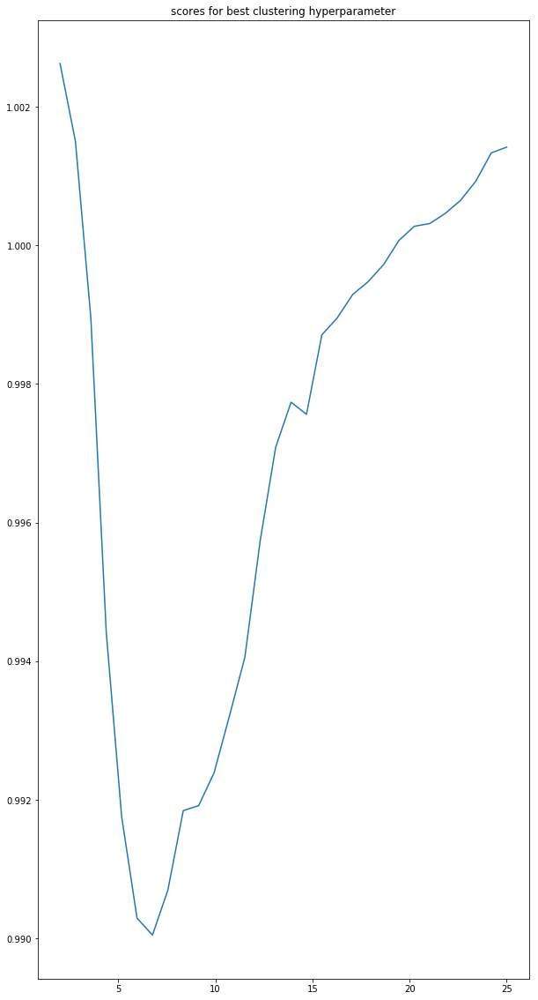

 the best value is : 6.75862068966
YPR161C
Estimated number of clusters using DBscan: 1
silhouette_score 0.187925913328
cal_hara 96.014588348
avg phylo dist of the clusters: [ 0.97665933  0.99119306]
-----------------------------
YOL138C
Estimated number of clusters using DBscan: 3
silhouette_score -0.129347966247
cal_hara 23.5138837033
avg phylo dist of the clusters: [ 0.97584049  1.01214836  0.82647029  0.34198771]
-----------------------------
YDR395W
Estimated number of clusters using DBscan: 3
silhouette_score -0.128050412345
cal_hara 13.7628145787
avg phylo dist of the clusters: [ 1.0034808   0.49261714  0.88270682  0.5662266 ]
-----------------------------
YPR098C
Estimated number of clusters using DBscan: 1
silhouette_score 0.465512795283
cal_hara 158.69769133
avg phylo dist of the clusters: [ 0.97838628  1.00088945]
-----------------------------
YPL015C
Estimated number of clusters using DBscan: 2
silhouette_score 0.0781510243021
cal_hara 93.524622481
avg phylo dist of the clu

avg phylo dist of the clusters: [ 0.96594123  1.00599309]
-----------------------------
YMR113W
Estimated number of clusters using DBscan: 1
silhouette_score 0.309263342834
cal_hara 163.709825583
avg phylo dist of the clusters: [ 0.95074902  1.02224074]
-----------------------------
YCL008C
Estimated number of clusters using DBscan: 1
silhouette_score 0.310849146611
cal_hara 163.388907571
avg phylo dist of the clusters: [ 0.98450663  0.9999173 ]
-----------------------------
YMR296C
Estimated number of clusters using DBscan: 1
silhouette_score 0.0455670793673
cal_hara 74.5716655406
avg phylo dist of the clusters: [ 0.99220856  1.00245999]
-----------------------------
YHR116W
Estimated number of clusters using DBscan: 1
silhouette_score 0.60300287431
cal_hara 22.9904115831
avg phylo dist of the clusters: [ 0.94638723  1.00135201]
-----------------------------
YDR313C
Estimated number of clusters using DBscan: 1
silhouette_score 0.339567554477
cal_hara 113.838616406
avg phylo dist of th

avg phylo dist of the clusters: [ 0.95017261  1.00567592]
-----------------------------
YPL119C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YDL125C
Estimated number of clusters using DBscan: 1
silhouette_score 0.354015023049
cal_hara 31.9135212619
avg phylo dist of the clusters: [ 0.99859172  1.00144411]
-----------------------------
YHR186C
Estimated number of clusters using DBscan: 4
silhouette_score -0.263941344577
cal_hara 7.2972074074
avg phylo dist of the clusters: [ 0.99410352  1.00641686  0.77322271  1.20279088  1.00232573]
-----------------------------
YLL019C
Estimated number of clusters using DBscan: 1
silhouette_score 0.0864059762627
cal_hara 79.3145414744
avg phylo dist of the clusters: [ 0.97424999  1.03996299]
-----------------------------
YJR092W
Estimated number of clusters using DBscan: 1
silhouette_score -0.0926830131153
cal_hara 25.8592572165
avg phylo dist of the clus

Estimated number of clusters using DBscan: 1
silhouette_score 0.298438373963
cal_hara 156.948173528
avg phylo dist of the clusters: [ 0.96753168  1.01311278]
-----------------------------
YOL008W
Estimated number of clusters using DBscan: 1
silhouette_score 0.421274337415
cal_hara 161.560429044
avg phylo dist of the clusters: [ 0.91129821  1.01636274]
-----------------------------
YMR095C
Estimated number of clusters using DBscan: 1
silhouette_score 0.384735336283
cal_hara 185.632192653
avg phylo dist of the clusters: [ 0.96125608  1.00014793]
-----------------------------
YHR198C
Estimated number of clusters using DBscan: 1
silhouette_score 0.176323492506
cal_hara 117.163319416
avg phylo dist of the clusters: [ 0.97377043  1.01104653]
-----------------------------
YNL219C
Estimated number of clusters using DBscan: 1
silhouette_score 0.145277247179
cal_hara 118.641775182
avg phylo dist of the clusters: [ 0.98672805  0.95512755]
-----------------------------
YLR210W
Estimated number of 

avg phylo dist of the clusters: [ 0.96833018  0.99889529  0.65356121  0.26945067  1.20392854]
-----------------------------
YNR031C
Estimated number of clusters using DBscan: 3
silhouette_score -0.323009956461
cal_hara 2.79265524521
avg phylo dist of the clusters: [ 0.99629658  0.78465598  0.34364495]
-----------------------------
YHR084W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0372840650315
cal_hara 47.4674709282
avg phylo dist of the clusters: [ 0.98806309  0.98867972]
-----------------------------
YOR004W
Estimated number of clusters using DBscan: 1
silhouette_score 0.290884714878
cal_hara 114.906138224
avg phylo dist of the clusters: [ 0.9385773   1.01670713]
-----------------------------
YMR233W
Estimated number of clusters using DBscan: 1
silhouette_score 0.32449350805
cal_hara 121.554009958
avg phylo dist of the clusters: [ 0.9721353   1.00333043]
-----------------------------
YLL010C
Estimated number of clusters using DBscan: 1
silhouette_score 0.245929

avg phylo dist of the clusters: [ 0.98538346  1.02321711  0.65130326]
-----------------------------
YGL125W
Estimated number of clusters using DBscan: 2
silhouette_score -0.14545746203
cal_hara 29.2325933224
avg phylo dist of the clusters: [ 0.9974428   0.98891827  0.17391528]
-----------------------------
YKR038C
Estimated number of clusters using DBscan: 1
silhouette_score 0.281511720988
cal_hara 223.979943407
avg phylo dist of the clusters: [ 0.97160651  1.00793414]
-----------------------------
YDL215C
Estimated number of clusters using DBscan: 1
silhouette_score 0.0356495697472
cal_hara 13.79630414
avg phylo dist of the clusters: [ 0.99921293  0.5583987 ]
-----------------------------
YLR354C
Estimated number of clusters using DBscan: 5
silhouette_score -0.255713196637
cal_hara 10.0647685643
avg phylo dist of the clusters: [ 0.99494349  0.80741621  0.96775418  0.61967354  1.08800766  0.51537205]
-----------------------------
YDR284C
Estimated number of clusters using DBscan: 1
sil

Estimated number of clusters using DBscan: 1
silhouette_score 0.183431783631
cal_hara 136.494608406
avg phylo dist of the clusters: [ 0.96360842  1.01221853]
-----------------------------
YKL006W
Estimated number of clusters using DBscan: 1
silhouette_score 0.192660597689
cal_hara 13.6246330651
avg phylo dist of the clusters: [ 0.95933395  1.00182152]
-----------------------------
YDR448W
Estimated number of clusters using DBscan: 1
silhouette_score 0.201907680192
cal_hara 106.660097353
avg phylo dist of the clusters: [ 0.96363603  1.01278075]
-----------------------------
YDR097C
Estimated number of clusters using DBscan: 5
silhouette_score -0.253178124246
cal_hara 5.72818494296
avg phylo dist of the clusters: [ 0.99574476  0.86074794  1.10841598  0.97199555  0.34105107]
-----------------------------
YKL095W
Estimated number of clusters using DBscan: 1
silhouette_score 0.337403456154
cal_hara 203.009495674
avg phylo dist of the clusters: [ 0.94427796  1.01762794]
---------------------

avg phylo dist of the clusters: [ 0.9674208   1.01310268  0.3407276 ]
-----------------------------
YDR505C
Estimated number of clusters using DBscan: 2
silhouette_score -0.096426197014
cal_hara 32.4837987567
avg phylo dist of the clusters: [ 0.99620293  1.01946838  0.75909497]
-----------------------------
YMR211W
Estimated number of clusters using DBscan: 1
silhouette_score 0.339473254711
cal_hara 166.700601915
avg phylo dist of the clusters: [ 0.954001    1.01305525]
-----------------------------
YBL036C
Estimated number of clusters using DBscan: 1
silhouette_score 0.305781590495
cal_hara 165.034889131
avg phylo dist of the clusters: [ 0.96956771  1.01309061]
-----------------------------
YOL147C
Estimated number of clusters using DBscan: 2
silhouette_score 0.14383714088
cal_hara 134.955981353
avg phylo dist of the clusters: [ 0.97008362  1.02213436  1.06410528]
-----------------------------
YPR178W
Estimated number of clusters using DBscan: 1
silhouette_score 0.221129416907
cal_har

avg phylo dist of the clusters: [ 0.98129293  1.00667353]
-----------------------------
YLR089C
Estimated number of clusters using DBscan: 1
silhouette_score 0.0229219731846
cal_hara 70.5062244628
avg phylo dist of the clusters: [ 0.9932454  0.971956 ]
-----------------------------
YKL155C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0343853689818
cal_hara 39.9614102316
avg phylo dist of the clusters: [ 0.97345683  0.96700516  0.62512395]
-----------------------------
YGR154C
Estimated number of clusters using DBscan: 1
silhouette_score 0.197922042025
cal_hara 98.1219872322
avg phylo dist of the clusters: [ 0.98568713  1.00330228]
-----------------------------
YNL277W
Estimated number of clusters using DBscan: 2
silhouette_score 0.0185575126495
cal_hara 69.5579636073
avg phylo dist of the clusters: [ 0.98749759  1.00976748  0.70781732]
-----------------------------
YDL014W
Estimated number of clusters using DBscan: 6
silhouette_score -0.200386194654
cal_hara 27.8699

avg phylo dist of the clusters: [ 0.98536481  1.00256914  0.57213744]
-----------------------------
YKL139W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0387473782677
cal_hara 33.1805884444
avg phylo dist of the clusters: [ 0.96779408  1.01435918  0.65072154]
-----------------------------
YHR129C
Estimated number of clusters using DBscan: 3
silhouette_score -0.0093551343199
cal_hara 45.5738794926
avg phylo dist of the clusters: [ 0.97880749  1.00799327  0.17193518  0.94564346]
-----------------------------
YDL029W
Estimated number of clusters using DBscan: 4
silhouette_score -0.11187059923
cal_hara 28.1889436787
avg phylo dist of the clusters: [ 0.99154057  0.98548734  0.75472137  0.22969781  0.63987247]
-----------------------------
YOR132W
Estimated number of clusters using DBscan: 1
silhouette_score 0.207932197803
cal_hara 128.829929967
avg phylo dist of the clusters: [ 0.9663024   1.02461989]
-----------------------------
YDR525W-A
Estimated number of clusters u

avg phylo dist of the clusters: [ 0.97278944  1.00899455  0.97546456]
-----------------------------
YOR244W
Estimated number of clusters using DBscan: 1
silhouette_score 0.170063571766
cal_hara 105.120062625
avg phylo dist of the clusters: [ 0.97301941  1.02659352]
-----------------------------
YMR314W
Estimated number of clusters using DBscan: 2
silhouette_score 0.0848508993419
cal_hara 103.462315775
avg phylo dist of the clusters: [ 0.97654373  1.01013334  0.16994124]
-----------------------------
YHR190W
Estimated number of clusters using DBscan: 1
silhouette_score 0.0904543851023
cal_hara 110.698759893
avg phylo dist of the clusters: [ 0.99622459  1.01519471]
-----------------------------
YPL097W
Estimated number of clusters using DBscan: 1
silhouette_score 0.195732524455
cal_hara 146.166344108
avg phylo dist of the clusters: [ 0.97230234  0.99071462]
-----------------------------
YLR103C
Estimated number of clusters using DBscan: 1
silhouette_score 0.113733620475
cal_hara 100.4819

avg phylo dist of the clusters: [ 0.97929038  1.00467932]
-----------------------------
YDR092W
Estimated number of clusters using DBscan: 1
silhouette_score 0.368868481806
cal_hara 25.8141806299
avg phylo dist of the clusters: [ 0.99561961  1.00120387]
-----------------------------
YJL053W
Estimated number of clusters using DBscan: 3
silhouette_score 0.0924222385099
cal_hara 69.3732939165
avg phylo dist of the clusters: [ 0.93742409  1.00401272  0.26959315  1.03248441]
-----------------------------
YJL167W
Estimated number of clusters using DBscan: 4
silhouette_score -0.155271954467
cal_hara 38.2137848437
avg phylo dist of the clusters: [ 0.99445556  0.9946749   0.21678506]
-----------------------------
YIL097W
Estimated number of clusters using DBscan: 1
silhouette_score 0.318361875075
cal_hara 212.775063161
avg phylo dist of the clusters: [ 0.95255602  1.00975341]
-----------------------------
YOR198C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0425733918203
cal

avg phylo dist of the clusters: [ 0.9919663   0.91229795  0.58246859]
-----------------------------
YPL266W
Estimated number of clusters using DBscan: 1
silhouette_score 0.177752658484
cal_hara 128.286226064
avg phylo dist of the clusters: [ 0.96446239  1.00681185]
-----------------------------
YPL279C
Estimated number of clusters using DBscan: 1
silhouette_score 0.356816962698
cal_hara 229.530695932
avg phylo dist of the clusters: [ 0.97642666  1.00184492]
-----------------------------
YPL264C
Estimated number of clusters using DBscan: 2
silhouette_score 0.0592121948527
cal_hara 126.408055941
avg phylo dist of the clusters: [ 0.96930967  1.0308425   0.97017435]
-----------------------------
YHR132C
Estimated number of clusters using DBscan: 1
silhouette_score 0.182934138981
cal_hara 114.46897313
avg phylo dist of the clusters: [ 0.94953659  1.0470488 ]
-----------------------------
YLR336C
Estimated number of clusters using DBscan: 1
silhouette_score 0.0953554201243
cal_hara 92.024603

avg phylo dist of the clusters: [ 0.96884183  1.01218972]
-----------------------------
YBR159W
Estimated number of clusters using DBscan: 4
silhouette_score -0.0760063168793
cal_hara 43.3985203674
avg phylo dist of the clusters: [ 0.99963666  0.97202566  0.17076652  0.56922173  1.05875243]
-----------------------------
YGR158C
Estimated number of clusters using DBscan: 1
silhouette_score 0.429854423062
cal_hara 130.000633586
avg phylo dist of the clusters: [ 0.92759379  1.00984476]
-----------------------------
YOR210W
Estimated number of clusters using DBscan: 1
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YLR058C
Estimated number of clusters using DBscan: 1
silhouette_score -0.136710340268
cal_hara 3.64246827869
avg phylo dist of the clusters: [ 0.99875371  0.79933923]
-----------------------------
YLR403W
Estimated number of clusters using DBscan: 2
silhouette_score 0.0267119950109
cal_hara 48.3932072634
avg phylo dist of the clu

avg phylo dist of the clusters: [ 0.96889702  1.01771511]
-----------------------------
YML004C
Estimated number of clusters using DBscan: 1
silhouette_score 0.261643237833
cal_hara 175.687933725
avg phylo dist of the clusters: [ 0.94794954  1.01154624]
-----------------------------
YDR108W
Estimated number of clusters using DBscan: 1
silhouette_score 0.155941631444
cal_hara 84.2662499568
avg phylo dist of the clusters: [ 0.96550234  1.01403059]
-----------------------------
YMR202W
Estimated number of clusters using DBscan: 2
silhouette_score 0.167757965627
cal_hara 100.096181051
avg phylo dist of the clusters: [ 0.96726609  0.99910197]
-----------------------------
YEL029C
Estimated number of clusters using DBscan: 1
silhouette_score 0.271453908731
cal_hara 167.451780865
avg phylo dist of the clusters: [ 0.97645845  1.00895068]
-----------------------------
YNL267W
Estimated number of clusters using DBscan: 1
silhouette_score -0.057099066279
cal_hara 43.1439241448
avg phylo dist of t

avg phylo dist of the clusters: [ 0.98290316  1.02554602  0.81596204]
-----------------------------
YOL068C
Estimated number of clusters using DBscan: 1
silhouette_score 0.188696780906
cal_hara 138.689144218
avg phylo dist of the clusters: [ 0.97177708  0.98652004]
-----------------------------
YDR267C
Estimated number of clusters using DBscan: 1
silhouette_score 0.295215913839
cal_hara 118.587387804
avg phylo dist of the clusters: [ 0.9555929   1.01463717]
-----------------------------
YLR248W
Estimated number of clusters using DBscan: 1
silhouette_score 0.0291149366592
cal_hara 64.5208939254
avg phylo dist of the clusters: [ 0.99138875  0.99639155]
-----------------------------
YIL020C
Estimated number of clusters using DBscan: 1
silhouette_score 0.388487866816
cal_hara 193.998065958
avg phylo dist of the clusters: [ 0.92809402  1.01716664]
-----------------------------
YNL063W
Estimated number of clusters using DBscan: 1
silhouette_score 0.427628561886
cal_hara 159.639279689
avg phy

avg phylo dist of the clusters: [ 0.96868461  1.02297317  0.74575013]
-----------------------------
YDR044W
Estimated number of clusters using DBscan: 1
silhouette_score 0.181927341212
cal_hara 160.35992288
avg phylo dist of the clusters: [ 0.99043472  1.00446696]
-----------------------------
YLR118C
Estimated number of clusters using DBscan: 1
silhouette_score 0.357470234118
cal_hara 201.22304404
avg phylo dist of the clusters: [ 0.94410598  1.00924089]
-----------------------------
YAR073W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0766661000152
cal_hara 19.1476761599
avg phylo dist of the clusters: [ 1.00077783  1.00552405]
-----------------------------
YOL130W
Estimated number of clusters using DBscan: 2
silhouette_score -0.130549790323
cal_hara 25.9653510589
avg phylo dist of the clusters: [ 0.99359898  0.99243687  0.34863122]
-----------------------------
YER178W
Estimated number of clusters using DBscan: 3
silhouette_score -0.116832265117
cal_hara 28.78850

avg phylo dist of the clusters: [ 0.93396761  1.00216014]
-----------------------------
YGL158W
Estimated number of clusters using DBscan: 1
silhouette_score 0.0327106062165
cal_hara 62.8673644269
avg phylo dist of the clusters: [ 0.98890363  0.99863166]
-----------------------------
YLR348C
Estimated number of clusters using DBscan: 1
silhouette_score 0.35238074143
cal_hara 275.220236191
avg phylo dist of the clusters: [ 0.95701906  1.02253363]
-----------------------------
YGR186W
Estimated number of clusters using DBscan: 3
silhouette_score -0.103051796902
cal_hara 33.2052488468
avg phylo dist of the clusters: [ 0.97682808  1.01065505  0.64817825  1.13574595]
-----------------------------
YDR099W
Estimated number of clusters using DBscan: 5
silhouette_score -0.0549211202514
cal_hara 39.1580825258
avg phylo dist of the clusters: [ 0.99152591  0.93154931  0.96036317  0.5968791   0.91578308  1.25060383]
-----------------------------
YNL278W
Estimated number of clusters using DBscan: 2


silhouette_score 0.452037691076
cal_hara 303.578689832
avg phylo dist of the clusters: [ 0.95311661  1.01191558]
-----------------------------
YFR021W
Estimated number of clusters using DBscan: 1
silhouette_score 0.315486444208
cal_hara 174.225150252
avg phylo dist of the clusters: [ 0.9603591   1.02050203]
-----------------------------
YML121W
Estimated number of clusters using DBscan: 3
silhouette_score 0.0300263393965
cal_hara 62.3950524223
avg phylo dist of the clusters: [ 0.96386709  1.01470445  0.78026896  0.62085476]
-----------------------------
YLR310C
Estimated number of clusters using DBscan: 4
silhouette_score -0.176840525737
cal_hara 18.1896396691
avg phylo dist of the clusters: [ 0.9869265   1.01913098  0.57154635  0.34292781]
-----------------------------
YGR087C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0189314164691
cal_hara 154.836582351
avg phylo dist of the clusters: [ 0.98829128  0.97985537  0.34444698]
-----------------------------
YGR244C
E

avg phylo dist of the clusters: [ 0.96026384  1.01050442]
-----------------------------
YER016W
Estimated number of clusters using DBscan: 1
silhouette_score 0.25303241753
cal_hara 99.2724535903
avg phylo dist of the clusters: [ 0.93272182  1.01983876]
-----------------------------
YNL242W
Estimated number of clusters using DBscan: 2
silhouette_score -0.275897613206
cal_hara 8.44601141444
avg phylo dist of the clusters: [ 0.99983843  0.98722486  1.20278978]
-----------------------------
YMR058W
Estimated number of clusters using DBscan: 1
silhouette_score 0.0248541688727
cal_hara 95.6339742596
avg phylo dist of the clusters: [ 0.99380464  1.0141786 ]
-----------------------------
YNL297C
Estimated number of clusters using DBscan: 1
silhouette_score 0.000393233049138
cal_hara 64.5191774437
avg phylo dist of the clusters: [ 0.98499858  0.98233545]
-----------------------------
YOL078W
Estimated number of clusters using DBscan: 1
silhouette_score 0.106173056554
cal_hara 87.1691217314
avg 

avg phylo dist of the clusters: [ 0.99010925  0.94399034]
-----------------------------
YDR311W
Estimated number of clusters using DBscan: 1
silhouette_score 0.202536902341
cal_hara 138.732967553
avg phylo dist of the clusters: [ 0.97786707  1.0158781 ]
-----------------------------
YKL088W
Estimated number of clusters using DBscan: 1
silhouette_score 0.468028060207
cal_hara 225.558832413
avg phylo dist of the clusters: [ 0.96650893  1.01054612]
-----------------------------
YJL046W
Estimated number of clusters using DBscan: 1
silhouette_score 0.294956273618
cal_hara 163.556959207
avg phylo dist of the clusters: [ 0.97017804  1.00552354]
-----------------------------
YKL056C
Estimated number of clusters using DBscan: 1
silhouette_score 0.105687637458
cal_hara 20.1027748542
avg phylo dist of the clusters: [ 0.96545279  1.01314682]
-----------------------------
YPL037C
Estimated number of clusters using DBscan: 2
silhouette_score 0.0373219750552
cal_hara 26.1382014438
avg phylo dist of t

avg phylo dist of the clusters: [ 0.97460468  0.99834635  0.33944404]
-----------------------------
YGL055W
Estimated number of clusters using DBscan: 2
silhouette_score 0.0209931209861
cal_hara 133.062171215
avg phylo dist of the clusters: [ 0.98497923  0.97812774  1.03163162]
-----------------------------
YBR288C
Estimated number of clusters using DBscan: 1
silhouette_score 0.248143076959
cal_hara 151.838713093
avg phylo dist of the clusters: [ 0.95459808  1.02200344]
-----------------------------
YOL055C
Estimated number of clusters using DBscan: 1
silhouette_score 0.257356816462
cal_hara 163.383627206
avg phylo dist of the clusters: [ 0.98049242  1.0081362 ]
-----------------------------
YOR347C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YGL065C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0157484246045
cal_hara 71.9566640105
avg phylo dist of the clusters: [ 0.99

silhouette_score -0.0994458346765
cal_hara 35.5478617799
avg phylo dist of the clusters: [ 0.96936224  1.03572146  0.34494686]
-----------------------------
YBR026C
Estimated number of clusters using DBscan: 3
silhouette_score 0.0162753905829
cal_hara 54.9228431797
avg phylo dist of the clusters: [ 1.00057779  0.97990882  0.68115579  0.98234154]
-----------------------------
YLR143W
Estimated number of clusters using DBscan: 1
silhouette_score 0.17032371706
cal_hara 114.495175668
avg phylo dist of the clusters: [ 0.96046475  1.01098971]
-----------------------------
YMR125W
Estimated number of clusters using DBscan: 2
silhouette_score -0.12973565696
cal_hara 30.8764577681
avg phylo dist of the clusters: [ 0.98713566  0.94292443  0.44683928]
-----------------------------
YLR126C
Estimated number of clusters using DBscan: 2
silhouette_score 0.224796133524
cal_hara 128.226786178
avg phylo dist of the clusters: [ 0.98049833  1.00069005  0.34134258]
-----------------------------
YGL086W
Est

avg phylo dist of the clusters: [ 0.99136019  0.99609756  0.64433709]
-----------------------------
YMR290C
Estimated number of clusters using DBscan: 3
silhouette_score -0.133525331903
cal_hara 21.318219411
avg phylo dist of the clusters: [ 0.98927547  0.91183283  0.85632408]
-----------------------------
YDR452W
Estimated number of clusters using DBscan: 1
silhouette_score 0.106629901536
cal_hara 92.8263154649
avg phylo dist of the clusters: [ 0.98509274  1.00697097]
-----------------------------
YPL211W
Estimated number of clusters using DBscan: 2
silhouette_score 0.301770786885
cal_hara 70.1943821961
avg phylo dist of the clusters: [ 0.99392926  0.99877383  0.96384685]
-----------------------------
YBR074W
Estimated number of clusters using DBscan: 2
silhouette_score -0.15627095964
cal_hara 30.3750364507
avg phylo dist of the clusters: [ 0.98635431  1.02942721  0.9420395 ]
-----------------------------
YAL038W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara

avg phylo dist of the clusters: [ 0.98105944  0.99292992  0.81697151  0.57331334]
-----------------------------
YDR246W
Estimated number of clusters using DBscan: 1
silhouette_score 0.390129249263
cal_hara 61.3027890442
avg phylo dist of the clusters: [ 0.96037228  1.0005355 ]
-----------------------------
YLR187W
Estimated number of clusters using DBscan: 2
silhouette_score -0.175318570389
cal_hara 21.1014590878
avg phylo dist of the clusters: [ 0.99740889  0.90533202  0.34363473]
-----------------------------
YER182W
Estimated number of clusters using DBscan: 1
silhouette_score 0.306089725947
cal_hara 119.012654953
avg phylo dist of the clusters: [ 0.97536399  1.01041756]
-----------------------------
YMR137C
Estimated number of clusters using DBscan: 2
silhouette_score 0.0706299486984
cal_hara 56.1323281254
avg phylo dist of the clusters: [ 0.97740102  1.00983486  0.53062836]
-----------------------------
YNL163C
Estimated number of clusters using DBscan: 2
silhouette_score -0.13445

avg phylo dist of the clusters: [ 0.96989006  1.01270329]
-----------------------------
YGL163C
Estimated number of clusters using DBscan: 1
silhouette_score 0.14676056927
cal_hara 113.320892159
avg phylo dist of the clusters: [ 0.96750001  1.00037608]
-----------------------------
YMR139W
Estimated number of clusters using DBscan: 2
silhouette_score 0.0576248671251
cal_hara 52.6268022965
avg phylo dist of the clusters: [ 0.99324249  0.99706167  1.13485508]
-----------------------------
YJL128C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0122403451441
cal_hara 51.3434650998
avg phylo dist of the clusters: [ 0.96152789  1.01677223  0.57179096]
-----------------------------
YDL217C
Estimated number of clusters using DBscan: 1
silhouette_score 0.369444905157
cal_hara 80.2557799633
avg phylo dist of the clusters: [ 0.95847383  1.00625027]
-----------------------------
YJR002W
Estimated number of clusters using DBscan: 2
silhouette_score -0.00584578019346
cal_hara 53.87

avg phylo dist of the clusters: [ 0.9880677   1.01206437]
-----------------------------
YOR269W
Estimated number of clusters using DBscan: 1
silhouette_score 0.315372750026
cal_hara 183.871774384
avg phylo dist of the clusters: [ 0.94530767  1.01916902]
-----------------------------
YDR500C
Estimated number of clusters using DBscan: 1
silhouette_score 0.596139868046
cal_hara 42.802426115
avg phylo dist of the clusters: [ 0.87295517  1.00029411]
-----------------------------
YML125C
Estimated number of clusters using DBscan: 3
silhouette_score -0.00982794360654
cal_hara 50.2857559576
avg phylo dist of the clusters: [ 0.99384843  1.01049609  0.27472178  0.61935044]
-----------------------------
YML069W
Estimated number of clusters using DBscan: 2
silhouette_score -0.108113521135
cal_hara 41.2958176474
avg phylo dist of the clusters: [ 0.9889966   1.00467803  0.33829777]
-----------------------------
YOL057W
Estimated number of clusters using DBscan: 1
silhouette_score 0.195268572094
cal_

avg phylo dist of the clusters: [ 0.98224355  0.99843245]
-----------------------------
YOR286W
Estimated number of clusters using DBscan: 1
silhouette_score 0.363173563074
cal_hara 109.472628678
avg phylo dist of the clusters: [ 0.98527064  1.00446291]
-----------------------------
YNL010W
Estimated number of clusters using DBscan: 2
silhouette_score 0.0943666558971
cal_hara 93.2694502635
avg phylo dist of the clusters: [ 0.97272335  1.00820801  0.22870368]
-----------------------------
YLR388W
Estimated number of clusters using DBscan: 1
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YNL079C
Estimated number of clusters using DBscan: 1
silhouette_score 0.357421355492
cal_hara 120.158261905
avg phylo dist of the clusters: [ 0.95543171  1.00501626]
-----------------------------
YHR104W
Estimated number of clusters using DBscan: 3
silhouette_score 0.0413962261399
cal_hara 81.151295505
avg phylo dist of the clusters: [ 0.981768    1.0130

silhouette_score -0.038955655599
cal_hara 13.1136922086
avg phylo dist of the clusters: [ 1.          0.75761167]
-----------------------------
YNL024C
Estimated number of clusters using DBscan: 1
silhouette_score 0.472667635335
cal_hara 158.695398708
avg phylo dist of the clusters: [ 1.00442508  0.99531494]
-----------------------------
YOR070C
Estimated number of clusters using DBscan: 1
silhouette_score 0.343058200449
cal_hara 212.24396047
avg phylo dist of the clusters: [ 0.95545062  1.01541327]
-----------------------------
YGL093W
Estimated number of clusters using DBscan: 2
silhouette_score -0.160066124977
cal_hara 20.9412836052
avg phylo dist of the clusters: [ 0.97209376  1.04163419  0.58847382]
-----------------------------
YDR523C
Estimated number of clusters using DBscan: 4
silhouette_score -0.0462055730368
cal_hara 22.8904281136
avg phylo dist of the clusters: [ 0.97099722  0.9929575   0.70031173  1.03324682  1.29155852]
-----------------------------
YHL017W
Estimated numb

Estimated number of clusters using DBscan: 2
silhouette_score 0.0191754643513
cal_hara 73.0385932993
avg phylo dist of the clusters: [ 0.96902894  1.02373261]
-----------------------------
YNL290W
Estimated number of clusters using DBscan: 1
silhouette_score 0.260262958489
cal_hara 189.506086755
avg phylo dist of the clusters: [ 0.97031166  1.01172553]
-----------------------------
YMR132C
Estimated number of clusters using DBscan: 1
silhouette_score 0.358557123115
cal_hara 120.88102592
avg phylo dist of the clusters: [ 0.95860567  1.00473745]
-----------------------------
YDR358W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0898563785236
cal_hara 51.5443831195
avg phylo dist of the clusters: [ 0.98910716  0.99962114  0.75628722]
-----------------------------
YBR010W
Estimated number of clusters using DBscan: 1
silhouette_score 0.100907773932
cal_hara 4.95391894461
avg phylo dist of the clusters: [ 0.97377368  0.99810217]
-----------------------------
YGL085W
Estima

avg phylo dist of the clusters: [ 0.96005111  1.01114799]
-----------------------------
YDR287W
Estimated number of clusters using DBscan: 1
silhouette_score 0.323608098566
cal_hara 231.352915076
avg phylo dist of the clusters: [ 0.95816721  1.00844482]
-----------------------------
YPR111W
Estimated number of clusters using DBscan: 2
silhouette_score -0.104918517903
cal_hara 30.9164916234
avg phylo dist of the clusters: [ 0.98525908  0.97496182  0.62718856]
-----------------------------
YMR002W
Estimated number of clusters using DBscan: 2
silhouette_score 0.30995754599
cal_hara 48.3406603163
avg phylo dist of the clusters: [ 1.01409581  1.00165957  1.36651209]
-----------------------------
YDR122W
Estimated number of clusters using DBscan: 2
silhouette_score -0.165185315927
cal_hara 19.3989377759
avg phylo dist of the clusters: [ 0.98822062  0.93254446  1.07149892]
-----------------------------
YOR296W
Estimated number of clusters using DBscan: 2
silhouette_score -0.179558162071
cal_h

avg phylo dist of the clusters: [ 0.95789405  1.01033622]
-----------------------------
YDR270W
Estimated number of clusters using DBscan: 3
silhouette_score -0.284530584669
cal_hara 5.17442448226
avg phylo dist of the clusters: [ 0.99871626  1.01037137  1.12126578  0.73313532]
-----------------------------
YIL026C
Estimated number of clusters using DBscan: 3
silhouette_score -0.235319533329
cal_hara 11.9992049973
avg phylo dist of the clusters: [ 0.99266314  0.89267963  0.79589935  1.13699907]
-----------------------------
YGR009C
Estimated number of clusters using DBscan: 1
silhouette_score 0.187447509562
cal_hara 95.3521336848
avg phylo dist of the clusters: [ 0.971901    1.01465681]
-----------------------------
YGL122C
Estimated number of clusters using DBscan: 1
silhouette_score 0.163241374934
cal_hara 88.3894569499
avg phylo dist of the clusters: [ 0.96612403  1.01549773]
-----------------------------
YEL013W
Estimated number of clusters using DBscan: 1
silhouette_score 0.096304

avg phylo dist of the clusters: [ 0.99875009  1.05670335]
-----------------------------
YDL124W
Estimated number of clusters using DBscan: 2
silhouette_score 0.196151367864
cal_hara 170.386466405
avg phylo dist of the clusters: [ 0.97948475  1.01219259  0.46684594]
-----------------------------
YDR268W
Estimated number of clusters using DBscan: 1
silhouette_score 0.381896584702
cal_hara 195.982229013
avg phylo dist of the clusters: [ 0.95750085  1.01236521]
-----------------------------
YIL138C
Estimated number of clusters using DBscan: 3
silhouette_score 0.245636343482
cal_hara 46.1293557397
avg phylo dist of the clusters: [ 0.97865983  1.00198123  1.02954271]
-----------------------------
YER091C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YOL064C
Estimated number of clusters using DBscan: 2
silhouette_score 0.0532621616942
cal_hara 122.502831352
avg phylo dist of the clusters: [ 0.9901

silhouette_score 0.173971007003
cal_hara 136.402387578
avg phylo dist of the clusters: [ 0.99166902  1.00152557]
-----------------------------
YMR035W
Estimated number of clusters using DBscan: 1
silhouette_score 0.406979804176
cal_hara 105.82647644
avg phylo dist of the clusters: [ 1.01631879  0.99762441]
-----------------------------
YPL181W
Estimated number of clusters using DBscan: 1
silhouette_score 0.213392928299
cal_hara 96.5106278665
avg phylo dist of the clusters: [ 0.96434141  1.01838573]
-----------------------------
YOR211C
Estimated number of clusters using DBscan: 2
silhouette_score -0.111889111507
cal_hara 38.149105569
avg phylo dist of the clusters: [ 0.98563535  0.98778735  1.07991031]
-----------------------------
YGL084C
Estimated number of clusters using DBscan: 3
silhouette_score -0.0414416287655
cal_hara 49.778934132
avg phylo dist of the clusters: [ 0.98175114  1.00924437  0.72316739]
-----------------------------
YGR118W
Estimated number of clusters using DBscan

avg phylo dist of the clusters: [ 0.9577215   1.00707134]
-----------------------------
YGL027C
Estimated number of clusters using DBscan: 1
silhouette_score 0.0374771696118
cal_hara 79.6124502965
avg phylo dist of the clusters: [ 0.98955174  0.98913576]
-----------------------------
YMR286W
Estimated number of clusters using DBscan: 1
silhouette_score 0.424519784259
cal_hara 18.2570274444
avg phylo dist of the clusters: [ 0.8600823   1.00157016]
-----------------------------
YDL036C
Estimated number of clusters using DBscan: 2
silhouette_score 0.0541382383115
cal_hara 59.0079433008
avg phylo dist of the clusters: [ 0.97561443  1.01697544  0.57500672]
-----------------------------
YLR107W
Estimated number of clusters using DBscan: 1
silhouette_score 0.211179869476
cal_hara 112.573024788
avg phylo dist of the clusters: [ 0.97911696  0.9983045 ]
-----------------------------
YER166W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters:

avg phylo dist of the clusters: [ 0.98787078  0.97399408  1.03405664]
-----------------------------
YHR040W
Estimated number of clusters using DBscan: 1
silhouette_score 0.350912025976
cal_hara 137.613827092
avg phylo dist of the clusters: [ 0.95069474  1.0132719 ]
-----------------------------
YLR096W
Estimated number of clusters using DBscan: 2
silhouette_score -0.165673639404
cal_hara 19.6423092077
avg phylo dist of the clusters: [ 0.98822062  0.93254446  1.07149892]
-----------------------------
YEL060C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YDL240W
Estimated number of clusters using DBscan: 2
silhouette_score -0.263433685315
cal_hara 12.7886865944
avg phylo dist of the clusters: [ 0.98865823  1.04716084  0.17184693]
-----------------------------
YDL226C
Estimated number of clusters using DBscan: 1
silhouette_score 0.17683478183
cal_hara 110.948724338
avg phylo dist of the cluste

Estimated number of clusters using DBscan: 3
silhouette_score -0.18516510379
cal_hara 13.8620926282
avg phylo dist of the clusters: [ 0.99455662  0.99871184  1.02339369  0.57310047]
-----------------------------
YMR307W
Estimated number of clusters using DBscan: 1
silhouette_score 0.0228259723936
cal_hara 78.4709750959
avg phylo dist of the clusters: [ 0.98856023  0.97493002]
-----------------------------
YJR131W
Estimated number of clusters using DBscan: 1
silhouette_score 0.2063449327
cal_hara 181.348762685
avg phylo dist of the clusters: [ 0.98377412  1.0050181 ]
-----------------------------
YJL003W
Estimated number of clusters using DBscan: 1
silhouette_score 0.574809777272
cal_hara 68.9285745689
avg phylo dist of the clusters: [ 0.8637279   1.00159116]
-----------------------------
YDR196C
Estimated number of clusters using DBscan: 2
silhouette_score 0.185663688511
cal_hara 86.2211720282
avg phylo dist of the clusters: [ 0.9603676  1.0179112]
-----------------------------
YNL082W

avg phylo dist of the clusters: [ 0.97414221  0.99734485]
-----------------------------
YDR531W
Estimated number of clusters using DBscan: 2
silhouette_score 0.0694971696586
cal_hara 85.2947255715
avg phylo dist of the clusters: [ 0.96305843  1.03542436  0.34455113]
-----------------------------
YKL103C
Estimated number of clusters using DBscan: 2
silhouette_score -0.159163223716
cal_hara 36.1269637194
avg phylo dist of the clusters: [ 0.98063381  0.98145373  0.54005261]
-----------------------------
YLR055C
Estimated number of clusters using DBscan: 1
silhouette_score 0.257701625642
cal_hara 128.24390512
avg phylo dist of the clusters: [ 0.98482504  0.99377817]
-----------------------------
YDR486C
Estimated number of clusters using DBscan: 1
silhouette_score 0.355353934199
cal_hara 173.302226134
avg phylo dist of the clusters: [ 0.96141394  1.00849946]
-----------------------------
YDR377W
Estimated number of clusters using DBscan: 1
silhouette_score 0.320098600153
cal_hara 10.403845

avg phylo dist of the clusters: [ 0.99315792  1.02464018  0.34918141]
-----------------------------
YGR205W
Estimated number of clusters using DBscan: 1
silhouette_score 0.365429146888
cal_hara 195.000415053
avg phylo dist of the clusters: [ 0.97942702  1.00252732]
-----------------------------
YLR188W
Estimated number of clusters using DBscan: 3
silhouette_score -0.169528268739
cal_hara 23.0702527322
avg phylo dist of the clusters: [ 0.98609017  1.00185929  0.60187338  0.34392765]
-----------------------------
YJR066W
Estimated number of clusters using DBscan: 2
silhouette_score -0.170794541043
cal_hara 30.4614154681
avg phylo dist of the clusters: [ 0.99705499  0.79555788  1.08424132]
-----------------------------
YBR121C
Estimated number of clusters using DBscan: 1
silhouette_score 0.0332301786241
cal_hara 73.7119739519
avg phylo dist of the clusters: [ 0.99556488  0.86591108]
-----------------------------
YAL002W
Estimated number of clusters using DBscan: 1
silhouette_score -0.0477

silhouette_score -0.0415324291646
cal_hara 47.5844196776
avg phylo dist of the clusters: [ 0.99942324  0.96707189  0.61805427  1.13085574]
-----------------------------
YLR083C
Estimated number of clusters using DBscan: 3
silhouette_score -0.203468492305
cal_hara 26.3571507577
avg phylo dist of the clusters: [ 0.98062106  1.01671666  1.03145168]
-----------------------------
YGR082W
Estimated number of clusters using DBscan: 1
silhouette_score 0.289458079402
cal_hara 121.490213567
avg phylo dist of the clusters: [ 0.9614193   1.00293466]
-----------------------------
YER004W
Estimated number of clusters using DBscan: 1
silhouette_score 0.424654818587
cal_hara 286.438170246
avg phylo dist of the clusters: [ 0.92205725  1.0148997 ]
-----------------------------
YNL232W
Estimated number of clusters using DBscan: 2
silhouette_score 0.284199074989
cal_hara 62.2382218052
avg phylo dist of the clusters: [ 0.9581269   1.00709165  0.77383502]
-----------------------------
YDR037W
Estimated numb

avg phylo dist of the clusters: [ 0.9801098   0.99391378  0.3391675 ]
-----------------------------
YMR049C
Estimated number of clusters using DBscan: 2
silhouette_score -0.103157054163
cal_hara 46.9552135055
avg phylo dist of the clusters: [ 0.99233859  0.97680921  1.03346071]
-----------------------------
YIL046W
Estimated number of clusters using DBscan: 4
silhouette_score -0.22802272368
cal_hara 12.8908242004
avg phylo dist of the clusters: [ 0.99144631  0.99666529  0.81788603  0.81788603]
-----------------------------
YMR292W
Estimated number of clusters using DBscan: 1
silhouette_score 0.42670492977
cal_hara 26.9056907837
avg phylo dist of the clusters: [ 0.84247559  1.00143034]
-----------------------------
YDR243C
Estimated number of clusters using DBscan: 5
silhouette_score -0.226052780313
cal_hara 11.2463630032
avg phylo dist of the clusters: [ 0.9815881   0.86661266  0.22961532  0.68064541  0.50228351  0.34442298]
-----------------------------
YDL008W
Estimated number of clu

avg phylo dist of the clusters: [ 0.93980522  1.00314117]
-----------------------------
YMR001C
Estimated number of clusters using DBscan: 2
silhouette_score -0.1342956801
cal_hara 33.9223473464
avg phylo dist of the clusters: [ 0.98765445  1.00237351  1.01549901]
-----------------------------
YGL227W
Estimated number of clusters using DBscan: 1
silhouette_score 0.141823569789
cal_hara 82.3432740764
avg phylo dist of the clusters: [ 0.97790074  1.03659148]
-----------------------------
YLR406C
Estimated number of clusters using DBscan: 1
silhouette_score 0.298376963843
cal_hara 8.66674467717
avg phylo dist of the clusters: [ 0.85638876  1.00215022]
-----------------------------
YDR299W
Estimated number of clusters using DBscan: 1
silhouette_score 0.216005591897
cal_hara 141.547249174
avg phylo dist of the clusters: [ 0.97978628  0.99972325]
-----------------------------
YAL003W
Estimated number of clusters using DBscan: 5
silhouette_score 0.00660480166112
cal_hara 48.7619186054
avg phy

avg phylo dist of the clusters: [ 1.00408058  0.56501147  0.16950344  0.98311997]
-----------------------------
YDR328C
Estimated number of clusters using DBscan: 1
silhouette_score 0.289224525461
cal_hara 58.7890938458
avg phylo dist of the clusters: [ 1.00367766  1.00076619]
-----------------------------
YGR021W
Estimated number of clusters using DBscan: 1
silhouette_score 0.403263177833
cal_hara 166.049979801
avg phylo dist of the clusters: [ 0.91206952  1.01684046]
-----------------------------
YPL237W
Estimated number of clusters using DBscan: 4
silhouette_score -0.0610690400903
cal_hara 27.5832362415
avg phylo dist of the clusters: [ 0.97327727  0.92646598  0.63099732  0.52214224  1.01410284]
-----------------------------
YKR056W
Estimated number of clusters using DBscan: 3
silhouette_score -0.0979279556802
cal_hara 26.4247238951
avg phylo dist of the clusters: [ 0.97405844  0.99390682  1.04555182  0.80839509]
-----------------------------
YMR224C
Estimated number of clusters usi

avg phylo dist of the clusters: [ 0.97483984  1.02367188  0.6831578   1.20993008  0.34569431]
-----------------------------
YDL091C
Estimated number of clusters using DBscan: 2
silhouette_score 0.0930609166842
cal_hara 69.2453078212
avg phylo dist of the clusters: [ 0.96916648  1.01098046  0.79992103]
-----------------------------
YJL154C
Estimated number of clusters using DBscan: 1
silhouette_score 0.0371143217355
cal_hara 84.7869524303
avg phylo dist of the clusters: [ 0.99323522  0.96619036]
-----------------------------
YDR074W
Estimated number of clusters using DBscan: 3
silhouette_score -0.174288318453
cal_hara 21.2766439323
avg phylo dist of the clusters: [ 0.99686829  0.95753966  0.57393515  1.11917353]
-----------------------------
YGL142C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0969601836684
cal_hara 56.1593174216
avg phylo dist of the clusters: [ 0.97482395  0.99913148  1.02455782]
-----------------------------
YKL151C
Estimated number of clusters us

avg phylo dist of the clusters: [ 0.98886891  0.95982809]
-----------------------------
YPL184C
Estimated number of clusters using DBscan: 4
silhouette_score -0.189772242351
cal_hara 8.28282929775
avg phylo dist of the clusters: [ 0.99857799  1.02377103  0.40171996  0.94691134]
-----------------------------
YDR492W
Estimated number of clusters using DBscan: 2
silhouette_score 0.19250177514
cal_hara 115.055408635
avg phylo dist of the clusters: [ 0.95749351  1.00836905  0.34292025]
-----------------------------
YER006W
Estimated number of clusters using DBscan: 1
silhouette_score 0.0813374658506
cal_hara 97.4254391074
avg phylo dist of the clusters: [ 0.99153479  0.92890432]
-----------------------------
YOL114C
Estimated number of clusters using DBscan: 1
silhouette_score 0.492169679477
cal_hara 98.2258296955
avg phylo dist of the clusters: [ 0.9113329   1.00275919]
-----------------------------
YNL288W
Estimated number of clusters using DBscan: 1
silhouette_score 0.252941516533
cal_ha

avg phylo dist of the clusters: [ 0.99231573  0.74702638  0.59533327]
-----------------------------
YNL085W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0357132612669
cal_hara 39.0449907976
avg phylo dist of the clusters: [ 0.9890184   0.99523132  0.64967422]
-----------------------------
YDL230W
Estimated number of clusters using DBscan: 1
silhouette_score 0.301907097116
cal_hara 179.834000102
avg phylo dist of the clusters: [ 0.95874358  1.0149125 ]
-----------------------------
YFR025C
Estimated number of clusters using DBscan: 4
silhouette_score 0.0985313078462
cal_hara 57.0605165975
avg phylo dist of the clusters: [ 0.95487184  1.01659373  1.1990488   0.34258537  0.34258537]
-----------------------------
YNL264C
Estimated number of clusters using DBscan: 1
silhouette_score 0.236221912895
cal_hara 171.973640759
avg phylo dist of the clusters: [ 0.9640459   1.01259239]
-----------------------------
YBL038W
Estimated number of clusters using DBscan: 1
silhouette_s

Estimated number of clusters using DBscan: 4
silhouette_score 0.0517041069126
cal_hara 49.4532260885
avg phylo dist of the clusters: [ 0.95636755  0.97695315  0.96894808  0.16946623  1.06763724]
-----------------------------
YML123C
Estimated number of clusters using DBscan: 1
silhouette_score 0.102395696023
cal_hara 63.206409433
avg phylo dist of the clusters: [ 0.99898347  0.68085838]
-----------------------------
YDR280W
Estimated number of clusters using DBscan: 2
silhouette_score 0.12198935546
cal_hara 85.3561270294
avg phylo dist of the clusters: [ 0.95484903  1.01254767]
-----------------------------
YBR191W
Estimated number of clusters using DBscan: 1
silhouette_score 0.13814480123
cal_hara 16.8923762909
avg phylo dist of the clusters: [ 1.03263041  0.99816709]
-----------------------------
YGL083W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0815521038053
cal_hara 40.4522807
avg phylo dist of the clusters: [ 0.97760058  0.99980329  0.42837327]
-------------

silhouette_score 0.4350053783
cal_hara 121.546496755
avg phylo dist of the clusters: [ 0.8701509   1.01249263]
-----------------------------
YGR238C
Estimated number of clusters using DBscan: 3
silhouette_score -0.273307826709
cal_hara 12.7678639619
avg phylo dist of the clusters: [ 0.98897498  1.03513354  1.09186438]
-----------------------------
YGR125W
Estimated number of clusters using DBscan: 4
silhouette_score -0.210499680438
cal_hara 14.4334954158
avg phylo dist of the clusters: [ 0.99079751  0.99476304  0.68152408  0.59633357  1.02228613]
-----------------------------
YNR058W
Estimated number of clusters using DBscan: 1
silhouette_score 0.0613754195847
cal_hara 76.7945830703
avg phylo dist of the clusters: [ 0.98975444  0.99835172]
-----------------------------
YIL051C
Estimated number of clusters using DBscan: 1
silhouette_score 0.320594710993
cal_hara 49.1875501947
avg phylo dist of the clusters: [ 1.03163704  1.00178459]
-----------------------------
YLR059C
Estimated number

avg phylo dist of the clusters: [ 0.97600485  1.01893386]
-----------------------------
YBR037C
Estimated number of clusters using DBscan: 2
silhouette_score 0.189612356132
cal_hara 66.4328583654
avg phylo dist of the clusters: [ 0.95805499  1.02605299  0.61832956]
-----------------------------
YPR145W
Estimated number of clusters using DBscan: 1
silhouette_score 0.0374565750909
cal_hara 43.0961080864
avg phylo dist of the clusters: [ 0.99815577  0.60229018]
-----------------------------
YER133W
Estimated number of clusters using DBscan: 4
silhouette_score -0.0721993537104
cal_hara 25.4585453759
avg phylo dist of the clusters: [ 0.96642381  1.03098165  0.50976909  1.13282021  0.33984606]
-----------------------------
YKR079C
Estimated number of clusters using DBscan: 1
silhouette_score 0.0700450792994
cal_hara 94.0174881868
avg phylo dist of the clusters: [ 0.98630213  0.98127914]
-----------------------------
YOR303W
Estimated number of clusters using DBscan: 1
silhouette_score -0.091

avg phylo dist of the clusters: [ 0.97582733  1.00471599]
-----------------------------
YKR105C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0221154063379
cal_hara 159.875175793
avg phylo dist of the clusters: [ 0.99764689  0.99919444  0.93218315]
-----------------------------
YNL001W
Estimated number of clusters using DBscan: 1
silhouette_score 0.254151111337
cal_hara 156.786768242
avg phylo dist of the clusters: [ 0.97846792  1.00500743]
-----------------------------
YGR094W
Estimated number of clusters using DBscan: 1
silhouette_score -0.0572592980037
cal_hara 22.2389806424
avg phylo dist of the clusters: [ 0.99812225  0.96004877]
-----------------------------
YOL146W
Estimated number of clusters using DBscan: 1
silhouette_score 0.480293847682
cal_hara 164.177362672
avg phylo dist of the clusters: [ 0.97142574  1.00047277]
-----------------------------
YNL098C
Estimated number of clusters using DBscan: 2
silhouette_score 0.252046543383
cal_hara 75.5621788079
avg 

avg phylo dist of the clusters: [ 0.97943708  1.01310463]
-----------------------------
YPR102C
Estimated number of clusters using DBscan: 2
silhouette_score 0.188844875797
cal_hara 68.5857661574
avg phylo dist of the clusters: [ 0.96603315  0.94330198  1.00672556]
-----------------------------
YLR168C
Estimated number of clusters using DBscan: 2
silhouette_score 0.276410137296
cal_hara 119.353730728
avg phylo dist of the clusters: [ 0.92855754  1.00018875  0.43134007]
-----------------------------
YPL123C
Estimated number of clusters using DBscan: 2
silhouette_score 0.147832661019
cal_hara 61.5535370288
avg phylo dist of the clusters: [ 0.96443741  1.02371481  0.34550375]
-----------------------------
YGR159C
Estimated number of clusters using DBscan: 2
silhouette_score -0.251720892082
cal_hara 17.3667027709
avg phylo dist of the clusters: [ 0.99380826  0.69186688  1.05442058]
-----------------------------
YDR325W
Estimated number of clusters using DBscan: 1
silhouette_score 0.0326696

Estimated number of clusters using DBscan: 3
silhouette_score -0.140330400348
cal_hara 38.8500780205
avg phylo dist of the clusters: [ 0.98366152  1.0660361   0.92215567  1.0004519 ]
-----------------------------
YOR212W
Estimated number of clusters using DBscan: 3
silhouette_score -0.000315479937516
cal_hara 47.1348504968
avg phylo dist of the clusters: [ 0.98323889  1.02572193  0.45931699  0.50237796]
-----------------------------
YNL110C
Estimated number of clusters using DBscan: 1
silhouette_score 0.198061475956
cal_hara 180.029972156
avg phylo dist of the clusters: [ 0.98813334  0.96646466]
-----------------------------
YML128C
Estimated number of clusters using DBscan: 1
silhouette_score 0.0255380864533
cal_hara 60.9579257642
avg phylo dist of the clusters: [ 0.99929598  0.99085453]
-----------------------------
YOR001W
Estimated number of clusters using DBscan: 1
silhouette_score 0.000990021781646
cal_hara 59.5363309858
avg phylo dist of the clusters: [ 0.99129568  1.01156797]
-

Estimated number of clusters using DBscan: 2
silhouette_score -0.105222985514
cal_hara 59.1776801719
avg phylo dist of the clusters: [ 0.9806112   1.02762943  0.47553336]
-----------------------------
YJL036W
Estimated number of clusters using DBscan: 1
silhouette_score 0.182516968291
cal_hara 139.223080897
avg phylo dist of the clusters: [ 0.96353922  1.0269268 ]
-----------------------------
YGL114W
Estimated number of clusters using DBscan: 1
silhouette_score 0.209421653676
cal_hara 130.463732216
avg phylo dist of the clusters: [ 0.96872469  1.02085052]
-----------------------------
YOL077C
Estimated number of clusters using DBscan: 2
silhouette_score 0.028044863798
cal_hara 55.8454433792
avg phylo dist of the clusters: [ 0.97516298  1.01547451  0.84776492]
-----------------------------
YPL141C
Estimated number of clusters using DBscan: 5
silhouette_score -0.200500428776
cal_hara 11.3303434923
avg phylo dist of the clusters: [ 0.99036503  0.9244072   1.19943957  1.15660245  0.771068

avg phylo dist of the clusters: [ 0.90641298  1.01500284]
-----------------------------
YJL136C
Estimated number of clusters using DBscan: 1
silhouette_score 0.42135303779
cal_hara 6.23679478342
avg phylo dist of the clusters: [ 1.31687126  0.99745313]
-----------------------------
YAR075W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0769974420864
cal_hara 18.2895753025
avg phylo dist of the clusters: [ 0.99977005  1.03053324]
-----------------------------
YMR140W
Estimated number of clusters using DBscan: 1
silhouette_score 0.241404659452
cal_hara 117.277003786
avg phylo dist of the clusters: [ 0.97779347  1.02048273]
-----------------------------
YLR092W
Estimated number of clusters using DBscan: 2
silhouette_score -0.129018329471
cal_hara 30.5361449636
avg phylo dist of the clusters: [ 0.99748453  1.05663706  0.64704949]
-----------------------------
YBR031W
Estimated number of clusters using DBscan: 4
silhouette_score -0.181207255719
cal_hara 21.7551438281
avg p

avg phylo dist of the clusters: [ 0.98198723  1.01734912]
-----------------------------
YNL022C
Estimated number of clusters using DBscan: 1
silhouette_score 0.218536202723
cal_hara 147.450029603
avg phylo dist of the clusters: [ 0.96947276  1.01851975]
-----------------------------
YER172C
Estimated number of clusters using DBscan: 2
silhouette_score -0.189025272778
cal_hara 5.24550076554
avg phylo dist of the clusters: [ 1.00064835  1.06132908  0.34236422]
-----------------------------
YNR032C-A
Estimated number of clusters using DBscan: 1
silhouette_score 0.480063288729
cal_hara 107.199192321
avg phylo dist of the clusters: [ 1.01154822  0.99780633]
-----------------------------
YER141W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0533267137012
cal_hara 51.4396470945
avg phylo dist of the clusters: [ 0.99149702  1.00148147]
-----------------------------
YBR060C
Estimated number of clusters using DBscan: 1
silhouette_score 0.208604904049
cal_hara 137.680053021
avg

avg phylo dist of the clusters: [ 0.99924084  0.82178682  1.01362944]
-----------------------------
YNL233W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0696294684433
cal_hara 37.313097497
avg phylo dist of the clusters: [ 0.99790188  1.0230351   0.44631892]
-----------------------------
YNL334C
Estimated number of clusters using DBscan: 1
silhouette_score 0.385637007588
cal_hara 187.310260688
avg phylo dist of the clusters: [ 0.96125608  1.00014793]
-----------------------------
YOL021C
Estimated number of clusters using DBscan: 5
silhouette_score -0.239896356895
cal_hara 9.91003272864
avg phylo dist of the clusters: [ 0.98399647  0.87927091  1.09640863  0.6520746   1.09640863  0.3462343 ]
-----------------------------
YBR140C
Estimated number of clusters using DBscan: 1
silhouette_score -0.185301582149
cal_hara 18.3158779499
avg phylo dist of the clusters: [ 0.99704139  1.04004183]
-----------------------------
YHR106W
Estimated number of clusters using DBscan: 1


avg phylo dist of the clusters: [ 0.98568334  1.02899603  0.70320875]
-----------------------------
YKL129C
Estimated number of clusters using DBscan: 2
silhouette_score -0.179666314688
cal_hara 11.6865242934
avg phylo dist of the clusters: [ 0.99823612  1.03420039]
-----------------------------
YCR036W
Estimated number of clusters using DBscan: 1
silhouette_score 0.339602896308
cal_hara 256.936453762
avg phylo dist of the clusters: [ 0.96847834  1.01966352]
-----------------------------
YNL259C
Estimated number of clusters using DBscan: 1
silhouette_score 0.58058953351
cal_hara 9.87922758829
avg phylo dist of the clusters: [ 1.]
-----------------------------
YIL021W
Estimated number of clusters using DBscan: 2
silhouette_score 0.129336626893
cal_hara 82.2259213463
avg phylo dist of the clusters: [ 0.9502943   1.01343358  0.57168238]
-----------------------------
YKR087C
Estimated number of clusters using DBscan: 1
silhouette_score 0.319185222701
cal_hara 173.406897365
avg phylo dist o

Estimated number of clusters using DBscan: 2
silhouette_score 0.214192628076
cal_hara 72.5872263768
avg phylo dist of the clusters: [ 0.92465023  1.00286686  0.95947935]
-----------------------------
YNL016W
Estimated number of clusters using DBscan: 4
silhouette_score -0.101654775267
cal_hara 23.4474004168
avg phylo dist of the clusters: [ 1.00186844  0.96427885  0.6306022   1.066291    0.57327473]
-----------------------------
YDR338C
Estimated number of clusters using DBscan: 1
silhouette_score 0.216563864136
cal_hara 218.266928636
avg phylo dist of the clusters: [ 0.98557916  1.02648186]
-----------------------------
YKR095W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YCR042C
Estimated number of clusters using DBscan: 2
silhouette_score -0.240067893992
cal_hara 13.3487185921
avg phylo dist of the clusters: [ 0.99610015  0.80790194  0.39141147]
-----------------------------
YGR032W
Est

avg phylo dist of the clusters: [ 0.93181372  1.00213257]
-----------------------------
YDR104C
Estimated number of clusters using DBscan: 1
silhouette_score 0.110056247649
cal_hara 53.5776703948
avg phylo dist of the clusters: [ 0.97485547  0.99868147]
-----------------------------
YCR066W
Estimated number of clusters using DBscan: 1
silhouette_score 0.37153101398
cal_hara 136.530428991
avg phylo dist of the clusters: [ 0.96855003  1.00609963]
-----------------------------
YGR216C
Estimated number of clusters using DBscan: 2
silhouette_score 0.0673231735837
cal_hara 65.70553212
avg phylo dist of the clusters: [ 0.95114601  1.02504034  0.5637062 ]
-----------------------------
YBR175W
Estimated number of clusters using DBscan: 1
silhouette_score 0.299101090494
cal_hara 188.115079585
avg phylo dist of the clusters: [ 0.97089893  0.99650483]
-----------------------------
YPL199C
Estimated number of clusters using DBscan: 1
silhouette_score 0.372891704352
cal_hara 179.53892821
avg phylo d

avg phylo dist of the clusters: [ 0.98404764  0.99066033  0.27561254  1.16274039]
-----------------------------
YJL014W
Estimated number of clusters using DBscan: 3
silhouette_score -0.194405259015
cal_hara 22.3462953153
avg phylo dist of the clusters: [ 0.99321778  0.9224511   0.33894472  0.66981933]
-----------------------------
YCR033W
Estimated number of clusters using DBscan: 3
silhouette_score -0.208429843546
cal_hara 13.7328979541
avg phylo dist of the clusters: [ 0.98406719  0.83207815  0.34326112  1.20141391]
-----------------------------
YOR126C
Estimated number of clusters using DBscan: 1
silhouette_score 0.387852558776
cal_hara 172.132871264
avg phylo dist of the clusters: [ 0.98221346  1.00491657]
-----------------------------
YLR340W
Estimated number of clusters using DBscan: 5
silhouette_score -0.238262454897
cal_hara 10.6369002577
avg phylo dist of the clusters: [ 0.99342349  0.74002401  0.16958884  1.11928631  0.61173116  1.06598697]
-----------------------------
YLR19

avg phylo dist of the clusters: [ 0.99979736]
-----------------------------
YPR128C
Estimated number of clusters using DBscan: 1
silhouette_score 0.299392434025
cal_hara 154.883476549
avg phylo dist of the clusters: [ 0.96177664  1.01426566]
-----------------------------
YDR339C
Estimated number of clusters using DBscan: 1
silhouette_score 0.33493286981
cal_hara 75.3457540267
avg phylo dist of the clusters: [ 0.95794847  1.0023022 ]
-----------------------------
YLR435W
Estimated number of clusters using DBscan: 1
silhouette_score 0.349477462178
cal_hara 122.051124824
avg phylo dist of the clusters: [ 0.95381134  1.0050292 ]
-----------------------------
YPL095C
Estimated number of clusters using DBscan: 1
silhouette_score 0.278364847039
cal_hara 175.47862698
avg phylo dist of the clusters: [ 0.97260803  1.00184281]
-----------------------------
YJL026W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0498340439894
cal_hara 69.6819527631
avg phylo dist of the clusters: 

avg phylo dist of the clusters: [ 0.97807088  1.00539397]
-----------------------------
YDR312W
Estimated number of clusters using DBscan: 4
silhouette_score -0.0925188569558
cal_hara 27.5517002876
avg phylo dist of the clusters: [ 0.97940506  0.99846564  0.81196831  0.73354223  1.09686948]
-----------------------------
YOR043W
Estimated number of clusters using DBscan: 1
silhouette_score 0.248299455865
cal_hara 142.544285491
avg phylo dist of the clusters: [ 0.975524    1.02058614]
-----------------------------
YDR050C
Estimated number of clusters using DBscan: 7
silhouette_score -0.110323621224
cal_hara 37.017846616
avg phylo dist of the clusters: [ 0.97385713  0.92320023  0.54745496  0.27529163  1.2044009   1.06675509
  1.02087315]
-----------------------------
YOR117W
Estimated number of clusters using DBscan: 3
silhouette_score -0.122582058796
cal_hara 28.4215387345
avg phylo dist of the clusters: [ 0.98928789  0.98605393  0.62951384  0.56494832]
-----------------------------
YDR0

avg phylo dist of the clusters: [ 0.96695721  1.0094051 ]
-----------------------------
YKL110C
Estimated number of clusters using DBscan: 1
silhouette_score 0.246408614988
cal_hara 145.871147121
avg phylo dist of the clusters: [ 0.95250514  1.02060482]
-----------------------------
YLR272C
Estimated number of clusters using DBscan: 3
silhouette_score -0.248874301688
cal_hara 18.3987636326
avg phylo dist of the clusters: [ 0.9989688   0.9146437   1.05193777  1.11980472]
-----------------------------
YPL220W
Estimated number of clusters using DBscan: 3
silhouette_score -0.088742698938
cal_hara 15.4863121045
avg phylo dist of the clusters: [ 0.98550466  1.00650004  0.3398102 ]
-----------------------------
YPR068C
Estimated number of clusters using DBscan: 1
silhouette_score 0.211374456095
cal_hara 158.266803045
avg phylo dist of the clusters: [ 0.96700288  0.98516521]
-----------------------------
YGL256W
Estimated number of clusters using DBscan: 1
silhouette_score 0.387883204014
cal_h

avg phylo dist of the clusters: [ 0.98174233  0.99425616]
-----------------------------
YMR171C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0317313840577
cal_hara 56.4373967705
avg phylo dist of the clusters: [ 0.99341653  1.00267729  0.87360745]
-----------------------------
YKR058W
Estimated number of clusters using DBscan: 2
silhouette_score 0.0382751379939
cal_hara 59.9611749614
avg phylo dist of the clusters: [ 0.9626674   1.00926818  0.9722332 ]
-----------------------------
YJL094C
Estimated number of clusters using DBscan: 2
silhouette_score -0.214827395019
cal_hara 28.0374731281
avg phylo dist of the clusters: [ 0.99328484  0.9890445 ]
-----------------------------
YKL141W
Estimated number of clusters using DBscan: 1
silhouette_score 0.28470797408
cal_hara 126.56825976
avg phylo dist of the clusters: [ 1.00191753  1.00719072]
-----------------------------
YEL026W
Estimated number of clusters using DBscan: 1
silhouette_score 0.313823029223
cal_hara 11.70589

avg phylo dist of the clusters: [ 0.98262099  1.02328126]
-----------------------------
YDR336W
Estimated number of clusters using DBscan: 1
silhouette_score 0.391434121941
cal_hara 201.755427884
avg phylo dist of the clusters: [ 0.9154155   1.01938795]
-----------------------------
YDR086C
Estimated number of clusters using DBscan: 1
silhouette_score 0.577000070352
cal_hara 9.62110670086
avg phylo dist of the clusters: [ 1.00021045]
-----------------------------
YDL142C
Estimated number of clusters using DBscan: 1
silhouette_score 0.32725651717
cal_hara 141.580788065
avg phylo dist of the clusters: [ 0.96015041  1.01003197]
-----------------------------
YKL172W
Estimated number of clusters using DBscan: 3
silhouette_score 0.0839325461558
cal_hara 61.9593862204
avg phylo dist of the clusters: [ 0.96587233  0.99862262  0.61878847  1.20081723]
-----------------------------
YFL047W
Estimated number of clusters using DBscan: 2
silhouette_score -0.209864800004
cal_hara 20.8320626554
avg phy

avg phylo dist of the clusters: [ 0.97610526  1.00002522]
-----------------------------
YNR046W
Estimated number of clusters using DBscan: 1
silhouette_score 0.41690440267
cal_hara 21.0038637823
avg phylo dist of the clusters: [ 1.37836875  0.99922814]
-----------------------------
YPL177C
Estimated number of clusters using DBscan: 1
silhouette_score 0.328745935275
cal_hara 150.541369886
avg phylo dist of the clusters: [ 1.00838425  0.98813034]
-----------------------------
YLR314C
Estimated number of clusters using DBscan: 3
silhouette_score -0.164141690613
cal_hara 21.5101078595
avg phylo dist of the clusters: [ 1.00082584  0.65533576  1.08331014  1.06611474]
-----------------------------
YKL013C
Estimated number of clusters using DBscan: 1
silhouette_score 0.422266436064
cal_hara 90.6115819417
avg phylo dist of the clusters: [ 0.94071773  1.00524471]
-----------------------------
YNL003C
Estimated number of clusters using DBscan: 1
silhouette_score 0.281858061785
cal_hara 152.677372

avg phylo dist of the clusters: [ 0.97060058  1.00132974]
-----------------------------
YOL121C
Estimated number of clusters using DBscan: 1
silhouette_score 0.15266759703
cal_hara 9.98109807456
avg phylo dist of the clusters: [ 0.92658549  1.00385136]
-----------------------------
YLR420W
Estimated number of clusters using DBscan: 4
silhouette_score 0.0664210659674
cal_hara 43.08024934
avg phylo dist of the clusters: [ 0.99402024  0.9964717   0.810252    1.03436425]
-----------------------------
YHR100C
Estimated number of clusters using DBscan: 1
silhouette_score 0.476148085061
cal_hara 125.55247127
avg phylo dist of the clusters: [ 0.91207471  1.01030813]
-----------------------------
YBR097W
Estimated number of clusters using DBscan: 3
silhouette_score -0.205405552672
cal_hara 15.3443636115
avg phylo dist of the clusters: [ 0.98322339  1.04781606  0.57384632  1.06735416]
-----------------------------
YJR117W
Estimated number of clusters using DBscan: 3
silhouette_score -0.171288797

avg phylo dist of the clusters: [ 0.96941476  1.00959792]
-----------------------------
YGL232W
Estimated number of clusters using DBscan: 1
silhouette_score 0.394915287987
cal_hara 142.485907071
avg phylo dist of the clusters: [ 0.94571033  1.00645101]
-----------------------------
YGL213C
Estimated number of clusters using DBscan: 1
silhouette_score 0.321508206093
cal_hara 136.165654075
avg phylo dist of the clusters: [ 0.95822875  1.01542609]
-----------------------------
YKL017C
Estimated number of clusters using DBscan: 1
silhouette_score 0.173763255759
cal_hara 133.170982885
avg phylo dist of the clusters: [ 0.97662561  1.01968444]
-----------------------------
YGL101W
Estimated number of clusters using DBscan: 1
silhouette_score 0.398778183433
cal_hara 168.755174484
avg phylo dist of the clusters: [ 0.93204588  1.01286823]
-----------------------------
YMR152W
Estimated number of clusters using DBscan: 2
silhouette_score 0.177982869184
cal_hara 179.689798901
avg phylo dist of th

avg phylo dist of the clusters: [ 0.9986455   0.75206179  0.91389787]
-----------------------------
YOR327C
Estimated number of clusters using DBscan: 1
silhouette_score 0.486748838123
cal_hara 17.185479056
avg phylo dist of the clusters: [ 1.0266876   1.00060407]
-----------------------------
YNR027W
Estimated number of clusters using DBscan: 1
silhouette_score 0.295081115898
cal_hara 182.099459152
avg phylo dist of the clusters: [ 0.97739551  1.00697253]
-----------------------------
YJR100C
Estimated number of clusters using DBscan: 1
silhouette_score 0.323204879825
cal_hara 82.3482308912
avg phylo dist of the clusters: [ 0.96921754  1.00479061]
-----------------------------
YDR234W
Estimated number of clusters using DBscan: 1
silhouette_score -0.0239514830293
cal_hara 45.2680924861
avg phylo dist of the clusters: [ 0.99764451  0.99855843]
-----------------------------
YAL062W
Estimated number of clusters using DBscan: 4
silhouette_score -0.220049963381
cal_hara 14.1882173342
avg ph

avg phylo dist of the clusters: [ 0.9757981   0.98485405  0.2731273   0.91042432  1.10957964]
-----------------------------
YKL171W
Estimated number of clusters using DBscan: 1
silhouette_score 0.167784099708
cal_hara 77.9104397771
avg phylo dist of the clusters: [ 0.97906886  1.02051998]
-----------------------------
YJR073C
Estimated number of clusters using DBscan: 2
silhouette_score 0.250541746224
cal_hara 92.718572616
avg phylo dist of the clusters: [ 0.97459783  1.00377043  1.11561787]
-----------------------------
YPL101W
Estimated number of clusters using DBscan: 1
silhouette_score 0.351354442766
cal_hara 124.744540085
avg phylo dist of the clusters: [ 0.97142134  1.00583298]
-----------------------------
YBL105C
Estimated number of clusters using DBscan: 4
silhouette_score -0.298507480038
cal_hara 6.34769564551
avg phylo dist of the clusters: [ 0.99494912  0.96816801  0.79138998  0.22611142  0.5087507 ]
-----------------------------
YDR434W
Estimated number of clusters using D

avg phylo dist of the clusters: [ 0.98281743  1.0228711   0.34278304  0.34278304]
-----------------------------
YLR134W
Estimated number of clusters using DBscan: 2
silhouette_score -0.0186581978247
cal_hara 157.772569642
avg phylo dist of the clusters: [ 0.98829128  0.97985537  0.34444698]
-----------------------------
YBR236C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0295473188456
cal_hara 43.2252704009
avg phylo dist of the clusters: [ 0.98733222  1.00142999  0.96136782]
-----------------------------
YNL284C
Estimated number of clusters using DBscan: 2
silhouette_score 0.094672141116
cal_hara 63.8560074111
avg phylo dist of the clusters: [ 0.97656048  0.99023776  1.06287931]
-----------------------------
YNL279W
Estimated number of clusters using DBscan: 1
silhouette_score 0.0321251286204
cal_hara 79.076528734
avg phylo dist of the clusters: [ 0.98473349  1.0184859 ]
-----------------------------
YKR067W
Estimated number of clusters using DBscan: 3
silhouette_

avg phylo dist of the clusters: [ 0.99982663  0.84224884]
-----------------------------
YOR119C
Estimated number of clusters using DBscan: 3
silhouette_score -0.124252240293
cal_hara 39.2069240349
avg phylo dist of the clusters: [ 0.98598229  0.98692337  0.55176104  0.65079507]
-----------------------------
YER053C
Estimated number of clusters using DBscan: 2
silhouette_score 0.037322048232
cal_hara 52.9880160513
avg phylo dist of the clusters: [ 0.96915857  0.96108851]
-----------------------------
YDR292C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0874776037982
cal_hara 48.665354291
avg phylo dist of the clusters: [ 0.97552321  0.97859751  0.28871529]
-----------------------------
YOL127W
Estimated number of clusters using DBscan: 1
silhouette_score 0.241163199226
cal_hara 19.5825531276
avg phylo dist of the clusters: [ 0.93772112  1.00384703]
-----------------------------
YKL207W
Estimated number of clusters using DBscan: 2
silhouette_score 0.238026750511
cal_h

Estimated number of clusters using DBscan: 1
silhouette_score 0.178714827596
cal_hara 101.681240384
avg phylo dist of the clusters: [ 0.98505008  1.00349178]
-----------------------------
YIL091C
Estimated number of clusters using DBscan: 2
silhouette_score -0.0498863188582
cal_hara 51.9612469465
avg phylo dist of the clusters: [ 0.99491687  0.98466669  0.98911776]
-----------------------------
YDR052C
Estimated number of clusters using DBscan: 1
silhouette_score 0.191774979763
cal_hara 106.16172903
avg phylo dist of the clusters: [ 0.96216348  1.01186578]
-----------------------------
YGL110C
Estimated number of clusters using DBscan: 1
silhouette_score 0.245490315293
cal_hara 122.539732854
avg phylo dist of the clusters: [ 0.98826556  0.98844002]
-----------------------------
YHL011C
Estimated number of clusters using DBscan: 2
silhouette_score 0.0604322482871
cal_hara 65.5098315923
avg phylo dist of the clusters: [ 0.97661247  1.0085688   1.08539848]
-----------------------------
YO

avg phylo dist of the clusters: [ 0.98363447  0.97719791  0.17297594  0.22486872]
-----------------------------
YNR047W
Estimated number of clusters using DBscan: 1
silhouette_score 0.0171542291275
cal_hara 68.6156730414
avg phylo dist of the clusters: [ 0.99046548  1.0183904 ]
-----------------------------
YPL131W
Estimated number of clusters using DBscan: 4
silhouette_score -0.23633379748
cal_hara 10.8759626255
avg phylo dist of the clusters: [ 1.00084735  0.77380061  0.3897244   1.05056142  0.62129976]
-----------------------------
YHR123W
Estimated number of clusters using DBscan: 2
silhouette_score -0.00606369107774
cal_hara 101.167751512
avg phylo dist of the clusters: [ 0.9853142   0.99866748  0.25776512]
-----------------------------
YJR025C
Estimated number of clusters using DBscan: 1
silhouette_score 0.375304411367
cal_hara 160.531910225
avg phylo dist of the clusters: [ 0.95708771  1.00497172]
-----------------------------
YBL002W
Estimated number of clusters using DBscan: 1

avg phylo dist of the clusters: [ 0.9830922   0.95308293  0.33399923  1.20239722]
-----------------------------
YPR118W
Estimated number of clusters using DBscan: 2
silhouette_score 0.119884341464
cal_hara 75.5656763682
avg phylo dist of the clusters: [ 0.98299494  0.98597416]
-----------------------------
YOR292C
Estimated number of clusters using DBscan: 2
silhouette_score 0.110439609249
cal_hara 91.9448456577
avg phylo dist of the clusters: [ 0.93387772  1.00817333  0.85989933]
-----------------------------
YOR341W
Estimated number of clusters using DBscan: 3
silhouette_score -0.169933671191
cal_hara 22.0075025559
avg phylo dist of the clusters: [ 1.00038637  0.85927665  1.01672832  0.33890944]
-----------------------------
YDL097C
Estimated number of clusters using DBscan: 1
silhouette_score 0.207517950592
cal_hara 188.208301728
avg phylo dist of the clusters: [ 0.97695484  0.99945672]
-----------------------------
YMR287C
Estimated number of clusters using DBscan: 2
silhouette_sco

avg phylo dist of the clusters: [ 0.94421568  1.00258894]
-----------------------------
YPR107C
Estimated number of clusters using DBscan: 2
silhouette_score 0.10567921086
cal_hara 99.9384900201
avg phylo dist of the clusters: [ 0.97035277  1.00519822  0.49647433]
-----------------------------
YBR257W
Estimated number of clusters using DBscan: 1
silhouette_score 0.394415407616
cal_hara 140.663527897
avg phylo dist of the clusters: [ 0.9736361   1.00568264]
-----------------------------
YDR255C
Estimated number of clusters using DBscan: 1
silhouette_score 0.359611314601
cal_hara 231.254649922
avg phylo dist of the clusters: [ 0.95115709  1.01477877]
-----------------------------
YOR208W
Estimated number of clusters using DBscan: 1
silhouette_score 0.0882245601499
cal_hara 72.8921826348
avg phylo dist of the clusters: [ 0.98124141  1.00240961]
-----------------------------
YNL321W
Estimated number of clusters using DBscan: 1
silhouette_score 0.0134503518636
cal_hara 71.9518279341
avg phy

In [15]:
%autosave 500
cub.working_homoset.find_clusters(clustering='dbscan',trainingset=320, epoch=30,
                              ranges=[2, 25], size=10, redo = True,
                              homogroupnb=2, best_eps = True, assess= True, eps=0.45)

What we have here is quite interesting: 

first there seems to be some homologies (0-620)  that are entirely comprised of primary cluster (meaning that all the CUB vectors are gathering around a way smaller  nsphere than anywhere else. There seems to be  (864,764,989,1107,1179,1227,1257,1527) and much more at higher values that seems to be mostly comprised of secondary cluster. this means that there is, within these homologies, small clusters of species which CUBs are very similar. and finally there seems to be groups of homologies (5430-5800) that are entirely composed of outliers these are homologies where the variance between gene entropy values is very high and it may also be that for some of these, the size of the homology is much lower, increasing the probability of not finding any cluster (to a lesser extent, there is also such homologies in the working homoset (comprised only of highly shared homologies)

second, for the species there seems to be a less widespreed difference but the variation are still very much continuous. for a group of the first 4, most of their genes are in a very small amount of principal cluster and it appears also (even more with the smaller n-sphare radius value) on the working-homo one. the percentage of secondary cluster varies a bit for species that have much more presence in primary cluster and a group of species (514-519) are almost only in primary groups.

PyCUB/homoset.py:873: RuntimeWarning: invalid value encountered in divide
  specluster = np.divide(specluster.T, specluster.sum(1)).T


beware, species_namelist does not represent speciesdict/loadhashomo/loadfullhomo/etc
just do homoset.species_namelist = cub.speciesdict().values() to retrieve the correspondance



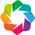

/home/ec2-user/miniconda2/envs/cub/lib/python2.7/site-packages/bokeh/io/saving.py:125: UserWarning: save() called but no resources were supplied and output_file(...) was never called, defaulting to resources.CDN
  warn("save() called but no resources were supplied and output_file(...) was never called, defaulting to resources.CDN")
/home/ec2-user/miniconda2/envs/cub/lib/python2.7/site-packages/bokeh/io/saving.py:138: UserWarning: save() called but no title was supplied and output_file(...) was never called, using default title 'Bokeh Plot'
  warn("save() called but no title was supplied and output_file(...) was never called, using default title 'Bokeh Plot'")


please write %output size=100" before calling this function


:Layout
   .Overlay.Cluster_info_colon_primary_clust_plus_outlier_plus_secondary_clust_for_homologies :Overlay
      .Area.Outliers  :Area   [homologies]   (props,Baseline)
      .Area.Primary   :Area   [homologies]   (props,Baseline)
      .Area.Secondary :Area   [homologies]   (props,Baseline)
   .Overlay.I                                                                                 :Overlay
      .Area.Outliers  :Area   [homologies]   (props)
      .Area.Primary   :Area   [homologies]   (props)
      .Area.Secondary :Area   [homologies]   (props)
   .Overlay.Cluster_info_colon_primary_clust_plus_outlier_plus_secondary_clust_for_species    :Overlay
      .Area.Outliers  :Area   [species]   (props,Baseline)
      .Area.Primary   :Area   [species]   (props,Baseline)
      .Area.Secondary :Area   [species]   (props,Baseline)
   .Overlay.II                                                                                :Overlay
      .Area.Outliers  :Area   [species]   (props)
      .Area.Primary   :Area   [species]   (props)
      .Area.Secondary :Area   [species]   (props)

In [17]:
cub.all_homoset.get_clusterstats(sort=True, redo=True)

PyCUB/homoset.py:873: RuntimeWarning: invalid value encountered in divide
  specluster = np.divide(specluster.T, specluster.sum(1)).T


 beware, species_namelist does not represent speciesdict/loadhashomo/loadfullhomo/etc anymore.
just do homoset.species_namelist = cub.speciesdict().values() to retrieve the correspondance



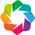

please write %output size=100" before calling this function


:Layout
   .Overlay.Cluster_info_colon_primary_clust_plus_outlier_plus_secondary_clust_for_homologies :Overlay
      .Area.Outliers  :Area   [homologies]   (props,Baseline)
      .Area.Primary   :Area   [homologies]   (props,Baseline)
      .Area.Secondary :Area   [homologies]   (props,Baseline)
   .Overlay.I                                                                                 :Overlay
      .Area.Outliers  :Area   [homologies]   (props)
      .Area.Primary   :Area   [homologies]   (props)
      .Area.Secondary :Area   [homologies]   (props)
   .Overlay.Cluster_info_colon_primary_clust_plus_outlier_plus_secondary_clust_for_species    :Overlay
      .Area.Outliers  :Area   [species]   (props,Baseline)
      .Area.Primary   :Area   [species]   (props,Baseline)
      .Area.Secondary :Area   [species]   (props,Baseline)
   .Overlay.II                                                                                :Overlay
      .Area.Outliers  :Area   [species]   (props)
      .Area.Primary   :Area   [species]   (props)
      .Area.Secondary :Area   [species]   (props)

In [182]:
%output size=100
cub.working_homoset.get_clusterstats(sort=True, redo=True)

In [22]:
cub.save("processed_test")

writing in processed_test
it worked !


In [154]:
cub = pyCUB.PyCUB(session = 'ensembl2')
cub.load(session = 'ensembl2',filename = "processed_test")

working on session: ensembl2
you already have a session here (just a warning)
unzipping utils/save/ensembl2/processed_test.json.gz
loading from processed_test
it worked !
you now have 1730558 genes in total


{}

Here we can see that amongst the outlier species we have only species in very few homologies except for __hepatospora_eriocheir__ which is present in ~700 and still present such CUB behavior.

In [90]:
for i in [0,1,2,3,4,514,515,516,517,518,519]:
    print cub.species[cub.all_homoset.species_namelist[i]].name
    print "----"
    print cub.species[cub.all_homoset.species_namelist[i]].genome_size
    print "----"
    print cub.species[cub.all_homoset.species_namelist[i]].metadata.values()
    print "----"
    print cub.species[cub.all_homoset.species_namelist[i]].average_entropy
    print "----"
    print cub.species[cub.all_homoset.species_namelist[i]].average_size
    print "----"
    print cub.species[cub.all_homoset.species_namelist[i]].meanGChomo
    print "----"
    print cub.species[cub.all_homoset.species_namelist[i]].tot_homologies
    print "----"
    print cub.species[cub.all_homoset.species_namelist[i]].meanecai
    print "----"

pichia_kudriavzevii
----
12940563
----
[False, False, False, False, False]
----
[ 10.23504568  11.03621614   5.81492127   2.17585854   0.64209774
   6.95495348  12.32403074   7.99365213   1.68277675  18.14734497
  37.82249894  13.78025557   4.55352177   6.68235779  10.1744204
   8.42901619   5.44227953  14.5561288 ]
----
935.1
----
0.417403998516
----
10
----
None
----
calocera_viscosa_tufc12733
----
71515325
----
[False, False, False, False, False]
----
[  4.47988631   9.21725799   2.89547532   1.11071367   1.05665087
   3.80566443   6.32414114   5.64791979   0.90528206  14.79078551
  25.82603781  10.02809042   7.11255602   2.73312747   7.40466002
   5.06231873   2.25621244  12.20486525]
----
820.75
----
0.464930805223
----
12
----
None
----
sistotremastrum_suecicum_hhb10207_ss_3
----
33857913
----
[False, False, False, True, False]
----
[  4.30016516   4.56501529   0.44998063   0.51591951   0.66246668
   1.52246399   0.83294061   2.94811355   0.72659411   8.3848407
  15.32889446   1.

In [23]:
secondaryhomo = [142,143,286,406,407,507,511,1527,1954,2474]
for i in secondaryhomo:
    print cub.working_homoset[i]


homology: YNL301C
size: 476
fullmax: 47.5755136274
var: [ 4.19727857  7.63248017  1.55997253  0.991775    0.28454653  0.93351425
  1.47868134  4.37555918  1.12520938  1.81923421  4.14518998  3.99321058
  1.49683083  2.41717353  2.50518088  2.4406778   0.68345133  3.28956398]
mean: [  6.71034626  13.37496864   2.40920192   0.71533636   0.35192105
   0.69473244   1.87853639   6.25954926   1.52569355   3.29347152
   9.51309173   7.21126866   2.17641977   4.14540005   4.69257842
   4.86196466   0.70845815   6.02137773]
metrics: {'silhouette': -0.08713387244123297, 'cal_hara': 25.32103547720578, 'cluster_phylodistance': [0.9941175676910997, 0.792821472097044, 1.0048060563537946, 0.6472012017118726, 0.21236289431170818, 0.16989031544936656]}
nans mean: 0.663865546218
lengths mean/var: 189.430672269, 57.0000868381
doublon sum: 49
GCcount mean/var: 0.548499323225, 0.0729952980189
KaKs_Scores: None
isrecent: False
ishighpreserved: False
ref: None
refprot: YNL301C
refgene: YNL301C
ecai mean/var

In [295]:
cub.loadspeciestable()

it worked !


In [301]:
cub.working_homoset['YPR102C'].plot('tsne', per=100, D=2,interactive=True,correlation=True)

 if you are on a notebook you should write 'from bokeh.io import output_notebook'
similarity_scores: SpearmanrResult(correlation=0.44126966286818109, pvalue=9.3715047790922373e-28)
nans: SpearmanrResult(correlation=-0.26189260032207634, pvalue=3.9955072037803424e-10)
ecai: SpearmanrResult(correlation=0.16599490070839287, pvalue=8.7840155071909685e-05)
cai: SpearmanrResult(correlation=-0.12527002782781424, pvalue=0.0031694191946236841)
lenmat: SpearmanrResult(correlation=0.028970437037223521, pvalue=0.4965876805756344)
GCcount: SpearmanrResult(correlation=0.16289944019868202, pvalue=0.00011918414037122116)


Loading BokehJS ...

homology: YPR102C
------------------------------------
silhouette: 0
cal_hara: 0
cluster_phylodistance: [1.0]
------------------------------------
Amino, CUB value mean, variance
ALA: 3.54, 4.793
ARG: 10.07, 32.444
ASN: 2.33, 1.717
ASP: 0.90, 1.095
CYS: 0.55, 0.231
GLN: 1.10, 1.145
GLU: 3.32, 6.584
GLY: 7.77, 18.416
HIS: 0.96, 0.409
ILE: 5.68, 5.640
LEU: 5.53, 6.478
LYS: 5.84, 9.420
PHE: 2.27, 2.023
PRO: 1.95, 1.135
SER: 3.80, 3.764
THR: 4.36, 5.117
TYR: 1.97, 1.498
VAL: 5.78, 6.318
avg similarity Scores
0.87590761348
------------------------------------
mean ecai: 0.657381299733
mean cai: 0.570661776579
abundance of the protein in a cell: 32791.0
weight of protein: 19720
abundance of mRNA: 17.9
halflife (in mn): 0.0
total volume of protein: 22939.7
the pseudo hydrophobicity is of: -0.680473372781
the glucose cost: 164.13
synthesis steps: 922
the isoelectricpoint(Pi) is : 6.97


There is a lot to say here. first we can see that ecai and similarity scores correlate more with entropy than anything else and correlate similarly with each other. It means that mean entropy retrieves evolutionary drift information of different genes. 
Moreover, we can see that some very similar cluster in their entropy and shape, reveal that two different genes are encoding very similar proteins (see their size, etc). It is also almost exactly the same cluster. However their ecai is not the same for both (as if compared with two different genes)
It can mean two things. There is a problem with ensembl's database and it shows the wrong homologous genes to a reference one. Or we have homologous genes that have not been found and instead placed into different clusters. Or we are seeing two genes that produce very similar proteins and are extremelly related to one another (as they have drifted and evolved together) this is very well picked up by entropy and homologous comparisons. It shows even more when plotting the homologies together and seeing that they overlaps perfeclty and that the length of the genes are the same as well. YBL027W;YBR084C-A and YOL120C;YNL301C and YER131W;YGL189C

Moreover, these homologies being exactly the same, might hint on what were the density clusters in the all_homoplot, earlier. 

Also we can also see that some other homologies are completely different in their CUB but lead to similar species being into similar clusters which very much shows a similar drift of the genome toward a species CUB for some genes.

It is also intersting to see that the correlation often differ amongst homologies, even if similarity scores and ecai stay somewhat the same, length, nans ad GCcount sometimes explain quite a few of the differences in codon usage bias we see. YGL189C;YER131W;YPR102C


In [303]:
cub.working_homoset['YER131W'].plot('pca', D=2,interactive=True,correlation=True)

 if you are on a notebook you should write 'from bokeh.io import output_notebook'
similarity_scores: SpearmanrResult(correlation=0.43487331185717687, pvalue=2.6003821222295293e-25)
nans: SpearmanrResult(correlation=-0.27068816195697354, pvalue=3.7721552777484254e-10)
ecai: SpearmanrResult(correlation=0.43033486715175473, pvalue=9.1365917867182727e-25)
cai: SpearmanrResult(correlation=-0.0789140703800634, pvalue=0.072731142201338167)
lenmat: SpearmanrResult(correlation=0.026909476813379948, pvalue=0.54114636079113398)
GCcount: SpearmanrResult(correlation=0.1025444230874635, pvalue=0.019575315835816339)


Loading BokehJS ...

homology: YER131W
------------------------------------
silhouette: 0.38634971103
cal_hara: 212.420500982
cluster_phylodistance: [0.8505486840881615, 0.780973422443826, 1.009519209613653]
------------------------------------
Amino, CUB value mean, variance
ALA: 4.27, 8.606
ARG: 9.31, 42.809
ASN: 2.65, 1.962
ASP: 0.46, 0.434
CYS: 1.32, 0.949
GLN: 0.44, 0.251
GLU: 0.71, 0.560
GLY: 2.45, 2.680
HIS: 0.74, 0.257
ILE: 2.95, 2.298
LEU: 1.01, 1.591
LYS: 5.57, 8.943
PHE: 0.54, 0.250
PRO: 2.71, 2.664
SER: 3.20, 3.134
THR: 1.21, 1.130
TYR: 1.38, 0.599
VAL: 4.39, 5.523
avg similarity Scores
0.847190419767
------------------------------------
mean ecai: 0.665378179225
mean cai: 0.585142300724
abundance of the protein in a cell: 243361.0
weight of protein: 13447
abundance of mRNA: 11.7
halflife (in mn): 0.0
total volume of protein: 16553.5
the pseudo hydrophobicity is of: -0.869230769231
the glucose cost: 115.46
synthesis steps: 640
the isoelectricpoint(Pi) is : 6.97


In [70]:
cub.working_homoset['YGL189C'].plot('tsne', D=2,interactive=True,correlation=True)

 if you are on a notebook you should write 'from bokeh.io import output_notebook'
similarity_scores: SpearmanrResult(correlation=0.42720146613820714, pvalue=1.9436464141625602e-24)
nans: SpearmanrResult(correlation=-0.27136737481256884, pvalue=3.2660076243783963e-10)
ecai: SpearmanrResult(correlation=0.42240622026574848, pvalue=7.1041628456677805e-24)
cai: SpearmanrResult(correlation=-0.068786189053128929, pvalue=0.11755165598522778)
lenmat: SpearmanrResult(correlation=0.02285945138870555, pvalue=0.60335183722590546)
GCcount: SpearmanrResult(correlation=0.092770755313180533, pvalue=0.034607094161626988)


Loading BokehJS ...

homology: YGL189C
------------------------------------
silhouette: 0.388873696407
cal_hara: 218.980391519
cluster_phylodistance: [0.8504936969340643, 0.8063694420020829, 1.009453945168029]
------------------------------------
Amino, CUB value mean, variance
ALA: 4.29, 8.684
ARG: 9.35, 43.407
ASN: 2.66, 1.967
ASP: 0.46, 0.433
CYS: 1.32, 0.945
GLN: 0.44, 0.251
GLU: 0.71, 0.571
GLY: 2.45, 2.676
HIS: 0.75, 0.256
ILE: 2.94, 2.296
LEU: 1.01, 1.563
LYS: 5.58, 8.870
PHE: 0.54, 0.250
PRO: 2.71, 2.653
SER: 3.20, 3.128
THR: 1.21, 1.131
TYR: 1.38, 0.598
VAL: 4.41, 5.505
avg similarity Scores
0.83251826766
------------------------------------
mean ecai: 0.796769040775
mean cai: 0.585526202067
abundance of the protein in a cell: 97095.0
weight of protein: 13505
abundance of mRNA: 60.3
halflife (in mn): 0.0
total volume of protein: 16603.3
the pseudo hydrophobicity is of: -0.91452991453
the glucose cost: 115.82
synthesis steps: 640
the isoelectricpoint(Pi) is : 6.97


In [62]:
from scipy.stats import spearmanr
spearmanr(cub.working_homoset[511].similarity_scores,cub.working_homoset[511].ecai,axis=None)

SpearmanrResult(correlation=0.47852460467219776, pvalue=4.655130219170088e-31)

In [45]:
cub.get_subset(homoset = cub.working_homoset, withcopy=True, clusternb=None, species=None,
               homologies=[cub.working_homoset.homo_namelist[i] for i in secondaryhomo]
              ).compare_clusters(cubdistance_matrix=True, plot=True, size=40)

loaded
loaded


Loading BokehJS ...

Loading BokehJS ...

In [89]:
cub.loadspeciestable()

it worked !


In [78]:
cub.get_subset(homoset = cub.working_homoset, withcopy=True, clusternb=None, species=None,
               homologies=[cub.working_homoset.homo_namelist[i] for i in speciesInSecondary[:6]]).plot_all(With='tsne', perplexity=60,
                                         interactive=True, iteration=300)

loaded
loaded


Loading BokehJS ...

In [86]:
outlierhomo = [0,1,10,20,25,30,35,55]
for i in outlierhomo:
    print cub.working_homoset[i]


homology: YNR016C
size: 504
fullmax: 262.466441382
var: [ 30.230014    36.2426655   13.48375913  11.43976504   2.19170369
  14.81573239  25.73459815  31.32977477   6.54369975  18.61288105
  40.19508857  25.86419796  12.10305714  21.66696462  21.07124573
  19.67990722  12.37853701  26.5376487 ]
mean: [ 39.42876256  58.14891906  15.39614007   7.57189282   2.15000494
  15.44396507  27.0042619   54.29198731   6.67258082  47.57692932
  74.15008415  32.58699866  15.25148489  27.45158192  26.43155818
  24.68517253  13.35287885  45.566238  ]
metrics: {u'silhouette': 0, u'cal_hara': 0, u'cluster_phylodistance': [1.0]}
nans mean: 0.0119047619048
lengths mean/var: 2083.71626984, 411.518617167
doublon sum: 33
GCcount mean/var: 0.525453981224, 0.0661595549368
KaKs_Scores: None
isrecent: False
ishighpreserved: False
ref: None
refprot: YNR016C
refgene: YNR016C
ecai mean/var: 0.44298859627, 0.111217477063
cai mean/var: 0.608844955289, 0.085490439247
protein_abundance: 11387.0
weight: 250351
conservat

In [173]:
cub.working_homoset[10].plot('tsne', D=2,interactive=True,correlation=True)

 if you are on a notebook you should write 'from bokeh.io import output_notebook'
similarity_scores: SpearmanrResult(correlation=0.11974691404610133, pvalue=0.012043616261379442)
nans: SpearmanrResult(correlation=nan, pvalue=nan)
ecai: SpearmanrResult(correlation=0.05021311385075853, pvalue=0.29383570302513046)
cai: SpearmanrResult(correlation=-0.10101378805942607, pvalue=0.034357209752152389)
lenmat: SpearmanrResult(correlation=0.011987166885817987, pvalue=0.80223785649952051)
GCcount: SpearmanrResult(correlation=0.16102554232152069, pvalue=0.00070825231024266829)


Loading BokehJS ...

homology: YDL140C
------------------------------------
silhouette: -0.347897809806
cal_hara: 3.67739920897
cluster_phylodistance: [0.995333161839268, 1.095712465456471, 0.34601446277572767, 0.7439310949678145, 0.7785325412453873]
------------------------------------
Amino, CUB value mean, variance
ALA: 12.69, 109.596
ARG: 33.23, 384.576
ASN: 8.62, 81.956
ASP: 5.61, 90.016
CYS: 2.10, 8.080
GLN: 6.29, 56.145
GLU: 8.54, 134.115
GLY: 35.29, 414.282
HIS: 2.52, 10.523
ILE: 29.88, 122.891
LEU: 38.31, 464.463
LYS: 15.79, 181.448
PHE: 7.88, 42.056
PRO: 15.26, 334.787
SER: 17.10, 343.675
THR: 10.19, 126.731
TYR: 4.99, 32.739
VAL: 24.42, 197.951
avg similarity Scores
0.806286629188
------------------------------------
mean ecai: 0.46749506654
mean cai: 0.62770136254
abundance of the protein in a cell: 17375.0
weight of protein: 191610
abundance of mRNA: 1.2
halflife (in mn): 0.031507
total volume of protein: 227641.4
the pseudo hydrophobicity is of: -0.454832935561
the glucose cost: 1562.43
synth

very high variances, similarities that do not relate to the change in CUB at all, inverse correlation to many things but correlation to GCcount. hinting on a different kind of bias, showing a really strong one however. There is strong correlation to length and GCcount here 
The similarities are really low. Meaning that there is a really strong evolutionary constraint for them. It would be wise for this group, to extract it and compute other clustering hyperparameters.

Similarly here we have instances of almost exactly the same homologies (twin homologies)
It also seems that some of them are completly different than the rest. YKL182W;YNR016C
For them, the similarity score is much higher.
FOr all the other, it seems that the reference gene has also a very highly entropy value 

In [171]:
cub.working_homoset['YKL182W'].plot('tsne', D=2,interactive=True,correlation=True)

 if you are on a notebook you should write 'from bokeh.io import output_notebook'
similarity_scores: SpearmanrResult(correlation=0.037859815466143781, pvalue=0.37551565432676903)
nans: SpearmanrResult(correlation=-0.1669341654415212, pvalue=8.3654587165791271e-05)
ecai: SpearmanrResult(correlation=-0.013795450543254805, pvalue=0.74683816587670093)
cai: SpearmanrResult(correlation=-0.18451131554398742, pvalue=1.3320448316152529e-05)
lenmat: SpearmanrResult(correlation=0.49269384700572383, pvalue=5.6149276120470033e-35)
GCcount: SpearmanrResult(correlation=0.24454986571941831, pvalue=6.224591628537765e-09)


Loading BokehJS ...

homology: YKL182W
------------------------------------
silhouette: 0.0231010110396
cal_hara: 31.7365765771
cluster_phylodistance: [0.9977852828493711, 0.7371829814943367]
------------------------------------
Amino, CUB value mean, variance
ALA: 38.20, 1610.057
ARG: 46.87, 1312.382
ASN: 14.39, 220.355
ASP: 7.07, 171.814
CYS: 1.93, 6.671
GLN: 13.26, 271.783
GLU: 24.64, 797.197
GLY: 54.12, 1782.070
HIS: 6.35, 66.741
ILE: 47.20, 658.326
LEU: 74.33, 3198.957
LYS: 33.83, 924.177
PHE: 13.39, 178.713
PRO: 27.83, 696.174
SER: 30.08, 1012.162
THR: 29.01, 638.944
TYR: 11.21, 151.946
VAL: 47.24, 1121.338
avg similarity Scores
0.715385694129
------------------------------------
mean ecai: 0.423261482942
mean cai: 0.610235960482
abundance of the protein in a cell: 94907
weight of protein: 228689
abundance of mRNA: 3.7
number of cys_elements: 15
the protein is secreted out of the cell
halflife (in mn): 0.001
total volume of protein: 270476.8
the pseudo hydrophobicity is of: -0.216112789527
the glucos

In [91]:
cub.working_homoset['YNR016C'].plot('tsne', D=2,interactive=True,correlation=True)

 if you are on a notebook you should write 'from bokeh.io import output_notebook'
similarity_scores: SpearmanrResult(correlation=0.15296426892106091, pvalue=0.00056934708193189247)
nans: SpearmanrResult(correlation=-0.17110272856249881, pvalue=0.00011328878575171294)
ecai: SpearmanrResult(correlation=-0.15894624695793266, pvalue=0.00034061809294703635)
cai: SpearmanrResult(correlation=-0.3503784401533328, pvalue=5.284184358566423e-16)
lenmat: SpearmanrResult(correlation=0.1803169711666025, pvalue=4.6716433281590285e-05)
GCcount: SpearmanrResult(correlation=0.38903938597346588, pvalue=1.1677370420646218e-19)


Loading BokehJS ...

homology: YNR016C
------------------------------------
silhouette: 0
cal_hara: 0
cluster_phylodistance: [1.0]
------------------------------------
Amino, CUB value mean, variance
ALA: 39.43, 913.854
ARG: 58.15, 1313.531
ASN: 15.40, 181.812
ASP: 7.57, 130.868
CYS: 2.15, 4.804
GLN: 15.44, 219.506
GLU: 27.00, 662.270
GLY: 54.29, 981.555
HIS: 6.67, 42.820
ILE: 47.58, 346.439
LEU: 74.15, 1615.645
LYS: 32.59, 668.957
PHE: 15.25, 146.484
PRO: 27.45, 469.457
SER: 26.43, 443.997
THR: 24.69, 387.299
TYR: 13.35, 153.228
VAL: 45.57, 704.247
avg similarity Scores
0.805041949327
------------------------------------
mean ecai: 0.44298859627
mean cai: 0.608844955289
abundance of the protein in a cell: 11387.0
weight of protein: 250351
abundance of mRNA: 2.7
halflife (in mn): 0.002975
total volume of protein: 295011.7
the pseudo hydrophobicity is of: -0.340666975452
the glucose cost: 2072.43
synthesis steps: 10860
the isoelectricpoint(Pi) is : 6.97


In [172]:
cub.get_subset(homoset = cub.working_homoset, withcopy=True, clusternb=None, species=None,
               homologies=cub.working_homoset.homo_namelist[:40]
              ).compare_clusters(cubdistance_matrix=True, plot=True, size=40)

loaded
loaded


Loading BokehJS ...

Loading BokehJS ...

In [93]:
cub.get_subset(homoset = cub.working_homoset, withcopy=True, clusternb=None, species=None,
               homologies=[cub.working_homoset.homo_namelist[i] for i in outlierhomo[:5]]).plot_all(With='tsne', perplexity=60,
                                         interactive=True, iteration=300)

loaded
loaded


Loading BokehJS ...

It is very interesting to see in primary homo, how some homologies have a huge entropy for one or two dimension only, meanin that the entropy is only driven by one amino acid

In [94]:
primaryhomo = [3120,3130,3140,3150,3160,3180,3186]
for i in primaryhomo:
    print cub.working_homoset[i]


homology: YPL249C-A
size: 467
fullmax: 24.4304442885
var: [ 2.31749922  4.11068593  0.73724624  0.43787178  0.15669663  0.57942363
  1.26988081  1.66572352  0.54057033  1.20491285  1.68876278  2.75185157
  0.42520982  1.11434036  1.48259247  1.74776027  0.35712467  2.21274875]
mean: [ 3.7602462   8.17197914  1.01283555  0.35511685  0.45155306  0.43049379
  1.32816944  2.92434402  0.57351561  1.76773884  3.81754145  5.06631733
  0.44068211  1.35540742  2.36663914  2.63796994  0.20977809  3.73079638]
metrics: {u'silhouette': 0.31790671565220824, u'cal_hara': 8.001118986130745, u'cluster_phylodistance': [1.083990728296227, 0.9993170330704536]}
nans mean: 1.1113490364
lengths mean/var: 105.683083512, 22.1982066313
doublon sum: 42
GCcount mean/var: 0.559829600592, 0.0752620468957
KaKs_Scores: None
isrecent: False
ishighpreserved: False
ref: None
refprot: YPL249C-A
refgene: YPL249C-A
ecai mean/var: 0.754447187918, 0.0878951045143
cai mean/var: 0.551622420676, 0.103412994926
protein_abundanc

In [95]:
cub.working_homoset[3120].plot('tsne', D=2,interactive=True,correlation=True)

 if you are on a notebook you should write 'from bokeh.io import output_notebook'
similarity_scores: SpearmanrResult(correlation=0.15668458797295806, pvalue=0.00067900733673671384)
nans: SpearmanrResult(correlation=0.28586330406273419, pvalue=3.1180931951463311e-10)
ecai: SpearmanrResult(correlation=0.35815742616977347, pvalue=1.3990479861887904e-15)
cai: SpearmanrResult(correlation=-0.059886576258249898, pvalue=0.19640866101880053)
lenmat: SpearmanrResult(correlation=0.0051118698202435491, pvalue=0.91227208771407242)
GCcount: SpearmanrResult(correlation=0.1392534124048882, pvalue=0.0025618902813443235)


Loading BokehJS ...

homology: YPL249C-A
------------------------------------
silhouette: 0.317906715652
cal_hara: 8.00111898613
cluster_phylodistance: [1.083990728296227, 0.9993170330704536]
------------------------------------
Amino, CUB value mean, variance
ALA: 3.76, 5.371
ARG: 8.17, 16.898
ASN: 1.01, 0.544
ASP: 0.36, 0.192
CYS: 0.45, 0.025
GLN: 0.43, 0.336
GLU: 1.33, 1.613
GLY: 2.92, 2.775
HIS: 0.57, 0.292
ILE: 1.77, 1.452
LEU: 3.82, 2.852
LYS: 5.07, 7.573
PHE: 0.44, 0.181
PRO: 1.36, 1.242
SER: 2.37, 2.198
THR: 2.64, 3.055
TYR: 0.21, 0.128
VAL: 3.73, 4.896
avg similarity Scores
0.679533539952
------------------------------------
mean ecai: 0.754447187918
mean cai: 0.551622420676
abundance of the protein in a cell: 166460
weight of protein: 11135
abundance of mRNA: nan
the protein is secreted out of the cell
halflife (in mn): 0.0012
total volume of protein: 13286.1
the pseudo hydrophobicity is of: -0.638144329897
the glucose cost: 94.2
synthesis steps: 567
the isoelectricpoint(Pi) is : 6.97


 Here as well, we should compute specific hyperparameters for the groups here. We can see that many parameters can influence the CUB. The similarities are not that high and most of the genes are small. However we can still see that most homologies are separable. 
 #### The fact that homologies are still separable means that there is mostly some force that separate them which is mostly about the protein function than Anything else. quite a recent idea in fact
 
 Moreover there is still twin homologies and some highly differenet homologies than the rest.

In [177]:
cub.working_homoset[3130].plot('tsne', D=2,interactive=True,correlation=True)

 if you are on a notebook you should write 'from bokeh.io import output_notebook'
similarity_scores: SpearmanrResult(correlation=0.32963398880492711, pvalue=2.2941910765484818e-14)
nans: SpearmanrResult(correlation=-0.050120172803386744, pvalue=0.25902776911849618)
ecai: SpearmanrResult(correlation=0.02066270840375984, pvalue=0.64187740024601836)
cai: SpearmanrResult(correlation=-0.084657244755652339, pvalue=0.05630257313438284)
lenmat: SpearmanrResult(correlation=-0.45581051665020356, pvalue=1.7659741848818821e-27)
GCcount: SpearmanrResult(correlation=0.21769726581613691, pvalue=7.0858251668679864e-07)


Loading BokehJS ...

homology: YDL130W
------------------------------------
silhouette: 0.194583053165
cal_hara: 27.0309186085
cluster_phylodistance: [1.0060273870153638, 0.9967358402121902]
------------------------------------
Amino, CUB value mean, variance
ALA: 10.69, 27.505
ARG: 0.48, 0.183
ASN: 0.42, 0.219
ASP: 1.05, 1.354
CYS: 0.41, 0.043
GLN: 0.31, 0.146
GLU: 4.12, 8.981
GLY: 5.19, 6.593
HIS: 0.42, 0.039
ILE: 2.41, 1.490
LEU: 5.46, 4.618
LYS: 2.74, 2.280
PHE: 0.90, 0.298
PRO: 1.13, 0.964
SER: 3.10, 3.688
THR: 1.45, 1.127
TYR: 0.08, 0.051
VAL: 1.72, 1.177
avg similarity Scores
0.756857403512
------------------------------------
mean ecai: 0.563350773471
mean cai: 0.626089986662
abundance of the protein in a cell: 49835.0
weight of protein: 10667
abundance of mRNA: 50.6
halflife (in mn): 0.001755
total volume of protein: 12192.4
the pseudo hydrophobicity is of: 0.0223300970874
the glucose cost: 81.3
synthesis steps: 384
the isoelectricpoint(Pi) is : 5.795


In [178]:
cub.working_homoset[3180].plot('tsne', D=2,interactive=True,correlation=True)

[autoreload of PyCUB.pyCUB failed: Traceback (most recent call last):
  File "/home/ec2-user/miniconda2/envs/cub/lib/python2.7/site-packages/IPython/extensions/autoreload.py", line 247, in check
    superreload(m, reload, self.old_objects)
  File "PyCUB/pyCUB.py", line 1175
    el:
      ^
SyntaxError: invalid syntax
]
[autoreload of PyCUB.pyCUB failed: Traceback (most recent call last):
  File "/home/ec2-user/miniconda2/envs/cub/lib/python2.7/site-packages/IPython/extensions/autoreload.py", line 247, in check
    superreload(m, reload, self.old_objects)
  File "PyCUB/pyCUB.py", line 1175
    el:
      ^
SyntaxError: invalid syntax
]
[autoreload of PyCUB.pyCUB failed: Traceback (most recent call last):
  File "/home/ec2-user/miniconda2/envs/cub/lib/python2.7/site-packages/IPython/extensions/autoreload.py", line 247, in check
    superreload(m, reload, self.old_objects)
  File "PyCUB/pyCUB.py", line 1175
    el:
      ^
SyntaxError: invalid syntax
]
[autoreload of PyCUB.pyCUB failed: Tr

 if you are on a notebook you should write 'from bokeh.io import output_notebook'
similarity_scores: SpearmanrResult(correlation=0.09786950186826196, pvalue=0.03205119418049767)
nans: SpearmanrResult(correlation=-0.19590289969118865, pvalue=1.540731325834782e-05)
ecai: SpearmanrResult(correlation=0.35135518228446844, pvalue=2.155877607469682e-15)
cai: SpearmanrResult(correlation=-0.30619021569389493, pvalue=7.0738882403011127e-12)
lenmat: SpearmanrResult(correlation=0.10524978740516901, pvalue=0.021093649469112005)
GCcount: SpearmanrResult(correlation=0.40033350586522315, pvalue=6.6791437489435558e-20)


Loading BokehJS ...

homology: YLR325C
------------------------------------
silhouette: 0.241608083903
cal_hara: 9.10403085542
cluster_phylodistance: [0.9954661910167019, 1.0000686007902837]
------------------------------------
Amino, CUB value mean, variance
ALA: 1.95, 1.981
ARG: 3.07, 4.186
ASN: 0.86, 0.665
ASP: 0.65, 0.561
CYS: 0.42, 0.136
GLN: 0.99, 0.904
GLU: 0.55, 0.428
GLY: 0.46, 0.390
HIS: 0.34, 0.090
ILE: 2.22, 1.826
LEU: 3.34, 3.492
LYS: 6.32, 9.942
PHE: 0.68, 0.137
PRO: 1.06, 0.572
SER: 2.29, 2.399
THR: 1.85, 2.309
TYR: 0.27, 0.137
VAL: 2.08, 1.772
avg similarity Scores
0.779478833104
------------------------------------
mean ecai: 0.850684392688
mean cai: 0.560686856432
abundance of the protein in a cell: 22928.0
weight of protein: 8826
abundance of mRNA: 24.3
halflife (in mn): 0.0
total volume of protein: 10801.6
the pseudo hydrophobicity is of: -0.496103896104
the glucose cost: 77.56
synthesis steps: 463
the isoelectricpoint(Pi) is : 6.97


In [98]:
cub.get_subset(homoset = cub.working_homoset, withcopy=True, clusternb=None, species=None,
               homologies=cub.working_homoset.homo_namelist[-40:]
              ).compare_clusters(cubdistance_matrix=True, plot=True, size=40)

loaded
loaded


Loading BokehJS ...

Loading BokehJS ...

In [99]:
cub.get_subset(homoset = cub.working_homoset, withcopy=True, clusternb=None, species=None,
               homologies=[cub.working_homoset.homo_namelist[i] for i in primaryhomo[:5]]).plot_all(With='tsne', perplexity=60,
                                         interactive=True, iteration=300)

loaded
loaded


Loading BokehJS ...

In [ ]:
cub.all_homoset[2].plot('tsne', D=2,interactive=True)

In [ ]:
cub.all_homoset[2].plot('tsne', D=2,interactive=True)

In [ ]:
cub.get_evolutionary_distance()

In [169]:
len(cub.all_homoset)

5807

loaded
loaded
epoch: 29                            

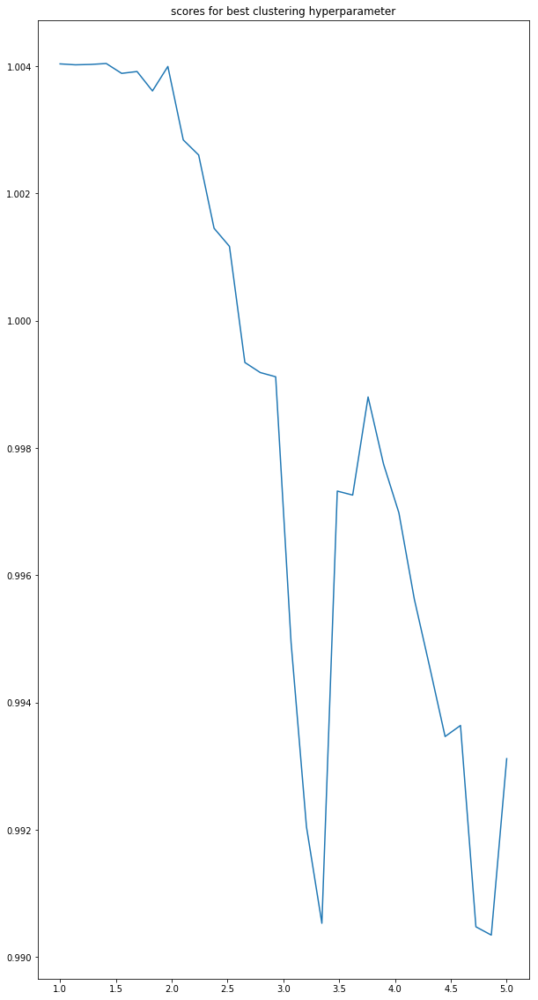

 the best value is : 4.86206896552
YHR100C
Estimated number of clusters using DBscan: 1
silhouette_score 0.26060143521
cal_hara 79.75012583
avg phylo dist of the clusters: [ 0.96699945  1.01832168]
-----------------------------
YBL002W
Estimated number of clusters using DBscan: 4
silhouette_score -0.0269205702163
cal_hara 23.3146231006
avg phylo dist of the clusters: [ 0.94300132  0.82829125  1.00892758  0.34252646]
-----------------------------
YDR513W
Estimated number of clusters using DBscan: 1
silhouette_score 0.237766138647
cal_hara 54.377272064
avg phylo dist of the clusters: [ 1.02359326  0.99230565]
-----------------------------
YGL047W
Estimated number of clusters using DBscan: 1
silhouette_score 0.317724188733
cal_hara 112.174172346
avg phylo dist of the clusters: [ 0.94907372  1.00841615]
-----------------------------
YJL122W
Estimated number of clusters using DBscan: 1
silhouette_score -0.0163531618357
cal_hara 4.17221224794
avg phylo dist of the clusters: [ 0.99553413  1.0

  0.59323674]
-----------------------------
YNL122C
Estimated number of clusters using DBscan: 1
silhouette_score 0.32198907864
cal_hara 3.68362810829
avg phylo dist of the clusters: [ 1.]
-----------------------------
YMR071C
Estimated number of clusters using DBscan: 1
silhouette_score 0.278701768591
cal_hara 84.9973177628
avg phylo dist of the clusters: [ 1.0220638   0.97761683]
-----------------------------
YPL024W
Estimated number of clusters using DBscan: 1
silhouette_score 0.0248284302249
cal_hara 2.67899548365
avg phylo dist of the clusters: [ 1.02260128  1.0441791 ]
-----------------------------
YCR051W
Estimated number of clusters using DBscan: 1
silhouette_score 0.295458255499
cal_hara 119.788448782
avg phylo dist of the clusters: [ 0.96469249  1.01582341]
-----------------------------
YPL178W
Estimated number of clusters using DBscan: 1
silhouette_score 0.238956522328
cal_hara 128.24046585
avg phylo dist of the clusters: [ 0.96391367  1.0102734 ]
---------------------------

avg phylo dist of the clusters: [ 0.98833546  0.90746026  0.7731632   0.85864238  0.67660375  0.96657679
  0.21143867  0.73768603  1.01490562]
-----------------------------
YNL310C
Estimated number of clusters using DBscan: 2
silhouette_score 0.227716450494
cal_hara 62.0415732083
avg phylo dist of the clusters: [ 0.94470934  1.01103855  0.29938017]
-----------------------------
YCR063W
Estimated number of clusters using DBscan: 1
silhouette_score 0.249776373488
cal_hara 85.5158905028
avg phylo dist of the clusters: [ 0.95825981  1.00643847]
-----------------------------
YCL067C
Estimated number of clusters using DBscan: 1
silhouette_score -0.0439759701319
cal_hara 3.49213379787
avg phylo dist of the clusters: [ 1.00821918]
-----------------------------
YAL046C
Estimated number of clusters using DBscan: 1
silhouette_score 0.333409077939
cal_hara 111.396816237
avg phylo dist of the clusters: [ 0.92907436  0.99257068]
-----------------------------
YPL047W
Estimated number of clusters usin

Estimated number of clusters using DBscan: 1
silhouette_score 0.197234462916
cal_hara 73.386425187
avg phylo dist of the clusters: [ 0.97472241  0.99199718]
-----------------------------
YJL133C-A
Estimated number of clusters using DBscan: 1
silhouette_score 0.333005140738
cal_hara 7.54982709221
avg phylo dist of the clusters: [ 1.07323232]
-----------------------------
YMR252C
Estimated number of clusters using DBscan: 1
silhouette_score 0.398893452775
cal_hara 13.0267732032
avg phylo dist of the clusters: [ 1.36046512  0.9498062 ]
-----------------------------
YCR101C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YPL239W
Estimated number of clusters using DBscan: 1
silhouette_score 0.221531592298
cal_hara 111.914434183
avg phylo dist of the clusters: [ 0.982527    1.01074039]
-----------------------------
YOL008W
Estimated number of clusters using DBscan: 1
silhouette_score 0.237999142268

Estimated number of clusters using DBscan: 2
silhouette_score 0.192992665135
cal_hara 52.6452674359
avg phylo dist of the clusters: [ 0.96917197  0.9996222 ]
-----------------------------
YPR010C-A
Estimated number of clusters using DBscan: 1
silhouette_score 0.270812668764
cal_hara 10.168741638
avg phylo dist of the clusters: [ 0.21942758  1.0354892 ]
-----------------------------
YDR136C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YOR382W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YDR022C
Estimated number of clusters using DBscan: 1
silhouette_score 0.196284036092
cal_hara 5.75740170557
avg phylo dist of the clusters: [ 0.90725806  0.82949309]
-----------------------------
YJR055W
Estimated number of clusters using DBscan: 1
silhouette_score 0.147735919649
cal_hara 9.85104819201
avg phylo dist of the cluste

Estimated number of clusters using DBscan: 1
silhouette_score 0.202719998729
cal_hara 58.0102181935
avg phylo dist of the clusters: [ 1.0172553   0.99778531]
-----------------------------
YBL028C
Estimated number of clusters using DBscan: 1
silhouette_score 0.317063520207
cal_hara 13.1542677505
avg phylo dist of the clusters: [ 0.79822044  1.05526618]
-----------------------------
YLR179C
Estimated number of clusters using DBscan: 1
silhouette_score 0.152731706355
cal_hara 51.821330526
avg phylo dist of the clusters: [ 0.96803758  1.01394063]
-----------------------------
YNL210W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YDL181W
Estimated number of clusters using DBscan: 1
silhouette_score 0.251139306723
cal_hara 35.5024238286
avg phylo dist of the clusters: [ 0.86784401  1.00515183]
-----------------------------
YIL138C
Estimated number of clusters using DBscan: 3
silhouette_score 9.85

avg phylo dist of the clusters: [ 0.97664171  0.98445328]
-----------------------------
YKL031W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YPL229W
Estimated number of clusters using DBscan: 1
silhouette_score 0.297107419467
cal_hara 10.1194339335
avg phylo dist of the clusters: [ 1.07101947  1.00171821]
-----------------------------
YHR116W
Estimated number of clusters using DBscan: 1
silhouette_score 0.449782290159
cal_hara 34.5492118439
avg phylo dist of the clusters: [ 0.94256344  1.00333151]
-----------------------------
YLR388W
Estimated number of clusters using DBscan: 1
silhouette_score 0.404493273743
cal_hara 6.33068172989
avg phylo dist of the clusters: [ 0.99980308]
-----------------------------
YJL192C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YKL069W
Estimated number of clusters using DBscan: 1


avg phylo dist of the clusters: [ 0.97958009  1.00984108]
-----------------------------
YBR122C
Estimated number of clusters using DBscan: 1
silhouette_score 0.0104513245509
cal_hara 7.44135405521
avg phylo dist of the clusters: [ 1.01026614  1.01071509]
-----------------------------
YMR052W
Estimated number of clusters using DBscan: 1
silhouette_score 0.0504657407613
cal_hara 3.94672911526
avg phylo dist of the clusters: [ 1.04289396  1.00801833]
-----------------------------
YGR117C
Estimated number of clusters using DBscan: 1
silhouette_score -0.0135244943762
cal_hara 13.1963387436
avg phylo dist of the clusters: [ 0.97702393  1.05919692]
-----------------------------
YLR327C
Estimated number of clusters using DBscan: 1
silhouette_score 0.340237897246
cal_hara 7.78626618624
avg phylo dist of the clusters: [ 1.]
-----------------------------
YMR158W
Estimated number of clusters using DBscan: 1
silhouette_score 0.25940649951
cal_hara 156.450661986
avg phylo dist of the clusters: [ 0.9

Estimated number of clusters using DBscan: 1
silhouette_score 0.382295418429
cal_hara 22.9544914571
avg phylo dist of the clusters: [ 1.05378966  0.99794392]
-----------------------------
YDR512C
Estimated number of clusters using DBscan: 2
silhouette_score 0.262741263902
cal_hara 56.3209227259
avg phylo dist of the clusters: [ 0.94095559  0.98312027]
-----------------------------
YIL051C
Estimated number of clusters using DBscan: 2
silhouette_score 0.18182849043
cal_hara 66.663109984
avg phylo dist of the clusters: [ 0.99669439  1.0194871   1.06555759]
-----------------------------
YNR010W
Estimated number of clusters using DBscan: 1
silhouette_score 0.332491706128
cal_hara 9.48684662712
avg phylo dist of the clusters: [ 1.26002291  0.84601538]
-----------------------------
YFR026C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YJL143W
Estimated number of clusters using DBscan: 1
silhouette_score 0.2150404583

silhouette_score 0.166168228198
cal_hara 12.4708450698
avg phylo dist of the clusters: [ 1.03093486  0.98667576]
-----------------------------
YGL220W
Estimated number of clusters using DBscan: 1
silhouette_score 0.394634795738
cal_hara 78.4107563232
avg phylo dist of the clusters: [ 0.92553909  1.00301861]
-----------------------------
YGL128C
Estimated number of clusters using DBscan: 1
silhouette_score 0.043847149655
cal_hara 3.48633245912
avg phylo dist of the clusters: [ 1.08151966  0.18900344]
-----------------------------
YIL171W-A
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YOR285W
Estimated number of clusters using DBscan: 1
silhouette_score 0.200221512547
cal_hara 101.451221204
avg phylo dist of the clusters: [ 0.98143375  1.01885581]
-----------------------------
YNR046W
Estimated number of clusters using DBscan: 1
silhouette_score 0.290708268655
cal_hara 80.8020631884
avg phylo dist of the clust

Estimated number of clusters using DBscan: 1
silhouette_score 0.357629532117
cal_hara 15.5083935725
avg phylo dist of the clusters: [ 0.92440078  1.00409376]
-----------------------------
YPL234C
Estimated number of clusters using DBscan: 1
silhouette_score 0.313828102385
cal_hara 107.452493502
avg phylo dist of the clusters: [ 0.96993733  1.00222854]
-----------------------------
YPR082C
Estimated number of clusters using DBscan: 1
silhouette_score 0.313369360276
cal_hara 99.6741496768
avg phylo dist of the clusters: [ 0.97504085  0.99763857]
-----------------------------
YKR083C
Estimated number of clusters using DBscan: 1
silhouette_score 0.337875016532
cal_hara 8.49123450229
avg phylo dist of the clusters: [ 1.18208955  0.87562189]
-----------------------------
YBR217W
Estimated number of clusters using DBscan: 1
silhouette_score 0.413104681792
cal_hara 121.287515487
avg phylo dist of the clusters: [ 0.92915808  1.00447897]
-----------------------------
YEL076C
Estimated number of 

silhouette_score 0.229535777683
cal_hara 9.9244936321
avg phylo dist of the clusters: [ 0.92248062  1.17653277]
-----------------------------
YDR071C
Estimated number of clusters using DBscan: 1
silhouette_score 0.202206346754
cal_hara 89.0799415102
avg phylo dist of the clusters: [ 1.02274093  0.94631353]
-----------------------------
YDR162C
Estimated number of clusters using DBscan: 1
silhouette_score 0.10456735435
cal_hara 40.9473535933
avg phylo dist of the clusters: [ 0.97751933  0.9842679 ]
-----------------------------
YFR007W
Estimated number of clusters using DBscan: 1
silhouette_score 0.238352441145
cal_hara 46.3453167673
avg phylo dist of the clusters: [ 0.95739336  1.01775503]
-----------------------------
YML108W
Estimated number of clusters using DBscan: 1
silhouette_score 0.196775704993
cal_hara 4.27142789226
avg phylo dist of the clusters: [ 0.85446009  1.05253948]
-----------------------------
YDR178W
Estimated number of clusters using DBscan: 3
silhouette_score -0.01

avg phylo dist of the clusters: [ 0.97746325  0.90465202  0.84875378  0.84527272  0.62194826  0.49190454
  0.16962225]
-----------------------------
YDL232W
Estimated number of clusters using DBscan: 1
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YML030W
Estimated number of clusters using DBscan: 1
silhouette_score 0.235646191203
cal_hara 116.517671721
avg phylo dist of the clusters: [ 0.97962797  1.01171393]
-----------------------------
YLR109W
Estimated number of clusters using DBscan: 3
silhouette_score -0.0360777411881
cal_hara 52.659388805
avg phylo dist of the clusters: [ 0.9775658   1.01744537  0.52637217]
-----------------------------
YCR097W
Estimated number of clusters using DBscan: 1
silhouette_score 0.333159983673
cal_hara 13.9658722279
avg phylo dist of the clusters: [ 0.65737052  1.14257257]
-----------------------------
YDR078C
Estimated number of clusters using DBscan: 1
silhouette_score 0.141461494015
cal_hara 6.771

Estimated number of clusters using DBscan: 1
silhouette_score 0.293517031024
cal_hara 105.388531941
avg phylo dist of the clusters: [ 0.94350606  1.01578519]
-----------------------------
YOR234C
Estimated number of clusters using DBscan: 3
silhouette_score 0.144950382437
cal_hara 38.6004164738
avg phylo dist of the clusters: [ 0.97747016  0.75879477  0.99947137  0.16958737]
-----------------------------
YPL056C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YKL086W
Estimated number of clusters using DBscan: 1
silhouette_score 0.294437912151
cal_hara 26.735192599
avg phylo dist of the clusters: [ 0.99408612  1.00566624]
-----------------------------
YER112W
Estimated number of clusters using DBscan: 1
silhouette_score 0.285736831312
cal_hara 43.221846255
avg phylo dist of the clusters: [ 0.94386579  1.01167052]
-----------------------------
YLR154W-F
Estimated number of clusters using DBscan: 0
silhouette_scor

-----------------------------
YCL035C
Estimated number of clusters using DBscan: 1
silhouette_score 0.236722479532
cal_hara 56.2159490786
avg phylo dist of the clusters: [ 1.01418211  0.99494823]
-----------------------------
YML098W
Estimated number of clusters using DBscan: 1
silhouette_score 0.224951770112
cal_hara 78.3843273931
avg phylo dist of the clusters: [ 0.9652319   1.01267557]
-----------------------------
YJR112W-A
Estimated number of clusters using DBscan: 1
silhouette_score 0.034957224727
cal_hara 1.53312157587
avg phylo dist of the clusters: [ 1.06779661]
-----------------------------
YJR067C
Estimated number of clusters using DBscan: 1
silhouette_score 0.207458156037
cal_hara 9.47996797691
avg phylo dist of the clusters: [ 0.82603211  1.05184161]
-----------------------------
YML024W
Estimated number of clusters using DBscan: 6
silhouette_score -0.100404298638
cal_hara 24.5023967642
avg phylo dist of the clusters: [ 0.98654801  0.85122452  0.84838282  0.7613302   1.048

Estimated number of clusters using DBscan: 2
silhouette_score 0.259512746334
cal_hara 81.3875193238
avg phylo dist of the clusters: [ 0.95693744  1.01246449  0.38741066]
-----------------------------
YBR193C
Estimated number of clusters using DBscan: 1
silhouette_score 0.094164065144
cal_hara 11.6593774445
avg phylo dist of the clusters: [ 1.03516073  0.88930735]
-----------------------------
YNL147W
Estimated number of clusters using DBscan: 1
silhouette_score 0.310423660633
cal_hara 10.4783968757
avg phylo dist of the clusters: [ 1.20788207  0.90768437]
-----------------------------
YER018C
Estimated number of clusters using DBscan: 1
silhouette_score 0.312900809821
cal_hara 11.35898192
avg phylo dist of the clusters: [ 1.18262806  0.20044543]
-----------------------------
YBL003C
Estimated number of clusters using DBscan: 5
silhouette_score 0.112315156618
cal_hara 68.3658929174
avg phylo dist of the clusters: [ 0.97398367  0.78742898  1.0002194   0.31497159  0.99809179  0.58412913]


avg phylo dist of the clusters: [ 0.9587278   1.00464113]
-----------------------------
YDL083C
Estimated number of clusters using DBscan: 8
silhouette_score -0.0436618280256
cal_hara 30.9481796038
avg phylo dist of the clusters: [ 0.98599161  0.90746026  0.7731632   0.85864238  0.67660375  0.96657679
  0.21143867  0.73768603  1.01490562]
-----------------------------
YJL166W
Estimated number of clusters using DBscan: 1
silhouette_score 0.252991624612
cal_hara 17.2975417233
avg phylo dist of the clusters: [ 1.01416223  0.99669683]
-----------------------------
YPR132W
Estimated number of clusters using DBscan: 4
silhouette_score -0.109657747325
cal_hara 21.8703200572
avg phylo dist of the clusters: [ 0.96754642  1.00257994  0.84432618  0.16886524]
-----------------------------
YJR017C
Estimated number of clusters using DBscan: 1
silhouette_score 0.209399983878
cal_hara 117.03054046
avg phylo dist of the clusters: [ 0.96475752  1.01355701]
-----------------------------
YBL029C-A
Estimat

avg phylo dist of the clusters: [ 1.04058949  0.9047423 ]
-----------------------------
YCL005W-A
Estimated number of clusters using DBscan: 1
silhouette_score 0.40259177733
cal_hara 8.24593226981
avg phylo dist of the clusters: [ 1.001273]
-----------------------------
YBR231C
Estimated number of clusters using DBscan: 1
silhouette_score 0.157782525154
cal_hara 67.5730612884
avg phylo dist of the clusters: [ 1.01126863  0.96158242]
-----------------------------
YHR162W
Estimated number of clusters using DBscan: 2
silhouette_score 0.177614003279
cal_hara 101.598694687
avg phylo dist of the clusters: [ 0.92090142  0.96747964  0.5577526 ]
-----------------------------
YJR012C
Estimated number of clusters using DBscan: 1
silhouette_score 0.28299206446
cal_hara 4.1749859026
avg phylo dist of the clusters: [ 1.70378619  0.92348075]
-----------------------------
YLR162W-A
Estimated number of clusters using DBscan: 1
silhouette_score 0.511520684498
cal_hara 10.8977556102
avg phylo dist of the

avg phylo dist of the clusters: [ 1.0316444   1.00019894]
-----------------------------
YBR126W-A
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YOR103C
Estimated number of clusters using DBscan: 1
silhouette_score 0.29500575619
cal_hara 90.4404884142
avg phylo dist of the clusters: [ 0.93762437  1.01358596]
-----------------------------
YGL103W
Estimated number of clusters using DBscan: 7
silhouette_score -0.0895003812888
cal_hara 29.3616861559
avg phylo dist of the clusters: [ 0.97654115  0.97639399  0.82054684  0.39633632  1.01915053  0.16985842
  0.84929211]
-----------------------------
YFL014W
Estimated number of clusters using DBscan: 1
silhouette_score 0.17281567918
cal_hara 33.7017093919
avg phylo dist of the clusters: [ 0.99069524  0.97221844]
-----------------------------
YKL137W
Estimated number of clusters using DBscan: 1
silhouette_score 0.266191484376
cal_hara 6.35117603592
avg phylo dist of the

Estimated number of clusters using DBscan: 1
silhouette_score -0.0471847828663
cal_hara 4.19855323942
avg phylo dist of the clusters: [ 0.99745486  0.65004299]
-----------------------------
YBR062C
Estimated number of clusters using DBscan: 1
silhouette_score 0.188607882993
cal_hara 89.8983487066
avg phylo dist of the clusters: [ 0.99600924  0.98652266]
-----------------------------
YGL033W
Estimated number of clusters using DBscan: 1
silhouette_score 0.099714366016
cal_hara 6.4027267498
avg phylo dist of the clusters: [ 1.07676056  0.9528169 ]
-----------------------------
YCR031C
Estimated number of clusters using DBscan: 2
silhouette_score 0.0330516864483
cal_hara 16.0186121398
avg phylo dist of the clusters: [ 0.94886342  0.97917186  1.01851878]
-----------------------------
YBL087C
Estimated number of clusters using DBscan: 2
silhouette_score 0.0578431361517
cal_hara 27.5773375925
avg phylo dist of the clusters: [ 0.97873554  0.93234151  1.0034469 ]
-----------------------------
Y

avg phylo dist of the clusters: [ 0.9284987   1.00400863]
-----------------------------
YJL151C
Estimated number of clusters using DBscan: 1
silhouette_score 0.225093799607
cal_hara 5.60785923275
avg phylo dist of the clusters: [ 1.18262806  0.90200445]
-----------------------------
YLR154W-C
Estimated number of clusters using DBscan: 1
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YKL096C-B
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YLR154W-E
Estimated number of clusters using DBscan: 1
silhouette_score 0.673815519964
cal_hara 19.355687073
avg phylo dist of the clusters: [ 1.]
-----------------------------
YPL225W
Estimated number of clusters using DBscan: 2
silhouette_score 0.116979104238
cal_hara 58.4141888046
avg phylo dist of the clusters: [ 0.97439081  1.01192262  1.00758253]
-----------------------------
YDR367W
Estimated number of clusters using D

silhouette_score -0.0723115852093
cal_hara 24.0710930814
avg phylo dist of the clusters: [ 0.99268348  0.68098973  0.87269692  0.74170878  0.68671233  0.51503425
  1.0300685   0.97284247  1.07911938]
-----------------------------
YER180C-A
Estimated number of clusters using DBscan: 1
silhouette_score 0.335992714709
cal_hara 3.20152017854
avg phylo dist of the clusters: [ 0.83333333]
-----------------------------
YNL185C
Estimated number of clusters using DBscan: 1
silhouette_score 0.267693349083
cal_hara 93.648629694
avg phylo dist of the clusters: [ 0.96598272  1.00750992]
-----------------------------
YFR043C
Estimated number of clusters using DBscan: 1
silhouette_score 0.0476030780445
cal_hara 2.92503381915
avg phylo dist of the clusters: [ 1.10602927  0.20044543]
-----------------------------
YLR437C
Estimated number of clusters using DBscan: 1
silhouette_score 0.062066177938
cal_hara 4.37271270596
avg phylo dist of the clusters: [ 1.21518987  0.2278481 ]
--------------------------

In [176]:
cub.get_subset(homoset = cub.all_homoset, withcopy=True, clusternb=None, species=None,
               homologies=cub.all_homoset.homo_namelist[-1000:]).find_clusters(clustering='dbscan',
                    trainingset=250, epoch=30, ranges=[1, 5], size=10, redo = True,
                    homogroupnb=2, best_eps = True, assess= True, eps=0.45)

loaded
loaded
epoch: 29                            

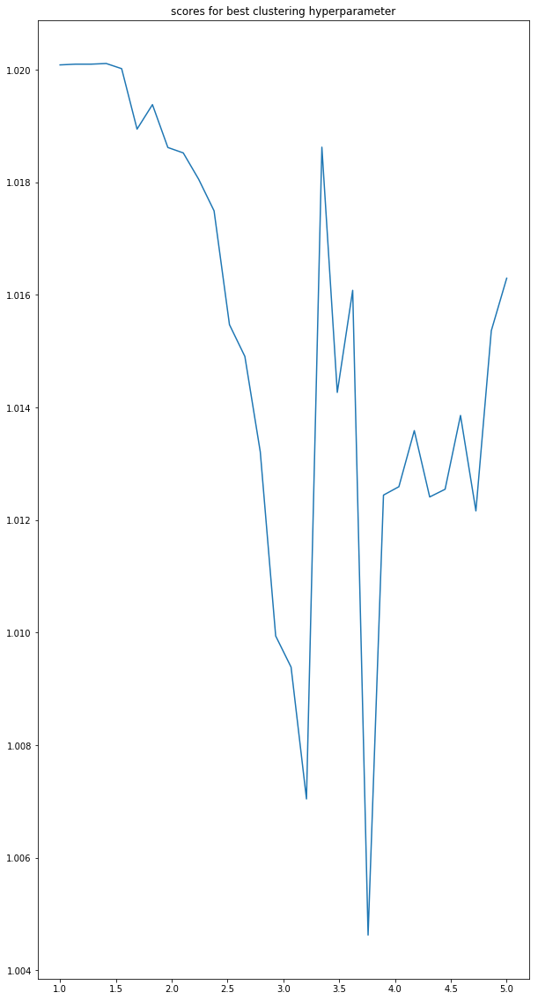

 the best value is : 3.75862068966
YOL013W-A
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YBL026W
Estimated number of clusters using DBscan: 1
silhouette_score 0.22732430872
cal_hara 54.3405881108
avg phylo dist of the clusters: [ 0.9720562  1.0028734]
-----------------------------
YEL059C-A
Estimated number of clusters using DBscan: 1
silhouette_score 0.146569722013
cal_hara 3.12466520932
avg phylo dist of the clusters: [ 1.44444444  0.78306878]
-----------------------------
YGR181W
Estimated number of clusters using DBscan: 3
silhouette_score 0.162041630122
cal_hara 35.2332697744
avg phylo dist of the clusters: [ 1.00765877  0.98034719  0.95828573  0.70730614]
-----------------------------
YDL053C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YDR513W
Estimated number of clusters using DBscan: 2
silhouette_score

silhouette_score 0.0547303798492
cal_hara 51.6874298137
avg phylo dist of the clusters: [ 0.98675696  1.00229174  0.65083879  0.96728561  0.54670458]
-----------------------------
YDL081C
Estimated number of clusters using DBscan: 4
silhouette_score -0.199094480758
cal_hara 9.5721588617
avg phylo dist of the clusters: [ 0.97930828  1.00337433  0.34250291  0.68500581]
-----------------------------
YHL048W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YEL030C-A
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YIL141W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YDR149C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YNL133C
Estimated number of clusters using DBscan: 1
silhouette_score 

avg phylo dist of the clusters: [ 1.1097561]
-----------------------------
YOR234C
Estimated number of clusters using DBscan: 5
silhouette_score -0.0794902606543
cal_hara 21.8408405476
avg phylo dist of the clusters: [ 0.98668163  0.94356049  0.37470733  0.47484463  0.35613348  0.86053301]
-----------------------------
YPL056C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YHR199C-A
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YLR374C
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YPR203W
Estimated number of clusters using DBscan: 1
silhouette_score 0.560824720113
cal_hara 31.7910534677
not enough species
-----------------------------
YDR045C
Estimated number of clusters using DBscan: 1
silhouette_score 0.256084730207
cal_hara 95.9226563992
avg phylo dist o

avg phylo dist of the clusters: [ 1.]
-----------------------------
YCL035C
Estimated number of clusters using DBscan: 2
silhouette_score 0.022280519745
cal_hara 22.1424527703
avg phylo dist of the clusters: [ 0.99841952  1.00481211  1.65400959]
-----------------------------
YJL161W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YKL023C-A
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YOR015W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YBR210W
Estimated number of clusters using DBscan: 2
silhouette_score 0.0530557594572
cal_hara 49.8545237812
avg phylo dist of the clusters: [ 0.96907523  1.0213948   0.87574732]
-----------------------------
YLL044W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough spec

avg phylo dist of the clusters: [ 0.97605152  1.01207995  0.17124333]
-----------------------------
YPL143W
Estimated number of clusters using DBscan: 6
silhouette_score -0.0919995092816
cal_hara 20.1430171733
avg phylo dist of the clusters: [ 0.98534448  0.94394371  0.37485951  0.47503749  0.35627811  0.8608825
  1.10276559]
-----------------------------
YKL096C-B
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YEL039C
Estimated number of clusters using DBscan: 4
silhouette_score -0.0476659779413
cal_hara 27.7176862425
avg phylo dist of the clusters: [ 0.98200717  0.82824184  1.01898513  1.07884747]
-----------------------------
YOR302W
Estimated number of clusters using DBscan: 1
silhouette_score 0
cal_hara 0
avg phylo dist of the clusters: [ 1.]
-----------------------------
YDR357C
Estimated number of clusters using DBscan: 1
silhouette_score 0.173916830329
cal_hara 3.73950802087
avg phylo dist of the clust

silhouette_score 0.321591369722
cal_hara 41.22704758
avg phylo dist of the clusters: [ 0.91609888  1.00780307]
-----------------------------
YDL181W
Estimated number of clusters using DBscan: 2
silhouette_score 0.127147504263
cal_hara 37.5995993283
avg phylo dist of the clusters: [ 0.99193141  0.9310699   1.18550422]
-----------------------------
YBL059C-A
Estimated number of clusters using DBscan: 1
silhouette_score 0.213838163414
cal_hara 14.7907835442
avg phylo dist of the clusters: [ 0.98321723  1.0259658 ]
-----------------------------
YER180C-A
Estimated number of clusters using DBscan: 1
silhouette_score 0.178946445562
cal_hara 1.83357901308
avg phylo dist of the clusters: [ 0.83333333]
-----------------------------
YGL149W
Estimated number of clusters using DBscan: 0
silhouette_score 0
cal_hara 0
not enough species
-----------------------------
YLR154W-A
Estimated number of clusters using DBscan: 1
silhouette_score 0.650922521451
cal_hara 14.808361824
avg phylo dist of the clus

In [175]:
cub.get_subset(homoset = cub.all_homoset, withcopy=True, clusternb=None, species=None,
               homologies=cub.all_homoset.homo_namelist[-300:]).find_clusters(clustering='dbscan',
                    trainingset=50, epoch=30, ranges=[1, 5], size=10, redo = True,
                    homogroupnb=2, best_eps = True, assess= True, eps=0.45)

In [235]:
cub.get_full_genomes(kingdom='fungi', seq='cds', avg=True, by="entropy", normalized=False)

parsed 14 over 66  done colletotrichum_higginsianum
parsed 15 over 66done _candida_tenuis_atcc_10573
done acremonium_chrysogenum_atcc_11550
done arthrobotrys_oligospora_atcc_24927
done arthroderma_otae_cbs_113480
done aspergillus_niger_atcc_1015
done aspergillus_ruber_cbs_135680
done aureobasidium_melanogenum_cbs_110374
done aureobasidium_namibiae_cbs_147_97
done aureobasidium_pullulans_exf_150
done aureobasidium_subglaciale_exf_2481
done baudoinia_panamericana_uamh_10762
done bipolaris_maydis_c5
done bipolaris_oryzae_atcc_44560
done bipolaris_sorokiniana_nd90pr
done bipolaris_victoriae_fi3
done bipolaris_zeicola_26_r_13
done blastomyces_dermatitidis_er_3
done blastomyces_gilchristii_slh14081
done brettanomyces_bruxellensis_awri1499
done byssochlamys_spectabilis_no_5
done candida_dubliniensis_cd36
done candida_maltosa_xu316
done candida_orthopsilosis_co_90_125
done candida_tropicalis_mya_3404
done capronia_coronata_cbs_617_96
done capronia_epimyces_cbs_606_96
done chaetomium_globosum_c

done hanseniaspora_valbyensis_nrrl_y_1626
done hyphopichia_burtonii_nrrl_y_1933
done isaria_fumosorosea_arsef_2679
done kluyveromyces_marxianus_dmku3_1042
done komagataella_phaffii_gs115
done lachancea_dasiensis_cbs_10888
done lachancea_fermentati
done lachancea_meyersii_cbs_8951
done lachancea_mirantina
done lachancea_nothofagi_cbs_11611
done lachancea_sp_cbs_6924
done lipomyces_starkeyi_nrrl_y_11557
done madurella_mycetomatis
done metarhizium_rileyi_rcef_4871
done metschnikowia_bicuspidata_var_bicuspidata_nrrl_yb_4993
done microdochium_bolleyi
done mycosphaerella_eumusae
done nadsonia_fulvescens_var_elongata_dsm_6958
done neolecta_irregularis_dah_3
done neonectria_ditissima
done ogataea_polymorpha
done ophiocordyceps_unilateralis
done pachysolen_tannophilus_nrrl_y_2460
done paraphaeosphaeria_sporulosa
done penicilliopsis_zonata_cbs_506_65
done penicillium_antarcticum
done penicillium_arizonense
done penicillium_chrysogenum
done penicillium_coprophilum
done penicillium_decumbens
done 

parsed 39 over 66 done magnaporthe_poae
parsed 40 over 66 done melampsora_laricipopulina
parsed 41 over 66 done microbotryum_violaceum
parsed 42 over 66 done neosartorya_fischeri
parsed 43 over 66 done neurospora_crassa
parsed 44 over 66 done phaeosphaeria_nodorum
parsed 45 over 66 done puccinia_graminis
parsed 47 over 66  done puccinia_striiformis
parsed 48 over 66 done puccinia_triticina
parsed 49 over 66 done pyrenophora_teres
parsed 50 over 66 done pyrenophora_triticirepentis
parsed 52 over 66  done schizosaccharomyces_cryophilus
parsed 53 over 66 done schizosaccharomyces_japonicus
parsed 54 over 66 done schizosaccharomyces_octosporus
parsed 55 over 66 done schizosaccharomyces_pombe
parsed 56 over 66 done sclerotinia_sclerotiorum
parsed 57 over 66 done sporisorium_reilianum
parsed 58 over 66 done trichoderma_reesei
parsed 59 over 66 done trichoderma_virens
parsed 60 over 66 done tuber_melanosporum
parsed 61 over 66 done ustilago_maydis
parsed 62 over 66 done verticillium_dahliae
pa

In [236]:
print cub.species['aspergillus_clavatus'].fullentropy

[  4.81145747   5.66657403   1.2040725    0.83806327   0.5266258
   1.80600925   1.96544775   4.40945129   0.72709161   6.36164414
  11.13865096   2.78300483   1.90841912   3.10838537   4.91127173
   3.74596275   0.8974923    5.71605129]


In [180]:
len(cub.all_homoset)

5807

In [ ]:
cub.save("full_ent_final")

writing in full_ent_final


We can very much see by the shape that mostly one direction is present where all homology go. Moreover, the highest homology species, have de facto the highest variance

*amongst the things that do not work: distance to tRNA UB, full/mean GC diff, tRNA number, phylodistance*

In [304]:
cub.compare_species(showvar=True, reducer='tsne', 
                    perplexity=100, eps=9, size=5,varmult=1.5,to="avg")

we have 284 species with sufficient statistics in their tRNA values
no phylo distances


PyCUB/pyCUB.py:1202: RuntimeWarning: divide by zero encountered in log
  utils.rgb2hex((126, 8, 10 + np.floor(246 * dist / tRNAentropydist.max()))) for dist in np.log(np.ma.masked_equal(tRNAentropydist, 0))]
PyCUB/pyCUB.py:1208: RuntimeWarning: divide by zero encountered in log
  tRNA_number=np.log(tRNA_number),
PyCUB/pyCUB.py:1210: RuntimeWarning: divide by zero encountered in log
  tRNAentropydist=np.log(np.ma.masked_equal(tRNAentropydist, 0) * 1000),


Loading BokehJS ...

In [258]:
cub

In [307]:
cub.regress_on_species(without=["tot_homologies","isbrown_rot","iswhite_rot",'average_size'], full=False, onlyhomo=False, 
                       perctrain=0.8, algo="nn",
                           eps=0.001, n_alphas=100)

num_genes: SpearmanrResult(correlation=-0.20392120936213901, pvalue=2.635831327646218e-06)
genome_size: SpearmanrResult(correlation=-0.14812823660067045, pvalue=0.00068636971631414411)
fullGCcount: SpearmanrResult(correlation=0.26672770045972816, pvalue=5.9432859937195404e-10)
varGCcount: SpearmanrResult(correlation=0.18647347951225177, pvalue=1.8039311033672066e-05)
Iteration 1, loss = 3.65733951
Iteration 2, loss = 3.55836255
Iteration 3, loss = 3.46189238
Iteration 4, loss = 3.36725503
Iteration 5, loss = 3.27696454
Iteration 6, loss = 3.18668378
Iteration 7, loss = 3.09822023
Iteration 8, loss = 3.01402537
Iteration 9, loss = 2.92965443
Iteration 10, loss = 2.84999468
Iteration 11, loss = 2.76961960
Iteration 12, loss = 2.69205057
Iteration 13, loss = 2.61657845
Iteration 14, loss = 2.54428455
Iteration 15, loss = 2.47409789
Iteration 16, loss = 2.40840087
Iteration 17, loss = 2.34208377
Iteration 18, loss = 2.27808855
Iteration 19, loss = 2.21671122
Iteration 20, loss = 2.15633707

(0.045003629107158605,
 [array([[ 0.53726457,  0.43528153,  0.0553647 , -0.50258885, -0.05305076,
          -0.42442989, -0.65596079,  0.29089596,  0.10212633],
         [ 0.42948625, -0.2352006 , -0.06296079, -0.62344046,  1.06654411,
          -0.16649315, -0.3657811 , -0.36714311,  0.31582497],
         [-0.24657331,  0.42943921,  0.44014434, -0.01550469, -0.18987075,
           0.51888507,  0.6078933 ,  0.45372785, -0.04169983],
         [-0.19727179, -0.1245377 ,  0.4241689 ,  0.26535889,  0.26148974,
          -0.51484577, -0.38426438, -0.0015139 ,  0.52474315],
         [ 0.551041  , -0.06738654, -0.16900025, -0.01753289, -0.0801559 ,
           0.31576118, -0.40438384, -0.25729203, -0.3463198 ],
         [ 0.03573382,  0.05756626, -0.0047879 ,  0.03309567, -0.31112513,
           0.38244923, -0.32039441, -0.03159162,  0.47367045],
         [ 0.03922844, -0.09163602,  0.34916225,  0.02853151,  0.08432839,
           0.29522027, -0.03576938, -0.26701783,  0.25610641]]),
  array([

In [209]:
cub.compute_ages(homoset=cub.all_homoset,minpreserv=0.9,minsimi=0.9,redo=True)

Wow, it seems that all highly conserved homologies are mostly present on one part of the plot and the other and highly preserved ones on the other part. this plot possess a really high amount of information. It seems they both come from the same place when they have a low entropy but the higher the entropy the higher the divergence in how this high entropy is represented. which mean that the entropy distribution amongst the more highly conserved genes and the more recent ones is very different.

the similarity score also shows some interesting pattern. there really seems to be some entropy related with the GC content and some other with how recent is the gene (i.e. other factors) and other with the length

There again seems to be cluster of secreted proteins and a relation of cys reg elements to lengthy/ high variance/ high entropy homologies

the hydrophobicity also seems to predict some information about the relative position and thus entropy values !

Evolutionary CAI also seems to be highly predictive of this shape. we can see that low entropy homologies and high entropy/high variance/conserved homologies are at the opposite of the spectrum with a degraded between the two (which is not the case of the similarity values)

Finally, plotting against the working homoset, really allows us to see what is removed: the recent homologies, and some others, it changes the distribution and thus the tSNE structure. we can see the relation with the eCAI and theslow variation of it with two distinct clusters

Genes appearing recently have a high CAI ( even more than eCAI) compared to the highly preserved ones, GC content is also highly predictive of it.
We can better see, there that the high mRNA abundance gene seems to be also only clustered on one part of the plot. So are the high similarity homologies


*we really required both entropy and a value, each allowed me to show and discover different relationships*

*we basically used homology to understand a notion of gene ages etc..*

In [315]:
cub.compare_homologies(homoset=cub.all_homoset, homosapiens=False, mindistance=10,
                           preserved=True, size=3, varsize=0.8, reducer='pca', perplexity=40,
                           minpreserv=0.9, minsimi=0.9, showvar=True, eps=6)

> /home/ec2-user/PyCUB/CodonUsageBias/PyCUB/pyCUB.py(1402)compare_homologies()
-> averagehomo_matrix = np.zeros((len(homoset), utils.CUBD))
(Pdb) c


Loading BokehJS ...

In [314]:
cub.all_homoset[2736].homocode

'YKL179C'

In [319]:
cub.all_homoset.fulleng.sum(1).mean()

484.29120027552955

Here the future seems also grim for the algorithm, however some hope exists, we have found that the lasso was finally not that the interaction may not be linear and may be important amongst the variable as the score of the MLP was consistently better that the one of the lasso and that varying the available parameters was, for some set of paramters, increasing the R^2 score. we may perform a better regression by carefully choosing the set of parameters to give to the lasso

In [291]:
cub.regress_on_genes(homoset=cub.all_homoset, full=False, 
                     without=["conservation","similarity_scores",
                    "mRNA_abundance","protein_abundance","is_secreted",
                    "cys_elements","decay_rate",'meancai'],
                     perctrain=0.85, algo="lasso", eps=0.01, n_alphas=100)

> /home/ec2-user/PyCUB/CodonUsageBias/PyCUB/pyCUB.py(1508)regress_on_genes()
-> for val in values[:5]:
(Pdb) c
nans: SpearmanrResult(correlation=-0.3555959460371706, pvalue=1.1441764655930061e-172)
lenmat: SpearmanrResult(correlation=0.80583957969973008, pvalue=0.0)
GCcount: SpearmanrResult(correlation=0.22619613607892744, pvalue=2.8877807326984728e-68)
weight: SpearmanrResult(correlation=0.72817624858641561, pvalue=0.0)
tot_volume: SpearmanrResult(correlation=0.77385917280841998, pvalue=0.0)
mean_hydrophobicity: SpearmanrResult(correlation=0.11672375791852342, pvalue=4.5226765754239889e-19)
glucose_cost: SpearmanrResult(correlation=0.77214059050694916, pvalue=0.0)
synthesis_steps: SpearmanrResult(correlation=0.77459143311298995, pvalue=0.0)
isoelectricpoint: SpearmanrResult(correlation=-0.026971626011661889, pvalue=0.039853086935354678)
meanecai: SpearmanrResult(correlation=-0.3734691190980633, pvalue=1.2365551211497936e-191)
change
the R^2 score is of: -700.022703546
----------------

(-700.02270354605298,
 [6.030731902593822,
  108.62820556222758,
  14.763048769558138,
  -23.82901592588136,
  29.87798173806435,
  16.520443755933385,
  0.0,
  0.0,
  -17.0861620321354,
  -21.256693464290425],
 ['nans',
  'lenmat',
  'GCcount',
  'weight',
  'tot_volume',
  'mean_hydrophobicity',
  'glucose_cost',
  'synthesis_steps',
  'isoelectricpoint',
  'meanecai'])